<a href="https://colab.research.google.com/github/madhavrao2510/Cedit-Risk_XAI/blob/main/GermanBak_Data_Risk_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Credit Risk Modeling - credit risk using customer profile (with XAI)
Dataset : German credit data with risk

AIM : perform credit risk analysis of Loan application with basic customer profile

This Jupyter notebook is divided into 2 parts A. Traditional way of building a Machine Learning pipeline (Based on CRISPDM - understanding business & data, data cleansing, model building & evaluation, deployment) B. Building an ML pipeline with the help of various tools and techniques of XAI for explainability and its evaluation. (please skip to second section (Go to Section Model evaluation using MLI,XAI) if only interested in XAI)

In [1]:
! pip3 install xai --upgrade
! pip3 install scikit-learn --upgrade

Requirement already up-to-date: xai in /usr/local/lib/python3.6/dist-packages (0.0.5)
  Using cached https://files.pythonhosted.org/packages/10/26/d04320c3edf2d59b1fcd0720b46753d4d603a76e68d8ad10a9b92ab06db2/scikit_learn-0.20.1-cp36-cp36m-manylinux1_x86_64.whl
ERROR: umap-learn 0.4.6 has requirement numpy>=1.17, but you'll have numpy 1.15.4 which is incompatible.
ERROR: umap-learn 0.4.6 has requirement scipy>=1.3.1, but you'll have scipy 1.1.0 which is incompatible.
  Found existing installation: scikit-learn 0.24.0
    Uninstalling scikit-learn-0.24.0:
      Successfully uninstalled scikit-learn-0.24.0
  Using cached https://files.pythonhosted.org/packages/30/aa/db462d385c56905b731403885454188683f63c86ea68900f6f7e7558b5fa/scikit_learn-0.24.0-cp36-cp36m-manylinux2010_x86_64.whl
ERROR: xai 0.0.5 has requirement scikit-learn==0.20.1, but you'll have scikit-learn 0.24.0 which is incompatible.
ERROR: umap-learn 0.4.6 has requirement numpy>=1.17, but you'll have numpy 1.15.4 which is incomp

In [2]:
import sys, os
import numpy as np 
import pandas as pd 
import seaborn as sns
import plotly.express as exp
import plotly.graph_objs as go 
import plotly.tools as tls
import plotly.offline as py 
import xai
import warnings
warnings.filterwarnings('ignore')
from collections import Counter
from matplotlib import pyplot as plt
%matplotlib inline
py.init_notebook_mode(connected=True)

======== Credit risk modelling with traditional ML ========
Exploratory data analytics¶

In [3]:
df = pd.read_csv("/content/drive/MyDrive/Dissertation work/Data/SouthGermanCredit.csv")
df.reset_index(drop=True, inplace=True)
df.head()

,checking_account,duration,credit_history,purpose,amount,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,age,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,credit_risk
0,no checking account,18,all credits at this bank paid back duly,car (used),1049,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,21,none,for free,1,skilled employee/official,0 to 2,no,no,good
1,no checking account,9,all credits at this bank paid back duly,others,2799,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,36,none,for free,2-3,skilled employee/official,3 or more,no,no,good
2,... < 0 DM,12,no credits taken/all credits paid back duly,retraining,841,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,23,none,for free,1,unskilled - resident,0 to 2,no,no,good
3,no checking account,12,all credits at this bank paid back duly,others,2122,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,39,none,for free,2-3,unskilled - resident,3 or more,no,yes,good
4,no checking account,12,all credits at this bank paid back duly,others,2171,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,38,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,good


In [4]:
df.isna().sum()

checking_account           0
duration                   0
credit_history             0
purpose                    0
amount                     0
savings_account            0
employment_duration        0
installment_rate           0
personal_status_sex        0
other_debtors              0
present_residence          0
property                   0
age                        0
other_installment_plans    0
housing                    0
number_credits             0
job                        0
people_liable              0
telephone                  0
foreign_worker             0
credit_risk                0
dtype: int64

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
checking_account           1000 non-null object
duration                   1000 non-null int64
credit_history             1000 non-null object
purpose                    1000 non-null object
amount                     1000 non-null int64
savings_account            1000 non-null object
employment_duration        1000 non-null object
installment_rate           1000 non-null object
personal_status_sex        1000 non-null object
other_debtors              1000 non-null object
present_residence          1000 non-null object
property                   1000 non-null object
age                        1000 non-null int64
other_installment_plans    1000 non-null object
housing                    1000 non-null object
number_credits             1000 non-null object
job                        1000 non-null object
people_liable              1000 non-null object
telephone                  1000 n

In [6]:
#categorical_cols = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker']

In [7]:
categorical_cols = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker']
ordinal_cols = ['duration','amount','age']
label = 'credit_risk'
print('Total columns considered {0}, Actual columns {1}'.format(len(categorical_cols+ordinal_cols+[label]),21))
df = df.reindex(columns=categorical_cols+ordinal_cols+[label])
df[categorical_cols+[label]] = df[categorical_cols+[label]].astype('category')
df.info()

Total columns considered 21, Actual columns 21
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null catego

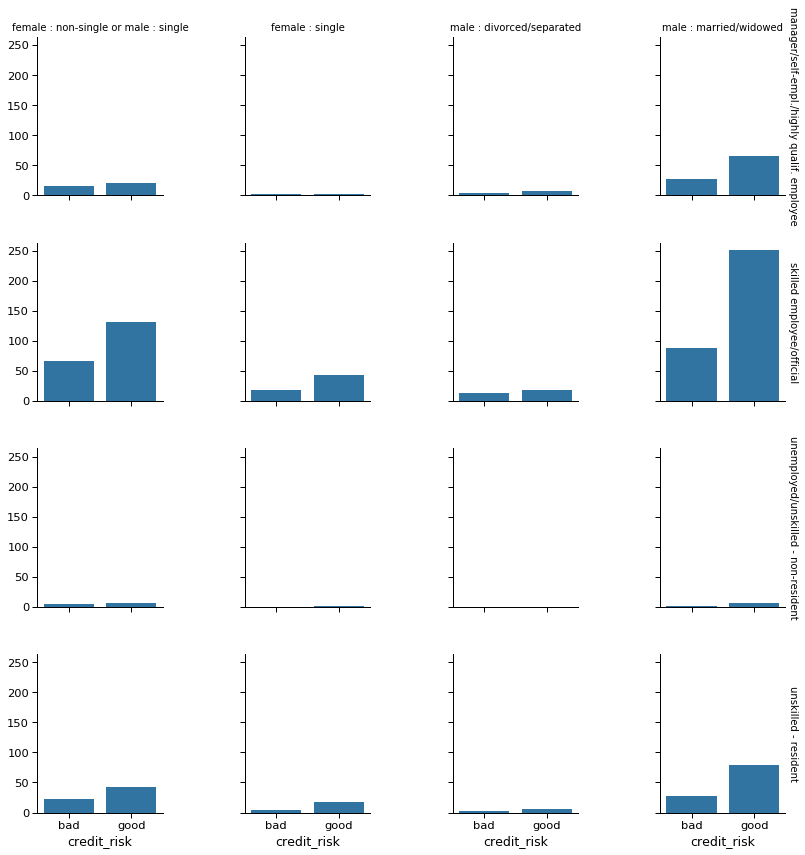

In [8]:
with sns.plotting_context('paper', font_scale = 1.3):
    g = sns.FacetGrid(data = df,
                      col = 'personal_status_sex',
                      row = 'job',
                      margin_titles=True)
g = g.map(sns.countplot, "credit_risk")
[plt.setp(ax.texts, text="") for ax in g.axes.flat] # remove the original texts
                                                    # important to add this before setting titles
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')

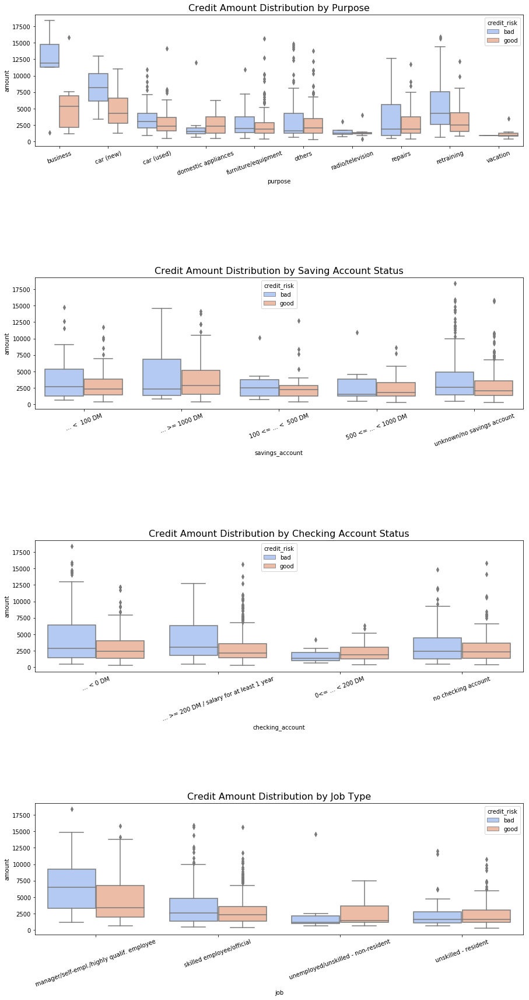

In [9]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4,1, figsize=(15,25))

sns.boxplot(x="purpose", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax1)
sns.boxplot(x="savings_account", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax2)
sns.boxplot(x="checking_account", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax3)
sns.boxplot(x="job", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax4)

ax1.set_title("Credit Amount Distribution by Purpose", fontsize=16)
ax2.set_title("Credit Amount Distribution by Saving Account Status", fontsize=16)
ax3.set_title("Credit Amount Distribution by Checking Account Status", fontsize=16)
ax4.set_title("Credit Amount Distribution by Job Type", fontsize=16)

ax1.set_xticklabels(ax1.get_xticklabels(), rotation=20)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=20)
ax3.set_xticklabels(ax3.get_xticklabels(), rotation=20)
ax4.set_xticklabels(ax4.get_xticklabels(), rotation=20)

plt.subplots_adjust(hspace = 1, top = 1)
plt.show()

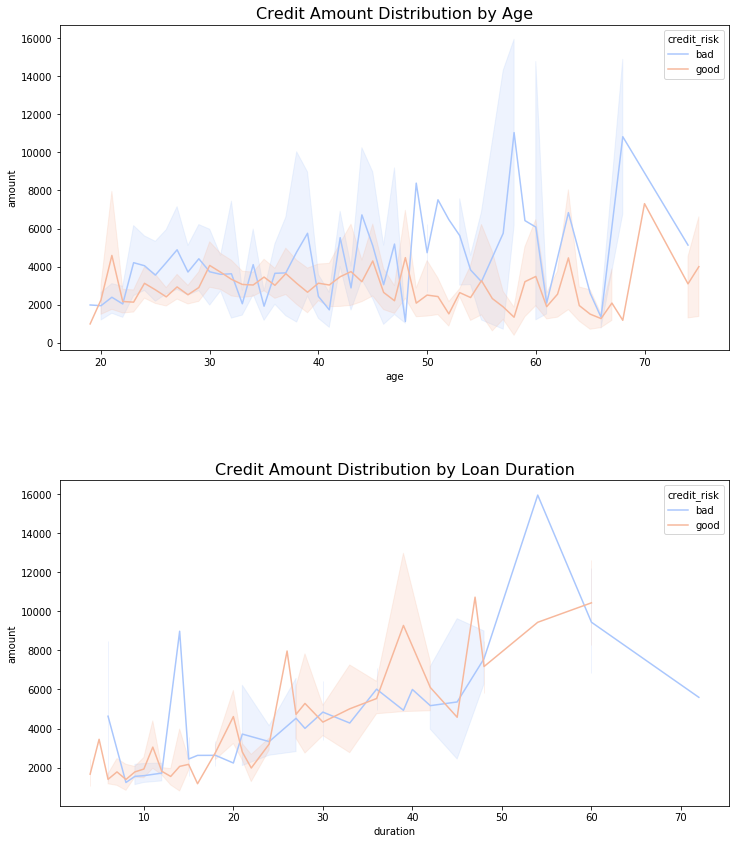

In [10]:
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(12,14))

sns.lineplot(x="age", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax1)
sns.lineplot(x="duration", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax2)

ax1.set_title("Credit Amount Distribution by Age", fontsize=16)
ax2.set_title("Credit Amount Distribution by Loan Duration", fontsize=16)

plt.subplots_adjust(wspace = 0.4, hspace = 0.4,top = 0.9)
plt.show()

In [11]:
df.head(5)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good


In [12]:
df1 = df.copy(deep=True)
df1.head(5)


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good


In [13]:
# getting dummies for all the categorical variables

dummies_columns = categorical_cols
for col in dummies_columns:
    df1 = df1.merge(pd.get_dummies(df1[col], drop_first=True, prefix=str(col)), left_index=True, right_index=True) 


# encoding risk as binary
r = {"good":0, "bad": 1}
df1[label] = df1[label].map(r)

df1.drop(columns=dummies_columns,inplace=True)

df1.head(10)

,duration,amount,age,credit_risk,checking_account_... >= 200 DM / salary for at least 1 year,checking_account_0<= ... < 200 DM,checking_account_no checking account,credit_history_critical account/other credits elsewhere,credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,credit_history_no credits taken/all credits paid back duly,purpose_car (new),purpose_car (used),purpose_domestic appliances,purpose_furniture/equipment,purpose_others,purpose_radio/television,purpose_repairs,purpose_retraining,purpose_vacation,savings_account_... >= 1000 DM,savings_account_100 <= ... < 500 DM,savings_account_500 <= ... < 1000 DM,savings_account_unknown/no savings account,employment_duration_4 <= ... < 7 yrs,employment_duration_< 1 yr,employment_duration_>= 7 yrs,employment_duration_unemployed,installment_rate_25 <= ... < 35,installment_rate_< 20,installment_rate_>= 35,personal_status_sex_female : single,personal_status_sex_male : divorced/separated,personal_status_sex_male : married/widowed,other_debtors_guarantor,other_debtors_none,present_residence_4 <= ... < 7 yrs,present_residence_< 1 yr,present_residence_>= 7 yrs,property_car or other,property_real estate,property_unknown / no property,other_installment_plans_none,other_installment_plans_stores,housing_own,housing_rent,number_credits_2-3,number_credits_4-5,number_credits_>= 6,job_skilled employee/official,job_unemployed/unskilled - non-resident,job_unskilled - resident,people_liable_3 or more,telephone_yes (under customer name),foreign_worker_yes
0,18,1049,21,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0
1,9,2799,36,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,1,0,0,1,0,0
2,12,841,23,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0
3,12,2122,39,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,1,1,0,1
4,12,2171,38,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,1,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1
5,10,2241,48,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,1,0,1,1,0,0,0,0,1,1,0,0,0,1,0,0,0,0,1,1,0,1
6,8,3398,39,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,1,1,0,0,1,1,0,0,0,0,1,0,0,1
7,6,1361,40,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,1,0,1,0,0,1,0,0,1,1,0,0,1,0,0,0,0,0,1,1,0,1
8,18,1098,65,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,1,0,0,0,1,0,0,0,0
9,24,3758,23,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0


ModuleNotFoundError: ignored

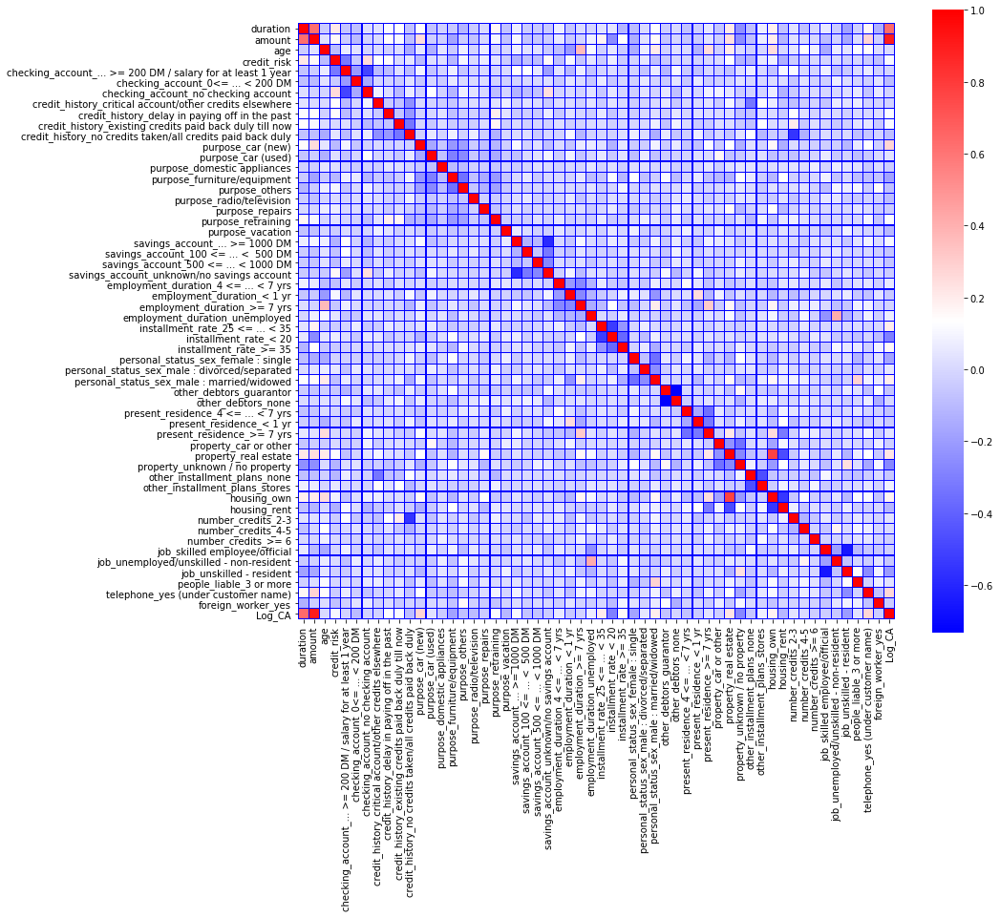

In [14]:
df1['Log_CA'] = np.log(df1['amount'])
plt.figure(figsize=(14,12))
sns.heatmap(df1.astype(float).corr(),linewidths=0.1,vmax=1.0, 
            square=True,  linecolor='blue', cmap='bwr')
plt.show()

In [15]:
interval = (18, 25, 35, 60, 120)

cats = ['Student', 'Young', 'Adult', 'Senior']
df["Age_cat"] = pd.cut(df.age, interval, labels=cats)

df_good = df[df[label] == 'good']
df_bad = df[df[label] == 'bad']

trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["checking_account"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['checking_account'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan amount(German - DM)'
    ),
     xaxis=dict(
        title='Checking Account'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-checking_account-cat')


In [16]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["savings_account"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['savings_account'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Savings Account'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-savings_account-cat')

In [17]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["Age_cat"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['Age_cat'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Age Category'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

In [18]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["personal_status_sex"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['personal_status_sex'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Marital status and gender'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-personal_status_sex-cat')

In [19]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["present_residence"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['present_residence'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Present Residence'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-present_residence-cat')


In [20]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["people_liable"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['people_liable'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='No of Dependents'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-people_liable-cat')


Total values of the most missing variable: 
checking_account
... < 0 DM                                    269
... >= 200 DM / salary for at least 1 year    394
0<= ... < 200 DM                               63
no checking account                           274
Name: checking_account, dtype: int64


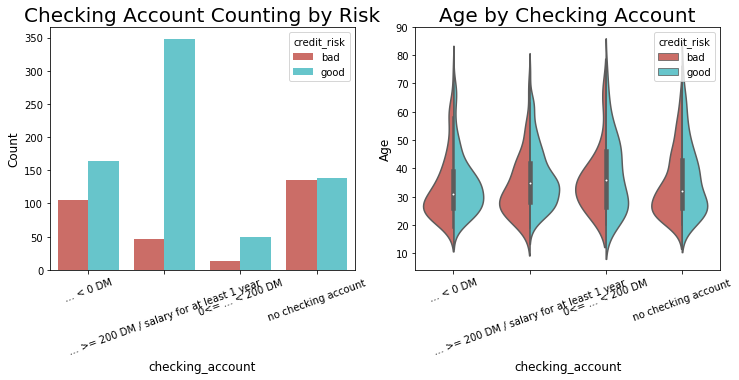

In [21]:
print("Total values of the most missing variable: ")
print(df.groupby("checking_account")["checking_account"].count())

plt.figure(figsize = (12,10))

g = plt.subplot(221)
g = sns.countplot(x="checking_account", data=df, 
              palette="hls", hue="credit_risk")
g.set_xlabel("checking_account", fontsize=12)
g.set_ylabel("Count", fontsize=12)
g.set_title("Checking Account Counting by Risk", fontsize=20)
g.set_xticklabels(g.get_xticklabels(), rotation=20)

g1 = plt.subplot(222)
g1 = sns.violinplot(x="checking_account", y="age", data=df, palette="hls", hue = "credit_risk",split=True)
g1.set_xlabel("checking_account", fontsize=12)
g1.set_ylabel("Age", fontsize=12)
g1.set_title("Age by Checking Account", fontsize=20)

plt.subplots_adjust(wspace = 0.2, hspace = 0.3, top = 0.9)
g1.set_xticklabels(g1.get_xticklabels(), rotation=20)

plt.show()


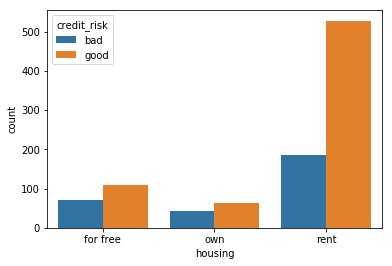

In [22]:
sns.countplot(x="housing", hue="credit_risk", data=df)
plt.show()

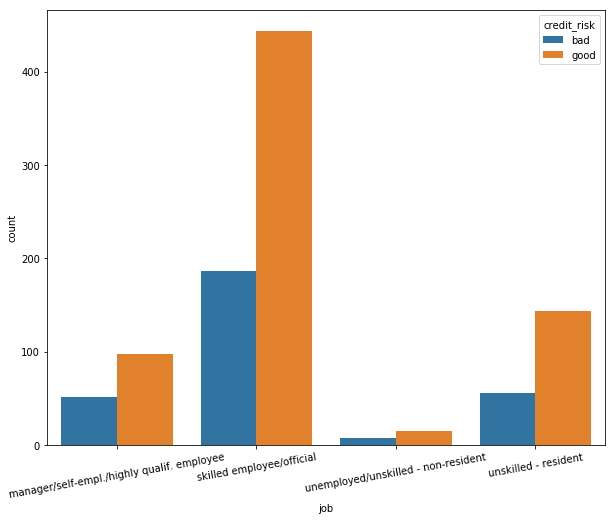

In [23]:
fig, ax1 = plt.subplots(1,1, figsize=(10,8))
sns.countplot(x="job", hue="credit_risk", data=df, ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=10)
plt.show()

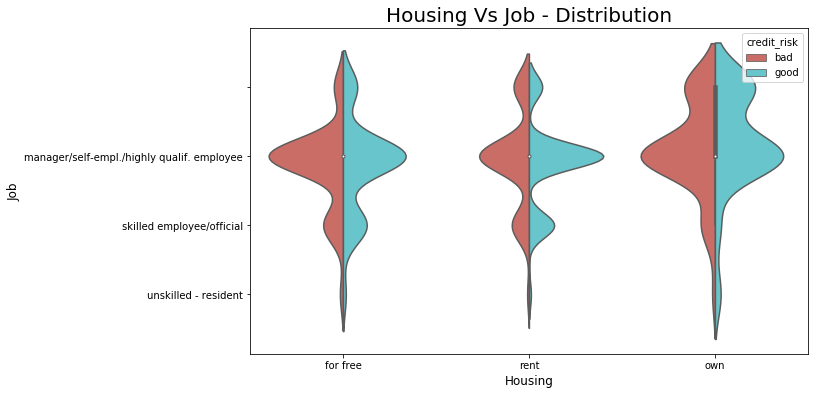

In [24]:
# encoding job as levels
r = {"unemployed/unskilled - non-resident":0, "unskilled - resident":1, "skilled employee/official": 2, "manager/self-empl./highly qualif. employee": 3}

df['Job_lvl'] = df['job'].map(r)
df['Job_lvl'] = df['Job_lvl'].fillna(0)

# encoding housing as levels
r = {"for free":0, "rent":1, "own": 2}

df['Housing_lvl'] = df['housing'].map(r)
df['Housing_lvl'] = df['Housing_lvl'].fillna(0)

plt.figure(figsize = (10,6))

g = sns.violinplot(x="Housing_lvl",y="Job_lvl",data=df,hue="credit_risk", palette="hls",split=True)
g.set_xlabel("Housing", fontsize=12)
g.set_ylabel("Job", fontsize=12)
g.set_title("Housing Vs Job - Distribution", fontsize=20)
g.set_xticklabels(["for free", "rent", "own"], rotation=0)
g.set_yticklabels(["unemployed/unskilled - non-resident", "unskilled - resident", "skilled employee/official", "manager/self-empl./highly qualif. employee"], rotation=0)

plt.show()

In [25]:

cm = sns.light_palette("blue", as_cmap=True)
pd.crosstab(df.personal_status_sex, df.job).style.background_gradient(cmap = cm)

job,manager/self-empl./highly qualif. employee,skilled employee/official,unemployed/unskilled - non-resident,unskilled - resident
personal_status_sex,,,,
female : non-single or male : single,37,197,12,64
female : single,6,62,2,22
male : divorced/separated,11,31,0,8
male : married/widowed,94,340,8,106


In [26]:
pd.crosstab(df.personal_status_sex, df.housing).style.background_gradient(cmap = cm)

housing,for free,own,rent
personal_status_sex,,,
female : non-single or male : single,95,19,196
female : single,23,1,68
male : divorced/separated,6,3,41
male : married/widowed,55,84,409


In [27]:
date_int = ["purpose", 'personal_status_sex']
cm = sns.light_palette("green", as_cmap=True)
pd.crosstab(df[date_int[0]], df[date_int[1]]).style.background_gradient(cmap = cm)

personal_status_sex,female : non-single or male : single,female : single,male : divorced/separated,male : married/widowed
purpose,,,,
business,3,0,1,8
car (new),24,6,3,70
car (used),74,7,15,85
domestic appliances,5,3,2,12
furniture/equipment,85,42,7,146
others,70,20,10,134
radio/television,6,1,1,4
repairs,21,1,1,27
retraining,19,9,10,59


In [28]:
pd.crosstab(df["checking_account"],df.personal_status_sex).style.background_gradient(cmap = cm)

personal_status_sex,female : non-single or male : single,female : single,male : divorced/separated,male : married/widowed
checking_account,,,,
... < 0 DM,86,34,14,135
... >= 200 DM / salary for at least 1 year,116,33,13,232
0<= ... < 200 DM,20,4,6,33
no checking account,88,21,17,148


In [29]:
df.head(5)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [30]:
print("Purpose : ",df.purpose.unique())
print("Personal status / Sex : ",df['personal_status_sex'].unique())
print("Housing : ",df.housing.unique())
print("Saving accounts : ",df['savings_account'].unique())
print("Risk : ",df['credit_risk'].unique())
print("Checking account : ",df['checking_account'].unique())
print("Aget_cat : ",df['Age_cat'].unique())
print("Job : ",df['job'].unique())
print("Property : ",df['property'].unique())
print("Debdtors : ",df['other_debtors'].unique())

#potential numeric fields
print('===========================')
print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())

Purpose :  [car (used), others, retraining, furniture/equipment, car (new), business, domestic appliances, radio/television, repairs, vacation]
Categories (10, object): [car (used), others, retraining, furniture/equipment, ...,
                          domestic appliances, radio/television, repairs, vacation]
Personal status / Sex :  [female : non-single or male : single, male : married/widowed, female : single, male : divorced/separated]
Categories (4, object): [female : non-single or male : single, male : married/widowed, female : single,
                         male : divorced/separated]
Housing :  [for free, rent, own]
Categories (3, object): [for free, rent, own]
Saving accounts :  [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]
Categories (5, object): [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM,
                         500 <= ... < 1000 DM]
Risk :  [good, bad]
Categories (2, object): [

[Text(0, 0, '0 to 2'), Text(0, 0, '3 or more')]

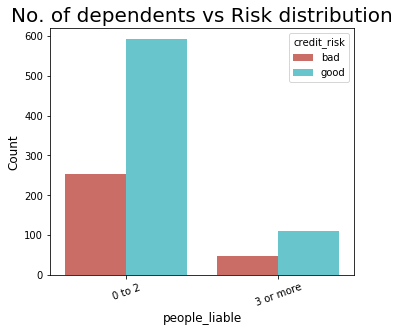

In [31]:
plt.figure(figsize = (12,10))

g = plt.subplot(221)
g = sns.countplot(x="people_liable", data=df, 
              palette="hls", hue="credit_risk")
g.set_xlabel("people_liable", fontsize=12)
g.set_ylabel("Count", fontsize=12)
g.set_title("No. of dependents vs Risk distribution", fontsize=20)
g.set_xticklabels(g.get_xticklabels(), rotation=20)

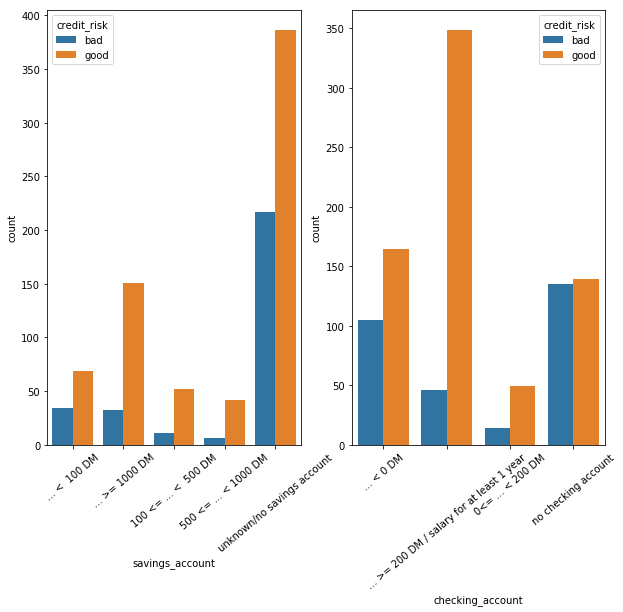

In [32]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,8))
sns.countplot(x="savings_account", hue="credit_risk", data=df, ax=ax1)
sns.countplot(x="checking_account", hue="credit_risk", data=df, ax=ax2)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=40)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=40)

fig.show()

In [33]:
df['savings_account'].unique()


[unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]
Categories (5, object): [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM,
                         500 <= ... < 1000 DM]

In [34]:
df['checking_account'].unique()

[no checking account, ... < 0 DM, ... >= 200 DM / salary for at least 1 year, 0<= ... < 200 DM]
Categories (4, object): [no checking account, ... < 0 DM, ... >= 200 DM / salary for at least 1 year,
                         0<= ... < 200 DM]

In [35]:
df_saved = df.copy(deep=True)

In [36]:
#df = df_saved.copy(deep=True)
df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [37]:
print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())


No of years resident :  [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
Categories (4, object): [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
No of Dependents :  [0 to 2, 3 or more]
Categories (2, object): [0 to 2, 3 or more]
Employment duration :  [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
Categories (5, object): [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
No of Credits:  [1, 2-3, 4-5, >= 6]
Categories (4, object): [1, 2-3, 4-5, >= 6]
Installmen rate :  [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]
Categories (4, object): [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]


In [38]:
# We shall convert savings_account adn checking_acco8unt fields to ordinal numerical fields

print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())

# encoding job as levels
r = {"500 <= ... < 1000 DM":0,"100 <= ... <  500 DM":1, "... >= 1000 DM":2, "... <  100 DM": 3, "unknown/no savings account": 4}
df['savings_account_lvl'] = df['savings_account'].map(r)

# encoding job as levels
r = {"... >= 200 DM / salary for at least 1 year":1,"0<= ... < 200 DM":2, "... < 0 DM":3, "no checking account": 4}
df['checking_account_lvl'] = df['checking_account'].map(r)

# encoding job as levels
r = {"< 20":1,"25 <= ... < 35":2, "20 <= ... < 25":3, ">= 35": 4}
df['installment_rate_value'] = df['installment_rate'].map(r)

# encoding job as levels
r = {"1":1,"2-3":2, "4-5":3, ">= 6": 4}
df['number_of_credits'] = df['number_credits'].map(r)

# encoding job as levels
r = {"0 to 2":0, "3 or more": 1}
df['No_people_liable'] = df['people_liable'].map(r)

# encoding job as levels
r = {"< 1 yr":1,"4 <= ... < 7 yrs":2, "1 <= ... < 4 yrs":3, ">= 7 yrs": 4}
df['present_residence_years'] = df['present_residence'].map(r)

# encoding job as levels
r = {"unemployed":0,"< 1 yr":1,"1 <= ... < 4 yrs":2, "4 <= ... < 7 yrs":3, ">= 7 yrs": 4}
df['employment_duration_years'] = df['employment_duration'].map(r)

del df['job']
del df['checking_account']
del df['savings_account']
del df['housing']
del df['installment_rate']
del df['number_credits']
del df['people_liable']
del df['present_residence']
del df['employment_duration']

No of years resident :  [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
Categories (4, object): [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
No of Dependents :  [0 to 2, 3 or more]
Categories (2, object): [0 to 2, 3 or more]
Employment duration :  [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
Categories (5, object): [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
No of Credits:  [1, 2-3, 4-5, >= 6]
Categories (4, object): [1, 2-3, 4-5, >= 6]
Installmen rate :  [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]
Categories (4, object): [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]


In [39]:
def one_hot_encoder(df, nan_as_category = False):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category, drop_first=True)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

In [40]:
def f_in(X, m=None):
    """Preprocess input so it can be provided to a function"""
    if m:
        return [X.iloc[:m,i] for i in range(X.shape[1])]
    else:
        return [X.iloc[:,i] for i in range(X.shape[1])]

In [41]:
df.head(5)

,credit_history,purpose,personal_status_sex,other_debtors,property,other_installment_plans,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,savings_account_lvl,checking_account_lvl,installment_rate_value,number_of_credits,No_people_liable,present_residence_years,employment_duration_years
0,all credits at this bank paid back duly,car (used),female : non-single or male : single,none,car or other,none,no,no,18,1049,21,good,Student,2,0,4,4,1,1,0,4,1
1,all credits at this bank paid back duly,others,male : married/widowed,none,unknown / no property,none,no,no,9,2799,36,good,Adult,2,0,4,4,2,2,1,3,2
2,no credits taken/all credits paid back duly,retraining,female : non-single or male : single,none,unknown / no property,none,no,no,12,841,23,good,Student,1,0,3,3,2,1,0,4,3
3,all credits at this bank paid back duly,others,male : married/widowed,none,unknown / no property,none,no,yes,12,2122,39,good,Adult,1,0,4,4,3,2,1,3,2
4,all credits at this bank paid back duly,others,male : married/widowed,none,car or other,bank,no,yes,12,2171,38,good,Adult,1,1,4,4,1,2,0,4,2


In [42]:
#df = df_saved.copy(deep=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 22 columns):
credit_history               1000 non-null category
purpose                      1000 non-null category
personal_status_sex          1000 non-null category
other_debtors                1000 non-null category
property                     1000 non-null category
other_installment_plans      1000 non-null category
telephone                    1000 non-null category
foreign_worker               1000 non-null category
duration                     1000 non-null int64
amount                       1000 non-null int64
age                          1000 non-null int64
credit_risk                  1000 non-null category
Age_cat                      1000 non-null category
Job_lvl                      1000 non-null int64
Housing_lvl                  1000 non-null int64
savings_account_lvl          1000 non-null int64
checking_account_lvl         1000 non-null int64
installment_rate_value       10

In [43]:
# encoding risk as binary
r = {"good":0, "bad": 1}
df[label] = df[label].map(r)

In [44]:
categorical_cols_dummies = categorical_cols.copy()
[categorical_cols_dummies.remove(cols) for cols in ['job','savings_account','checking_account','housing','installment_rate','number_credits','people_liable','present_residence','employment_duration']]
categorical_cols_dummies

['credit_history',
 'purpose',
 'personal_status_sex',
 'other_debtors',
 'property',
 'other_installment_plans',
 'telephone',
 'foreign_worker']

In [45]:
categorical_cols

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker']

In [46]:
df['savings_account_lvl'] = df['savings_account_lvl'].fillna('no_inf')
df['checking_account_lvl'] = df['checking_account_lvl'].fillna('no_inf')

for cols in categorical_cols_dummies:
    df = df.merge(pd.get_dummies(df[cols], drop_first=True, prefix=cols), left_index=True, right_index=True)
    
#Purpose to Dummies Variable
#df = df.merge(pd.get_dummies(df.Purpose, drop_first=True, prefix='purpose'), left_index=True, right_index=True)
#Sex feature in dummies
#df = df.merge(pd.get_dummies(df.Sex, drop_first=True, prefix='personal_status_sex'), left_index=True, right_index=True)
## Housing get dummies
#df = df.merge(pd.get_dummies(df.Housing, drop_first=True, prefix='housing'), left_index=True, right_index=True)
## Housing get Saving Accounts
#df = df.merge(pd.get_dummies(df["savings_account"], drop_first=True, prefix='savings_account'), left_index=True, right_index=True)
## Housing get Risk
#df = df.merge(pd.get_dummies(df.Risk, prefix='credit_risk'), left_index=True, right_index=True)
## Housing get Checking Account
#df = df.merge(pd.get_dummies(df["checking_account"], drop_first=True, prefix='checking_account'), left_index=True, right_index=True)
## Housing get Age categorical
#df = df.merge(pd.get_dummies(df["Age_cat"], drop_first=True, prefix='Age_cat'), left_index=True, right_index=True)
## Housing get Age categorical
#df = df.merge(pd.get_dummies(df["Age_cat"], drop_first=True, prefix='Age_cat'), left_index=True, right_index=True)


In [47]:
del df['credit_history']
del df['purpose'] 
del df['personal_status_sex']
del df['other_debtors']
del df['property']
del df['other_installment_plans']     
del df['telephone']     
del df['foreign_worker']
del df['Age_cat']

In [48]:
df.info(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 38 columns):
duration                                                      1000 non-null int64
amount                                                        1000 non-null int64
age                                                           1000 non-null int64
credit_risk                                                   1000 non-null int64
Job_lvl                                                       1000 non-null int64
Housing_lvl                                                   1000 non-null int64
savings_account_lvl                                           1000 non-null int64
checking_account_lvl                                          1000 non-null int64
installment_rate_value                                        1000 non-null int64
number_of_credits                                             1000 non-null int64
No_people_liable                                              1000 non-nul

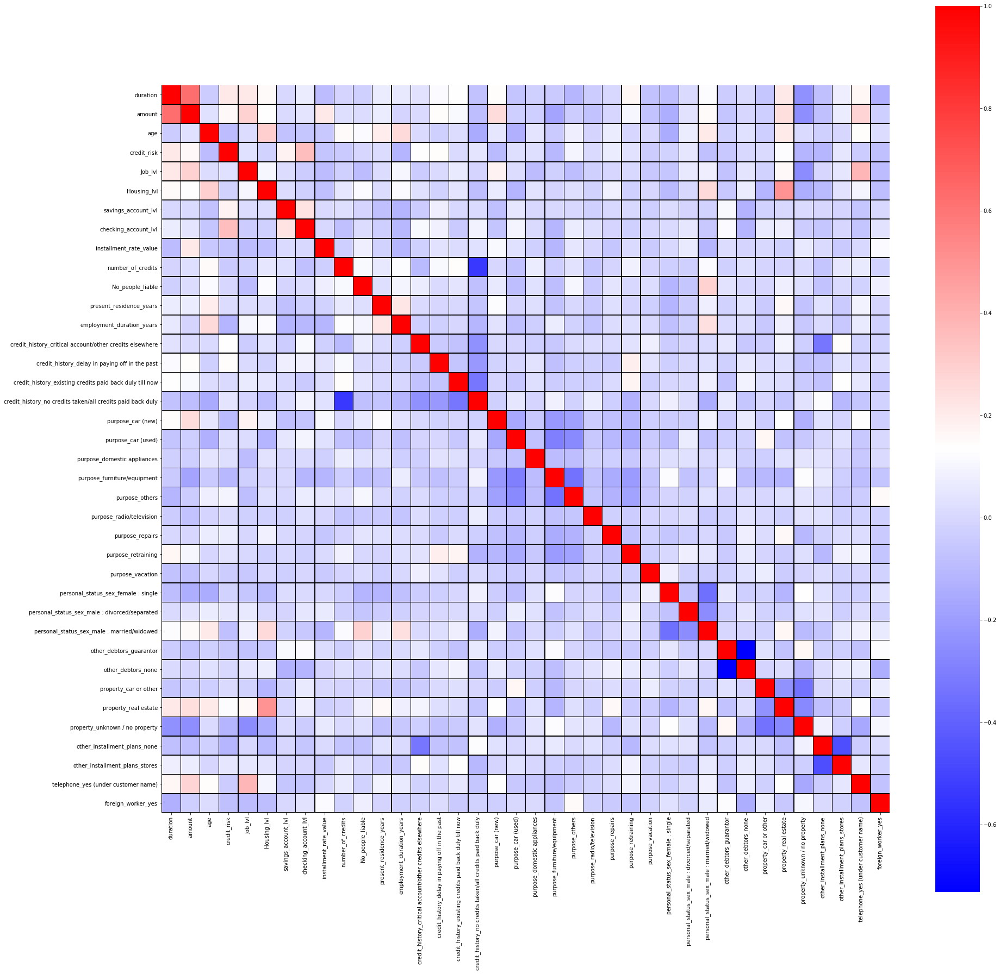

In [49]:
plt.figure(figsize=(30,30))
ax = sns.heatmap(df.astype(float).corr(),linewidths=0.3,vmax=1.0, 
            square=True,  linecolor='black', annot=False,cmap='bwr')
#ax.hlines([9,13,22,26,29,32,34,40,42,45,46,47,48,52,61,65,68,71,73,79,81,84,85,86,87,91,100,104,107,110,112,115,118,120,123,124], *ax.get_xlim())
ax.hlines([2,3,4,5,6,7,8,9,10,11,12,13,18,30,32,35,37], *ax.get_xlim())
plt.show()

Modeling¶

In [50]:
#Data Preprocessing and feature engineering
from sklearn import decomposition, datasets, preprocessing
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.pipeline import FeatureUnion, Pipeline
from sklearn.feature_selection import SelectKBest
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, cross_validate, cross_val_score, GridSearchCV, KFold, RepeatedStratifiedKFold
    
# Algorithmns models to be compared
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from xgboost import XGBClassifier

#To evaluate our model
from sklearn.utils import resample
from sklearn.metrics import accuracy_score, fbeta_score, recall_score, make_scorer, confusion_matrix, classification_report, fbeta_score, roc_curve, precision_recall_curve, average_precision_score
from itertools import cycle

In [51]:
# Use label_binarize to be multi-label like settings
#Y_classes = label_binarize(Y, classes=[1,0])
n_classes = 2
seed = 42
kfold = KFold(n_splits=10, random_state=seed,shuffle=True)

In [52]:
df_saved.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 24 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null category
duration                   1000 non-null int

In [53]:
#df['Credit amount'] = np.log(df['Credit amount'])
# label_encoder object knows how to understand word labels. 
label_encoder_personal_status_sex = preprocessing.LabelEncoder()
label_encoder_job = preprocessing.LabelEncoder()
label_encoder_housing = preprocessing.LabelEncoder()
label_encoder_savings_account = preprocessing.LabelEncoder()
label_encoder_checking_account = preprocessing.LabelEncoder()
label_encoder_purpose = preprocessing.LabelEncoder()
label_encoder_credit_history = preprocessing.LabelEncoder()
label_encoder_employment_duration = preprocessing.LabelEncoder()
label_encoder_installment_rate = preprocessing.LabelEncoder()
label_encoder_property = preprocessing.LabelEncoder()
label_encoder_other_installment_plans = preprocessing.LabelEncoder()
label_encoder_number_credits = preprocessing.LabelEncoder()
label_encoder_people_liable = preprocessing.LabelEncoder()
label_encoder_telephone = preprocessing.LabelEncoder()
label_encoder_foreign_worker = preprocessing.LabelEncoder()
#label_encoder_credit_risk = preprocessing.LabelEncoder()
label_encoder_other_debtors = preprocessing.LabelEncoder()
label_encoder_present_residence = preprocessing.LabelEncoder()

# Encode labels in column . 
proc_org_df = df_saved.copy(deep=True)
proc_org_df['personal_status_sex'] = label_encoder_personal_status_sex.fit_transform(proc_org_df['personal_status_sex']) 
proc_org_df['job'] = label_encoder_job.fit_transform(proc_org_df['job']) 
proc_org_df['housing'] = label_encoder_housing.fit_transform(proc_org_df['housing']) 
proc_org_df['savings_account'] = label_encoder_savings_account.fit_transform(proc_org_df['savings_account']) 
proc_org_df['checking_account'] =label_encoder_checking_account.fit_transform(proc_org_df['checking_account']) 
proc_org_df['purpose'] = label_encoder_purpose.fit_transform(proc_org_df['purpose']) 
#proc_org_df['credit_risk'] = label_encoder_credit_risk.fit_transform(proc_org_df['credit_risk'])
proc_org_df['credit_history'] = label_encoder_credit_history.fit_transform(proc_org_df['credit_history'])
proc_org_df['employment_duration'] = label_encoder_employment_duration.fit_transform(proc_org_df['employment_duration'])
proc_org_df['installment_rate'] = label_encoder_installment_rate.fit_transform(proc_org_df['installment_rate'])
proc_org_df['property'] = label_encoder_property.fit_transform(proc_org_df['property'])
proc_org_df['other_installment_plans'] = label_encoder_other_installment_plans.fit_transform(proc_org_df['other_installment_plans'])
proc_org_df['number_credits'] = label_encoder_number_credits.fit_transform(proc_org_df['number_credits'])
proc_org_df['people_liable'] = label_encoder_people_liable.fit_transform(proc_org_df['people_liable'])
proc_org_df['telephone'] = label_encoder_telephone.fit_transform(proc_org_df['telephone'])
proc_org_df['foreign_worker'] = label_encoder_foreign_worker.fit_transform(proc_org_df['foreign_worker'])
proc_org_df['other_debtors'] = label_encoder_other_debtors.fit_transform(proc_org_df['other_debtors'])
proc_org_df['present_residence'] = label_encoder_present_residence.fit_transform(proc_org_df['present_residence'])

# encoding risk as binary
r = {"good":0, "bad": 1}
proc_org_df[label]=proc_org_df[label].map(r)

proc_org_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,3,0,2,4,2,2,0,2,3,1,1,0,0,1,0,0,0,18,1049,21,0,Student,2,0
1,3,0,5,4,0,1,3,2,0,3,1,0,1,1,1,0,0,9,2799,36,0,Adult,2,0
2,0,4,8,0,1,1,0,2,3,3,1,0,0,3,0,0,0,12,841,23,0,Student,1,0
3,3,0,5,4,0,0,3,2,0,3,1,0,1,3,1,0,1,12,2122,39,0,Adult,1,0
4,3,0,5,4,0,2,3,2,3,1,0,2,1,3,0,0,1,12,2171,38,0,Adult,1,1


In [54]:
#Creating the X and y variables
Y = proc_org_df['credit_risk'].values

del proc_org_df['credit_risk']
del proc_org_df['Age_cat']
del proc_org_df['Job_lvl']
del proc_org_df['Housing_lvl']

scaler = StandardScaler()
scaler.fit(proc_org_df)
X = pd.DataFrame(scaler.transform(proc_org_df),columns = proc_org_df.columns)

X.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,1.448029,-1.412370,-1.005257,0.747297,0.353517,0.449554,-1.348723,0.301109,1.046179,-0.318910,0.218346,-1.970582,-0.704926,-0.289639,-0.428290,-0.823318,-0.196014,-0.240857,-0.787657,-1.281573
1,1.448029,-1.412370,0.430824,0.747297,-1.134975,-0.649600,0.855073,0.301109,-1.275224,1.333473,0.218346,-1.970582,1.027079,-0.289639,2.334869,-0.823318,-0.196014,-0.987573,-0.167384,0.040363
2,-1.172047,0.835732,1.866905,-1.886349,-0.390729,-0.649600,-1.348723,0.301109,1.046179,1.333473,0.218346,-1.970582,-0.704926,1.824516,-0.428290,-0.823318,-0.196014,-0.738668,-0.861381,-1.105315
3,1.448029,-1.412370,0.430824,0.747297,-1.134975,-1.748754,0.855073,0.301109,-1.275224,1.333473,0.218346,-1.970582,1.027079,1.824516,2.334869,-0.823318,5.101669,-0.738668,-0.407341,0.304750
4,1.448029,-1.412370,0.430824,0.747297,-1.134975,0.449554,0.855073,0.301109,1.046179,-0.318910,-2.154977,0.596952,1.027079,1.824516,-0.428290,-0.823318,5.101669,-0.738668,-0.389974,0.216621


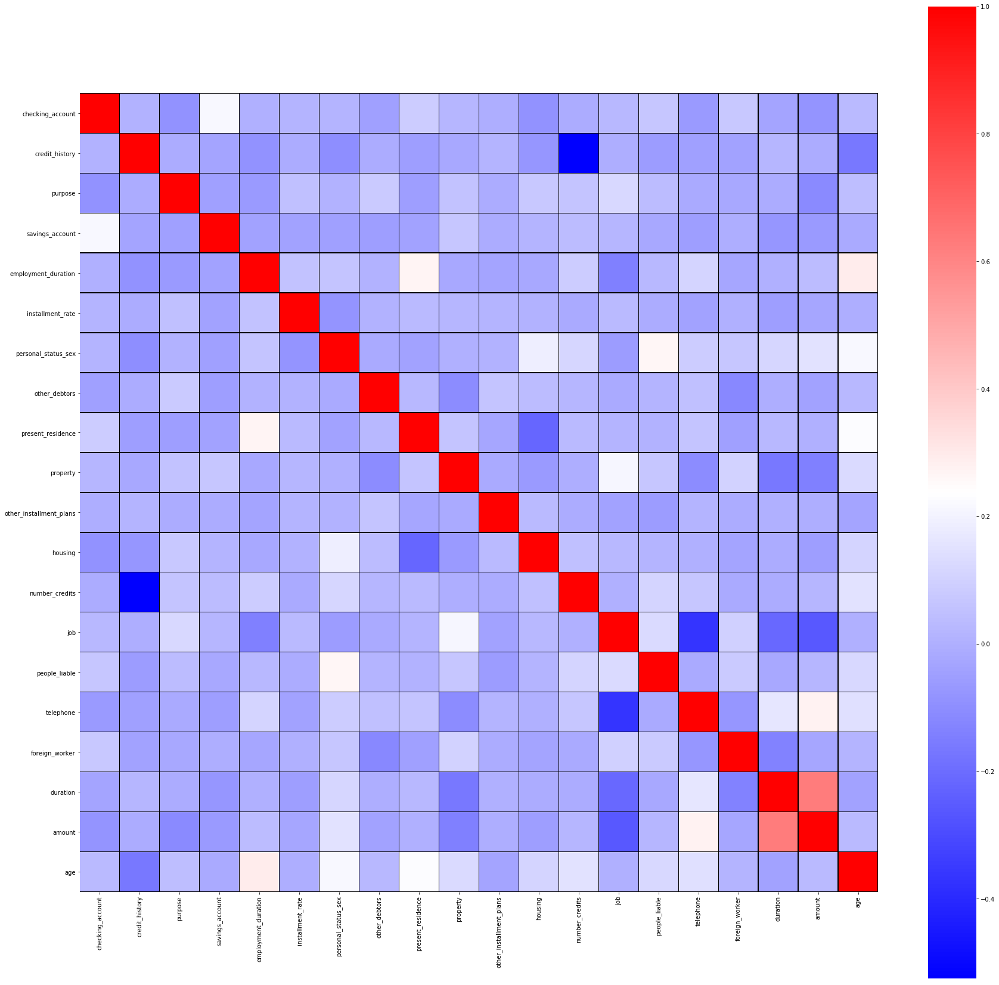

In [55]:
plt.figure(figsize=(30,30))
ax = sns.heatmap(X.astype(float).corr(),linewidths=0.3,vmax=1.0, 
            square=True,  linecolor='black', annot=False,cmap='bwr')
#ax.hlines([9,13,22,26,29,32,34,40,42,45,46,47,48,52,61,65,68,71,73,79,81,84,85,86,87,91,100,104,107,110,112,115,118,120,123,124], *ax.get_xlim())
#ax.hlines([2,3,4,5,6,7,8,9,10,11,12,13,18,30,32,35,37], *ax.get_xlim())
plt.show()

In [56]:

# Spliting X and y into train and test version
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.25, random_state=seed)

In [57]:
len(X_train)

750

In [58]:
len(X_test)

250

Model Select 1: Random Forest

In [59]:
RF = RandomForestClassifier(max_depth=None, max_features=20, n_estimators=5, random_state=seed)
#trainning with the best params
RF.fit(X_train, Y_train)

RandomForestClassifier(max_features=20, n_estimators=5, random_state=42)

In [60]:
#Testing the model 
#Predicting using our  model
Y_pred_RF = RF.predict(X_test)

# Verificaar os resultados obtidos
print(accuracy_score(Y_test,Y_pred_RF)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test,Y_pred_RF))
print("\n")
print(fbeta_score(Y_test, Y_pred_RF, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_RF))

69.19999999999999
 percent


[[142  33]
 [ 44  31]]


0.42582417582417587


              precision    recall  f1-score   support

           0       0.76      0.81      0.79       175
           1       0.48      0.41      0.45        75

    accuracy                           0.69       250
   macro avg       0.62      0.61      0.62       250
weighted avg       0.68      0.69      0.68       250



In [61]:
#Seting the Hyper Parameters
param_grid_RF = {
              "max_depth": [3,5, 7, 10,None],
              "n_estimators":[3,5,10,25,50,150],
              "max_features": [4,7,9,12,15,20]
             }

#Creating the classifier
RF_grid = RandomForestClassifier(random_state=seed)

RF_grid_search = GridSearchCV(RF_grid, param_grid=param_grid_RF, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
RF_grid_search.fit(X_train,Y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 10, None],
                         'max_features': [4, 7, 9, 12, 15, 20],
                         'n_estimators': [3, 5, 10, 25, 50, 150]},
             scoring='accuracy', verbose=4)

In [62]:
RF_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__bootstrap', 'estimator__ccp_alpha', 'estimator__class_weight', 'estimator__criterion', 'estimator__max_depth', 'estimator__max_features', 'estimator__max_leaf_nodes', 'estimator__max_samples', 'estimator__min_impurity_decrease', 'estimator__min_impurity_split', 'estimator__min_samples_leaf', 'estimator__min_samples_split', 'estimator__min_weight_fraction_leaf', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__oob_score', 'estimator__random_state', 'estimator__verbose', 'estimator__warm_start', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [63]:
print(RF_grid_search.best_score_)
print(RF_grid_search.best_params_)


0.756
{'max_depth': 7, 'max_features': 9, 'n_estimators': 150}


In [64]:
#Testing the model 
#Predicting using our  model
Y_pred_RF_grid = RF_grid_search.predict(X_test)

# Verificaar os resultados obtidos
print(accuracy_score(Y_test,Y_pred_RF_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test,Y_pred_RF_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_RF_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_RF_grid))

73.2
 percent


[[157  18]
 [ 49  26]]


0.3779069767441861


              precision    recall  f1-score   support

           0       0.76      0.90      0.82       175
           1       0.59      0.35      0.44        75

    accuracy                           0.73       250
   macro avg       0.68      0.62      0.63       250
weighted avg       0.71      0.73      0.71       250



Model Select 2: Gaussian Naive Baes

In [65]:
# Naive Baes Classifier
GNB = GaussianNB()

# Fitting with train data
GNB.fit(X_train, Y_train)

GaussianNB()

In [66]:
# Printing the Training Score
print("Training score data: ")
print(GNB.score(X_train, Y_train))

Training score data: 
0.7133333333333334


In [67]:
Y_pred_GNB = GNB.predict(X_test)

print(accuracy_score(Y_test,Y_pred_GNB)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_GNB))
print("\n")
print(classification_report(Y_test, Y_pred_GNB))

68.8
 percent


[[139  36]
 [ 42  33]]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78       175
           1       0.48      0.44      0.46        75

    accuracy                           0.69       250
   macro avg       0.62      0.62      0.62       250
weighted avg       0.68      0.69      0.68       250



In [68]:
features = []
features.append(('pca', PCA(n_components=2)))
features.append(('select_best', SelectKBest(k=6)))
feature_union = FeatureUnion(features)
# create pipeline
estimators = []
estimators.append(('feature_union', feature_union))
estimators.append(('clf', GaussianNB()))
# evaluate pipeline

In [69]:
param_grid_GNB = {
    'priors': [None],
    #'feature_union__pca__n_components' : [2],
    #'feature_union__select_best__k': [6],
    'var_smoothing': np.logspace(0,-9, num=100)
}

GNB_grid = GaussianNB()

GNB_grid_search=GridSearchCV(GNB_grid,param_grid=param_grid_GNB,cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
GNB_grid_search.fit(X_train,Y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=GaussianNB(), n_jobs=-1,
             param_grid={'priors': [None],
                         'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             scoring='accuracy', verbose=4)

In [70]:
GNB_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__priors', 'estimator__var_smoothing', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [71]:
print(GNB_grid_search.best_score_)
print(GNB_grid_search.best_params_)

0.724
{'priors': None, 'var_smoothing': 1.0}


In [72]:
Y_pred_GNB_grid = GNB_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_GNB_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_GNB_grid))
print("\n")
print(classification_report(Y_test, Y_pred_GNB_grid))

70.39999999999999
 percent


[[163  12]
 [ 62  13]]


              precision    recall  f1-score   support

           0       0.72      0.93      0.81       175
           1       0.52      0.17      0.26        75

    accuracy                           0.70       250
   macro avg       0.62      0.55      0.54       250
weighted avg       0.66      0.70      0.65       250



Model select 3: XGBoost

In [73]:
#Seting the Hyper Parameters
param_grid_XG = {
 'max_depth':[3,5,6,10],
 'min_child_weight':[3,5,10],
 'gamma':[0.0, 0.1, 0.2, 0.3, 0.4],
 'reg_alpha':[0.1, 1, 10],
 'subsample':[i/100.0 for i in range(75,90,5)],
 'colsample_bytree':[i/100.0 for i in range(75,90,5)]
}

#Creating the classifier
model_xg = XGBClassifier(random_state=seed)

XG_grid_search = GridSearchCV(model_xg, param_grid=param_grid_XG, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
XG_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 1620 candidates, totalling 16200 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=XGBClassifier(random_state=42), n_jobs=-1,
             param_grid={'colsample_bytree': [0.75, 0.8, 0.85],
                         'gamma': [0.0, 0.1, 0.2, 0.3, 0.4],
                         'max_depth': [3, 5, 6, 10],
                         'min_child_weight': [3, 5, 10],
                         'reg_alpha': [0.1, 1, 10],
                         'subsample': [0.75, 0.8, 0.85]},
             scoring='accuracy', verbose=4)

In [74]:
XG_grid_search.best_score_
XG_grid_search.best_params_

{'colsample_bytree': 0.75,
 'gamma': 0.2,
 'max_depth': 5,
 'min_child_weight': 5,
 'reg_alpha': 0.1,
 'subsample': 0.85}

In [75]:
XG_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__base_score', 'estimator__booster', 'estimator__colsample_bylevel', 'estimator__colsample_bynode', 'estimator__colsample_bytree', 'estimator__gamma', 'estimator__learning_rate', 'estimator__max_delta_step', 'estimator__max_depth', 'estimator__min_child_weight', 'estimator__missing', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__nthread', 'estimator__objective', 'estimator__random_state', 'estimator__reg_alpha', 'estimator__reg_lambda', 'estimator__scale_pos_weight', 'estimator__seed', 'estimator__silent', 'estimator__subsample', 'estimator__verbosity', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [76]:
Y_pred_XG_grid = XG_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_XG_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_XG_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_XG_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_XG_grid))

74.4
 percent


[[150  25]
 [ 39  36]]


0.49861495844875336


              precision    recall  f1-score   support

           0       0.79      0.86      0.82       175
           1       0.59      0.48      0.53        75

    accuracy                           0.74       250
   macro avg       0.69      0.67      0.68       250
weighted avg       0.73      0.74      0.74       250



In [77]:
#Seting the Hyper Parameters
param_grid_KNN = {
 'n_neighbors' : [3,5,11,19],
 'weights': ['uniform','distance'],
 'metric': ['manhattan']
}

#Creating the classifier
KNN = KNeighborsClassifier(n_neighbors=3)

KNN_grid_search = GridSearchCV(KNN, param_grid=param_grid_KNN, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
KNN_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 8 candidates, totalling 80 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['manhattan'], 'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)

In [78]:
KNN_grid_search.best_score_
KNN_grid_search.best_params_

{'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'uniform'}

In [79]:
KNN_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__algorithm', 'estimator__leaf_size', 'estimator__metric', 'estimator__metric_params', 'estimator__n_jobs', 'estimator__n_neighbors', 'estimator__p', 'estimator__weights', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [80]:
Y_pred_KNN_grid = KNN_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_KNN_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_KNN_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_KNN_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_KNN_grid))

72.39999999999999
 percent


[[167   8]
 [ 61  14]]


0.2173913043478261


              precision    recall  f1-score   support

           0       0.73      0.95      0.83       175
           1       0.64      0.19      0.29        75

    accuracy                           0.72       250
   macro avg       0.68      0.57      0.56       250
weighted avg       0.70      0.72      0.67       250



Model select 5: LDA

In [81]:
#Creating the classifier
LDA = LinearDiscriminantAnalysis()
# define model evaluation method
#cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define grid
param_grid_LDA = dict()
param_grid_LDA['solver'] = ['svd', 'lsqr', 'eigen']

LDA_grid_search = GridSearchCV(LDA, param_grid=param_grid_LDA, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
LDA_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)

In [82]:
LDA_grid_search.best_score_
LDA_grid_search.best_params_

{'solver': 'svd'}

In [83]:
LDA_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__covariance_estimator', 'estimator__n_components', 'estimator__priors', 'estimator__shrinkage', 'estimator__solver', 'estimator__store_covariance', 'estimator__tol', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [84]:
Y_pred_LDA_grid = LDA_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_LDA_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_LDA_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_LDA_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_LDA_grid))

71.2
 percent


[[156  19]
 [ 53  22]]


0.3225806451612903


              precision    recall  f1-score   support

           0       0.75      0.89      0.81       175
           1       0.54      0.29      0.38        75

    accuracy                           0.71       250
   macro avg       0.64      0.59      0.60       250
weighted avg       0.68      0.71      0.68       250



Model select 6: SVM

In [85]:
#Seting the Hyper Parameters
# defining parameter range 
param_grid_SVM = {'C': [0.1, 1, 10, 100, 1000],  
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001], 
              'kernel': ['rbf']
             }  

#Creating the classifier
SVM = SVC(probability=True)

SVM_grid_search = GridSearchCV(SVM, param_grid=param_grid_SVM, cv=5, scoring='accuracy', n_jobs=-1, verbose=4)
SVM_grid_search.fit(X_train, Y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


GridSearchCV(cv=5, estimator=SVC(probability=True), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             scoring='accuracy', verbose=4)

In [86]:
SVM_grid_search.best_score_
SVM_grid_search.best_params_

{'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}

In [87]:
SVM_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__C', 'estimator__break_ties', 'estimator__cache_size', 'estimator__class_weight', 'estimator__coef0', 'estimator__decision_function_shape', 'estimator__degree', 'estimator__gamma', 'estimator__kernel', 'estimator__max_iter', 'estimator__probability', 'estimator__random_state', 'estimator__shrinking', 'estimator__tol', 'estimator__verbose', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [88]:
Y_pred_SVM_grid = SVM_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_SVM_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_SVM_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_SVM_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_SVM_grid))

74.0
 percent


[[159  16]
 [ 49  26]]


0.38011695906432746


              precision    recall  f1-score   support

           0       0.76      0.91      0.83       175
           1       0.62      0.35      0.44        75

    accuracy                           0.74       250
   macro avg       0.69      0.63      0.64       250
weighted avg       0.72      0.74      0.71       250



Model select 7: CART - Descision Trees

In [89]:
#Seting the Hyper Parameters
param_grid_CART = {
    'max_leaf_nodes': list(range(2, 100)), 
    'min_samples_split': [2, 3, 4,5,6,7]
}

#Creating the classifier
CART = DecisionTreeClassifier(random_state=seed)

CART_grid_search = GridSearchCV(CART, param_grid=param_grid_CART, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
CART_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 588 candidates, totalling 5880 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4, 5, 6, 7]},
             scoring='accuracy', verbose=4)

In [90]:
CART_grid_search.best_score_
CART_grid_search.best_params_

{'max_leaf_nodes': 9, 'min_samples_split': 2}

In [91]:
CART_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__ccp_alpha', 'estimator__class_weight', 'estimator__criterion', 'estimator__max_depth', 'estimator__max_features', 'estimator__max_leaf_nodes', 'estimator__min_impurity_decrease', 'estimator__min_impurity_split', 'estimator__min_samples_leaf', 'estimator__min_samples_split', 'estimator__min_weight_fraction_leaf', 'estimator__random_state', 'estimator__splitter', 'estimator', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [92]:
Y_pred_CART_grid = CART_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_CART_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_CART_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_CART_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_CART_grid))

71.2
 percent


[[163  12]
 [ 60  15]]


0.2293577981651376


              precision    recall  f1-score   support

           0       0.73      0.93      0.82       175
           1       0.56      0.20      0.29        75

    accuracy                           0.71       250
   macro avg       0.64      0.57      0.56       250
weighted avg       0.68      0.71      0.66       250



Model Select 8: Logistic Regression

In [93]:
std_slc = StandardScaler()
pca = decomposition.PCA()
#Creating the classifier
LR = LogisticRegression()

# Setting up pipeline for LR
pipe = Pipeline(steps=[('std_slc', std_slc),
                           ('pca', pca),
                           ('logistic_Reg', LR)])

n_components = list(range(1,X.shape[1]+1,1))
C = np.logspace(-4, 4, 50)
penalty = ['l1', 'l2']
    
#Seting the Hyper Parameters
param_grid_LR = dict(std_slc=[std_slc],
                     pca__n_components=n_components,
                     logistic_Reg__C=C,
                     logistic_Reg__penalty=penalty)

LR_grid_search = GridSearchCV(pipe, param_grid=param_grid_LR, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
LR_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 2000 candidates, totalling 20000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                       ('pca', PCA()),
                                       ('logistic_Reg', LogisticRegression())]),
             n_jobs=-1,
             param_grid={'logistic_Reg__C': array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
       4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
       2.02358965...
       7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
       3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
       1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
       6.86648845e+03, 1.00000000e+04]),
                         'logistic_Reg__penalty': ['l1', 'l2'],
                         'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                     

In [94]:
LR_grid_search.best_score_
LR_grid_search.best_params_

{'logistic_Reg__C': 0.013257113655901081,
 'logistic_Reg__penalty': 'l2',
 'pca__n_components': 14,
 'std_slc': StandardScaler()}

In [95]:
LR_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__memory', 'estimator__steps', 'estimator__verbose', 'estimator__std_slc', 'estimator__pca', 'estimator__logistic_Reg', 'estimator__std_slc__copy', 'estimator__std_slc__with_mean', 'estimator__std_slc__with_std', 'estimator__pca__copy', 'estimator__pca__iterated_power', 'estimator__pca__n_components', 'estimator__pca__random_state', 'estimator__pca__svd_solver', 'estimator__pca__tol', 'estimator__pca__whiten', 'estimator__logistic_Reg__C', 'estimator__logistic_Reg__class_weight', 'estimator__logistic_Reg__dual', 'estimator__logistic_Reg__fit_intercept', 'estimator__logistic_Reg__intercept_scaling', 'estimator__logistic_Reg__l1_ratio', 'estimator__logistic_Reg__max_iter', 'estimator__logistic_Reg__multi_class', 'estimator__logistic_Reg__n_jobs', 'estimator__logistic_Reg__penalty', 'estimator__logistic_Reg__random_state', 'estimator__logistic_Reg__solver', 'estimator__logistic_Reg__tol', 'estimator__logistic_Reg__verbose', 'estimator__logistic_Re

In [96]:
Y_pred_LR_grid = LR_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_LR_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_LR_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_LR_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_LR_grid))

70.8
 percent


[[168   7]
 [ 66   9]]


0.14240506329113922


              precision    recall  f1-score   support

           0       0.72      0.96      0.82       175
           1       0.56      0.12      0.20        75

    accuracy                           0.71       250
   macro avg       0.64      0.54      0.51       250
weighted avg       0.67      0.71      0.63       250



In [97]:
import tensorflow as tf
import functools

In [98]:
from tensorflow.python.client import device_lib 
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 4987735272801793993
]


In [99]:
#from numba import cuda 
#cuda.select_device(0)

In [100]:
# Creates a tf feature spec from the dataframe and columns specified.
def create_feature_spec(df, columns=None):
    feature_spec = {}
    if columns == None:
        columns = df.columns.values.tolist()
    for f in columns:
        if df[f].dtype is np.dtype(np.int64):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(np.int32):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(int):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(np.float64):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.float32)
        else:
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.string)
    return feature_spec

# Creates simple numeric and categorical feature columns from a feature spec and a
# list of columns from that spec to use.
#
# NOTE: Models might perform better with some feature engineering such as bucketed
# numeric columns and hash-bucket/embedding columns for categorical features.
def create_feature_columns(columns, feature_spec,df):
    ret = []
    for col in columns:
        if feature_spec[col].dtype is tf.int64 or feature_spec[col].dtype is tf.float32:
            ret.append(tf.feature_column.numeric_column(col))
        else:
            ret.append(tf.feature_column.indicator_column(
                tf.feature_column.categorical_column_with_vocabulary_list(col, list(df[col].unique()))))
    return ret

# An input function for providing input to a model from tf.Examples
def tfexamples_input_fn(examples, feature_spec, label, mode=tf.estimator.ModeKeys.EVAL,
                       num_epochs=None, 
                       batch_size=64):
    def ex_generator():
        for i in range(len(examples)):
            yield examples[i].SerializeToString()
    dataset = tf.data.Dataset.from_generator(
      ex_generator, tf.dtypes.string, tf.TensorShape([]))
    if mode == tf.estimator.ModeKeys.TRAIN:
        dataset = dataset.shuffle(buffer_size=2 * batch_size + 1)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(lambda tf_example: parse_tf_example(tf_example, label, feature_spec))
    dataset = dataset.repeat(num_epochs)
    return dataset

# Parses Tf.Example protos into features for the input function.
def parse_tf_example(example_proto, label, feature_spec):
    parsed_features = tf.io.parse_example(serialized=example_proto, features=feature_spec)
    target = parsed_features.pop(label)
    return parsed_features, target

# Converts a dataframe into a list of tf.Example protos.
def df_to_examples(df, columns=None):
    examples = []
    if columns == None:
        columns = df.columns.values.tolist()
    for index, row in df.iterrows():
        example = tf.train.Example()
        for col in columns:
            if df[col].dtype is np.dtype(np.int64):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(np.int32):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(int):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(np.float64):
                example.features.feature[col].float_list.value.append(row[col])
            elif row[col] == row[col]:
                #print(row[col])
                example.features.feature[col].bytes_list.value.append(row[col].encode('utf-8'))
        examples.append(example)
    return examples

# Converts a dataframe column into a column of 0's and 1's based on the provided test.
# Used to force label columns to be numeric for binary classification using a TF estimator.
def make_label_column_numeric(df, label_column, test):
    df[label_column] = np.where(test(df[label_column]), 1, 0)

In [101]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 38 columns):
duration                                                      1000 non-null int64
amount                                                        1000 non-null int64
age                                                           1000 non-null int64
credit_risk                                                   1000 non-null int64
Job_lvl                                                       1000 non-null int64
Housing_lvl                                                   1000 non-null int64
savings_account_lvl                                           1000 non-null int64
checking_account_lvl                                          1000 non-null int64
installment_rate_value                                        1000 non-null int64
number_of_credits                                             1000 non-null int64
No_people_liable                                              1000 non-nul

In [102]:
categorical_cols + ordinal_cols + [label]

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker',
 'duration',
 'amount',
 'age',
 'credit_risk']

In [103]:
#input columns and column to predict

# Set the column in the dataset you wish for the model to predict
#label_column = 'Risk'

df_dnn = df_saved.copy(deep=True)

#for col in ['Sex','Job','Housing','Saving accounts','Checking account','Purpose']:
#    df_dnn[col] = df_dnn[col].astype('category')

del df_dnn['Age_cat']
del df_dnn['Job_lvl']
del df_dnn['Housing_lvl']

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving_accounts','Checking_account','Credit_amount','Duration','Purpose','Age_cat','Job_lvl']
make_label_column_numeric(df_dnn, label, lambda val: val == "bad")

#df_dnn = df_dnn.rename(columns=df_dnn.columns)
# Make the label column numeric (0 and 1), for use in our model.
# In this case, examples with a target value of '>50K' are considered to be in
# the '1' (positive) class and all other examples are considered to be in the
# '0' (negative) class.

# Create a list containing all input features and the label column
features_and_labels = categorical_cols + ordinal_cols + [label]
input_features = categorical_cols + ordinal_cols

#X_dnn = df_dnn.loc[:,['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Age_cat','Job_lvl']]
#Y_dnn = df_dnn.loc[:,['Risk']]

# Spliting X and y into train and test version
df_dnn_train, df_dnn_test = train_test_split(df_dnn, test_size = 0.25, random_state=seed)

In [104]:
#input_features = categorical_cols + ordinal_cols

In [105]:
features_and_labels

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker',
 'duration',
 'amount',
 'age',
 'credit_risk']

In [106]:
df_dnn.credit_risk.sum()

300

In [107]:
df_dnn.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,0


In [108]:
df_dnn_train.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
82,... < 0 DM,no credits taken/all credits paid back duly,others,... < 100 DM,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,building soc. savings agr./life insurance,none,rent,2-3,skilled employee/official,0 to 2,yes (under customer name),no,18,5866,30,0
991,... < 0 DM,no credits taken/all credits paid back duly,car (new),unknown/no savings account,>= 7 yrs,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,real estate,none,own,1,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,24,12579,44,1
789,... < 0 DM,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,bank,rent,1,unskilled - resident,0 to 2,no,no,24,4736,25,1
894,... < 0 DM,existing credits paid back duly till now,car (used),unknown/no savings account,unemployed,20 <= ... < 25,female : non-single or male : single,none,1 <= ... < 4 yrs,car or other,none,rent,1,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,24,2064,34,1
398,... >= 200 DM / salary for at least 1 year,existing credits paid back duly till now,car (new),unknown/no savings account,1 <= ... < 4 yrs,< 20,female : single,none,>= 7 yrs,unknown / no property,none,for free,1,skilled employee/official,0 to 2,no,no,12,1503,41,0


In [109]:
df_dnn_test.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
521,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,unemployed,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,building soc. savings agr./life insurance,none,rent,2-3,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,36,10974,26,1
737,... >= 200 DM / salary for at least 1 year,all credits at this bank paid back duly,furniture/equipment,500 <= ... < 1000 DM,1 <= ... < 4 yrs,< 20,male : married/widowed,none,4 <= ... < 7 yrs,unknown / no property,none,rent,2-3,skilled employee/official,0 to 2,no,no,18,1149,46,0
740,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,4 <= ... < 7 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,rent,1,unskilled - resident,0 to 2,no,no,12,1736,31,0
660,... < 0 DM,no credits taken/all credits paid back duly,furniture/equipment,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,guarantor,1 <= ... < 4 yrs,unknown / no property,none,rent,1,skilled employee/official,0 to 2,no,yes,8,1414,33,0
411,... >= 200 DM / salary for at least 1 year,existing credits paid back duly till now,retraining,... >= 1000 DM,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,unknown / no property,none,rent,2-3,skilled employee/official,3 or more,yes (under customer name),no,24,2978,32,0


In [110]:
#Convert dataset to tf.Example protos
examples = df_to_examples(df_dnn_train)
# Create a feature spec for the classifier
feature_spec = create_feature_spec(df_dnn_train, features_and_labels)
X_dnn_train = functools.partial(tfexamples_input_fn, examples, feature_spec, label)

examples_test = df_to_examples(df_dnn_test)
# Create a feature spec for the classifier
feature_spec_test = create_feature_spec(df_dnn_test, features_and_labels)
X_dnn_test = functools.partial(tfexamples_input_fn, examples_test, feature_spec_test, label)

In [111]:
#physical_devices = tf.config.list_physical_devices('GPU')
#print(physical_devices)
#tf.config.experimental.set_memory_growth(physical_devices[0], False)
#config = tf.ConfigProto()
#config.gpu_options.allow_growth = True
#sess = tf.Session(config=config)

In [112]:
#Create and train the DNN classifier
num_steps = 500

DNN_Classifier = tf.estimator.DNNClassifier(
    feature_columns=create_feature_columns(categorical_cols + ordinal_cols, feature_spec,df_dnn),
    hidden_units=[14, 5])
DNN_Classifier.train(X_dnn_train, steps=num_steps)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpe8ed4fog', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
Instructions for updating:
Use Variable.read_value. Variables in 2.X are initiali

In [113]:
DNN_Classifier.evaluate(X_dnn_test, steps=num_steps)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2021-01-17T12:23:25Z
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpe8ed4fog/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [50/500]
INFO:tensorflow:Evaluation [100/500]
INFO:tensorflow:Evaluation [150/500]
INFO:tensorflow:Evaluation [200/500]
INFO:tensorflow:Evaluation [250/500]
INFO:tensorflow:Evaluation [300/500]
INFO:tensorflow:Evaluation [350/500]
INFO:tensorflow:Evaluation [400/500]
INFO:tensorflow:Evaluation [450/500]
INFO:tensorflow:Evaluation [500/500]
INFO:tensorflow:Inference Time : 8.91189s
INFO:tensorflow:Finished evaluation at 2021-01-17-12:23:34
INFO:tensorflow:Saving dict for global step 500: accuracy = 0.532, accuracy_baseline = 0.7, auc = 0.40761906, auc_precision_recall = 0.27065632, average_loss = 0.7366191, global_step = 500, label/mean = 

{'accuracy': 0.532,
 'accuracy_baseline': 0.7,
 'auc': 0.40761906,
 'auc_precision_recall': 0.27065632,
 'average_loss': 0.7366191,
 'global_step': 500,
 'label/mean': 0.3,
 'loss': 0.7362072,
 'precision': 0.2375,
 'prediction/mean': 0.43298322,
 'recall': 0.25333333}

In [114]:
import keras 
#Create and train the Linear classifier

LR_Classifier = tf.estimator.LinearClassifier(
    feature_columns=create_feature_columns(input_features, feature_spec,df_dnn),
     n_classes=2, weight_column=None,
    label_vocabulary=None, optimizer='Ftrl', config=None,
    warm_start_from=None,
    loss_reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE,
    sparse_combiner='sum'
    )
LR_Classifier.train(X_dnn_train, steps=num_steps)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpjcohtkla', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:ten

In [115]:
LR_Classifier.evaluate(X_dnn_test, steps=num_steps)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2021-01-17T12:23:49Z
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpjcohtkla/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [50/500]
INFO:tensorflow:Evaluation [100/500]
INFO:tensorflow:Evaluation [150/500]
INFO:tensorflow:Evaluation [200/500]
INFO:tensorflow:Evaluation [250/500]
INFO:tensorflow:Evaluation [300/500]
INFO:tensorflow:Evaluation [350/500]
INFO:tensorflow:Evaluation [400/500]
INFO:tensorflow:Evaluation [450/500]
INFO:tensorflow:Evaluation [500/500]
INFO:tensorflow:Inference Time : 8.85344s
INFO:tensorflow:Finished evaluation at 2021-01-17-12:23:58
INFO:tensorflow:Saving dict for global step 500: accuracy = 0.7, accuracy_baseline = 0.7, auc = 0.5246858, auc_precision_recall = 0.34939644, average_loss = 8.86158, global_step = 500, label/mean = 0.3, 

{'accuracy': 0.7,
 'accuracy_baseline': 0.7,
 'auc': 0.5246858,
 'auc_precision_recall': 0.34939644,
 'average_loss': 8.86158,
 'global_step': 500,
 'label/mean': 0.3,
 'loss': 8.813046,
 'precision': 0.0,
 'prediction/mean': 0.0023163336,
 'recall': 0.0}

In [116]:
#Create and train the Linear DNN classifier

LinearDNN_Classifier = tf.estimator.DNNLinearCombinedClassifier (
    dnn_feature_columns=create_feature_columns(input_features, feature_spec,df_dnn),
    linear_optimizer='Ftrl', dnn_optimizer='Adagrad',
    dnn_hidden_units=[128, 64, 32],
    dnn_activation_fn=tf.nn.relu, n_classes=2,
    loss_reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE, 
    linear_sparse_combiner='sum'
    )
LinearDNN_Classifier.train(X_dnn_train, steps=num_steps)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpeedzxqho', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:ten

In [117]:
LinearDNN_Classifier.evaluate(X_dnn_test, steps=num_steps)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2021-01-17T12:24:11Z
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpeedzxqho/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [50/500]
INFO:tensorflow:Evaluation [100/500]
INFO:tensorflow:Evaluation [150/500]
INFO:tensorflow:Evaluation [200/500]
INFO:tensorflow:Evaluation [250/500]
INFO:tensorflow:Evaluation [300/500]
INFO:tensorflow:Evaluation [350/500]
INFO:tensorflow:Evaluation [400/500]
INFO:tensorflow:Evaluation [450/500]
INFO:tensorflow:Evaluation [500/500]
INFO:tensorflow:Inference Time : 9.18465s
INFO:tensorflow:Finished evaluation at 2021-01-17-12:24:20
INFO:tensorflow:Saving dict for global step 500: accuracy = 0.7, accuracy_baseline = 0.7, auc = 0.46449524, auc_precision_recall = 0.30410266, average_loss = 1.6148568, global_step = 500, label/mean = 0.

{'accuracy': 0.7,
 'accuracy_baseline': 0.7,
 'auc': 0.46449524,
 'auc_precision_recall': 0.30410266,
 'average_loss': 1.6148568,
 'global_step': 500,
 'label/mean': 0.3,
 'loss': 1.6065458,
 'precision': 0.0,
 'prediction/mean': 0.04915608,
 'recall': 0.0}

In [118]:
#Create and train the Linear DNN classifier

XGBoost_Classifier = tf.estimator.BoostedTreesClassifier(    feature_columns=create_feature_columns(input_features, feature_spec,df_dnn), n_batches_per_layer=5,n_classes=2,
    n_trees=100, max_depth=6,
    learning_rate=0.1, l1_regularization=0.0, l2_regularization=0.0,
    tree_complexity=0.0, min_node_weight=0.0,
    pruning_mode='none', quantile_sketch_epsilon=0.01,
    train_in_memory=False)
XGBoost_Classifier.train(X_dnn_train, steps=num_steps)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpu7q8qyah', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
Instructions for updating:
The old _FeatureColumn APIs are being deprecated. Plea

In [119]:
XGBoost_Classifier.evaluate(X_dnn_test, steps=num_steps)

INFO:tensorflow:Calling model_fn.
Instructions for updating:
The value of AUC returned by this may race with the update so this is deprecated. Please use tf.keras.metrics.AUC instead.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2021-01-17T12:24:35Z
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpu7q8qyah/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [50/500]
INFO:tensorflow:Evaluation [100/500]
INFO:tensorflow:Evaluation [150/500]
INFO:tensorflow:Evaluation [200/500]
INFO:tensorflow:Evaluation [250/500]
INFO:tensorflow:Evaluation [300/500]
INFO:tensorflow:Evaluation [350/500]
INFO:tensorflow:Evaluation [400/500]
INFO:tensorflow:Evaluation [450/500]
INFO:tensorflow:Evaluation [500/500]
INFO:tensorflow:Inference Time : 9.26296s
INFO:tensorflow:Finished evaluation at 2021-01-17-12:24:44
INFO:tensorflow:Saving dict for global step 500: accu

{'accuracy': 0.752,
 'accuracy_baseline': 0.7,
 'auc': 0.75801903,
 'auc_precision_recall': 0.5489794,
 'average_loss': 0.54443675,
 'global_step': 500,
 'label/mean': 0.3,
 'loss': 0.5427537,
 'precision': 0.6181818,
 'prediction/mean': 0.29118603,
 'recall': 0.45333335}

Model Evaluation - without Intrepretability and XAI

In [120]:
import plotly.express as px

In [121]:
import collections
#fig, axs = plt.subplots(5, 2)
#fig.suptitle('ROC Curve Comparision')
def plot_roc(fig,X_test,Y_test,model,message,color):
    #Predicting probabilities
    pred = model.predict(X_test)
    # Generate ROC curve values: fpr, tpr, thresholds
    fpr, tpr, thresholds = roc_curve(Y_test, pred)
    #print(message,' x: ',X_test,' y: ',Y_test)
    #print('\n',message,'\n fpr: ',fpr,'\n tpr: ',tpr,'\n thresholds: ',thresholds)
    # Plot ROC curve
    #px.line(df, x="year", y="lifeExp", color="continent",line_group="country", hover_name="country")
    fig.add_trace(go.Scatter(x=[0, 0.25, 0.5, 1], y=[0, 0.25, 0.5, 1],mode='lines', line=dict(color='black', width=2, dash='dot')))
    fig.add_trace(go.Scatter(x=fpr, y=tpr,mode='lines+markers',name=message,line=dict(color=color, width=4)))
    #ax.plot(,, 'k--')
    #ax.plot(fpr, tpr)
    # Plot ROC curve
    #ax.text(0.25, 0.1,message,fontsize = 24,color="C2", horizontalalignment='left', verticalalignment='bottom',fontweight = 'bold')
    return
def plot_PR(fig,X_test,Y_test,model,message,color):
    y_scores = model.predict_proba(X_test)
    precision = dict()
    recall = dict()
    precision, recall, thresholds = precision_recall_curve(Y_test, y_scores[:,0])
    #print(precision)
    #print(recall)
    fig.add_trace(go.Scatter(x=[0, 0.25, 0.5, 1], y=[0, 0.25, 0.5, 1],mode='lines', line=dict(color='black', width=2, dash='dot')))
    fig.add_trace(go.Scatter(x=recall, y=precision,mode='lines',name=message,line=dict(color=color, width=4)))
    #ax.text(0.25, 0.75,message,fontsize = 24,color="C2", horizontalalignment='left', verticalalignment='baseline',fontweight = 'bold')
    #plot_precision_recall_curve(model, X_test, Y_test)
    return
def plot_PR_f1(ax,X_test,Y_test,model,message):
    #Predicting probabilities
    pred = model.predict(X_test)
    y_score = model.predict_proba(X_test)
    y_actual = np.array([[a,1-a] for a in Y_test])
    #print(y_score)
    colors = cycle(['cyan', 'gold','teal'])
    # Generate PR curve values: precision, recall, average_precision
    # For each class
    precision = dict()
    recall = dict()
    average_precision = dict()
    labels = dict()
    for i in range(n_classes):
        #print(y_actual[:, i])
        #print(y_score[:, i])
        precision[i], recall[i], _ = precision_recall_curve(y_actual[:, i],y_score[:, i])
        average_precision[i] = average_precision_score(y_actual[:, i], y_score[:, i])
    # A "micro-average": quantifying score on all classes jointly
    precision["micro"], recall["micro"], _ = precision_recall_curve(y_actual.ravel(),y_score.ravel())
    average_precision["micro"] = average_precision_score(y_actual, y_score,average="micro")
    #print('Average precision score, micro-averaged over all classes: {0:0.2f}'.format(average_precision["micro"]))
    ax.text(0.25, 0,message,fontsize = 24,color="C2",horizontalalignment='left',verticalalignment='bottom',fontweight = 'bold')
    f_scores = np.linspace(0.2, 0.8, num=4)
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.0])
    ax.set_xlabel('Recall', fontsize = 24, color="C0",fontweight = 'bold')
    ax.set_ylabel('Prescision', fontsize = 24, color="C0",fontweight = 'bold')
    for f_score in f_scores:
        a = np.linspace(0.01, 1)
        b = f_score * a / (2 * a - f_score)
        l, = ax.plot(a[b >= 0], b[b >= 0], color='gray', alpha=0.2)
        ax.annotate('f1={0:0.1f}'.format(f_score), xy=(0.9, b[45] + 0.02))
    labels['iso-f1 curves']=l
    l, = ax.plot(recall["micro"], precision["micro"], color='blue', lw=3)
    labels['micro-average Precision-recall'.format(average_precision["micro"])]=l
    for i, color in zip(range(n_classes), colors):
        l, = ax.plot(recall[i], precision[i], color=color, lw=2)
        labels['Precision-recall for class {0}'.format(i)]=l
    ax.step(recall['micro'], precision['micro'], where='post')
    legend_text = []
    legend_color = []
    for label,line in labels.items():
        legend_text.append(label)
        legend_color.append(line)
    ax.legend(legend_color,legend_text, prop=dict(size=16))
    return
#plt.show()

Examining ROC Curve

In [122]:
fig = go.Figure()

#gs = fig.add_gridspec(5, 2, hspace=1, wspace=1)
#(ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10) = gs.subplots(sharex='col', sharey='row')
#for ax in axs.flat:
#    ax.label_outer()
#ax9.set_xlabel('False Positive Rate -->', fontsize = 42, color="C0",fontweight = 'bold')
#ax5.set_ylabel('True Positive Rate -->', fontsize = 42, color="C0",fontweight = 'bold')
#fig.text(0, 3, 'False Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_roc(fig,X_test,Y_test,RF,"Random Forest",'green')
plot_roc(fig,X_test,Y_test,GNB,"GNB",'chocolate')
plot_roc(fig,X_test,Y_test,RF_grid_search,"Random Forest grid_search",'royalblue')
plot_roc(fig,X_test,Y_test,GNB_grid_search,"GNB grid_search",'maroon')
plot_roc(fig,X_test,Y_test,XG_grid_search,"XGBoost grid_search",'indigo')
plot_roc(fig,X_test,Y_test,KNN_grid_search,"KNN grid_search",'blueviolet')
plot_roc(fig,X_test,Y_test,LDA_grid_search,"LDA grid_search",'sienna')
plot_roc(fig,X_test,Y_test,SVM_grid_search,"SVM grid_search",'forestgreen')
plot_roc(fig,X_test,Y_test,CART_grid_search,"CART grid_search",'olive')
plot_roc(fig,X_test,Y_test,LR_grid_search,"LR grid_search",'fuchsia')
fig.update_xaxes(title_text='False Positive Rate')
fig.update_yaxes(title_text='True Positive Rate')
fig.update_xaxes(range=[0, 1])
fig.update_yaxes(range=[0, 1])
fig.update_yaxes(
    scaleanchor = 'y',
    scaleratio = 2,
  )
#fig.tight_layout()
#fig.suptitle('ROC Curve Comparision',fontsize = 50,verticalalignment = 'center')
fig.show()

Examining the PR Curve

In [123]:
fig1 = go.Figure()
#fig1 = plt.figure()
#fig1.set_figheight(30)
#fig1.set_figwidth(30)
#
#gs1 = fig1.add_gridspec(5, 2, hspace=0, wspace=0)
#(ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10) = gs1.subplots(sharex='col', sharey='row')
#for ax in axs.flat:
#    ax.label_outer()
#ax9.set_xlabel('Recall -->', fontsize = 42, color="C0", fontweight = 'bold')
#ax5.set_ylabel('Prescision -->', fontsize = 42, color="C0", fontweight = 'bold')
#fig.text(0, 3, 'False Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_PR(fig1,X_test,Y_test,RF,"Random Forest",'green')
plot_PR(fig1,X_test,Y_test,GNB,"GNB",'chocolate')
plot_PR(fig1,X_test,Y_test,RF_grid_search,"Random Forest grid_search",'royalblue')
plot_PR(fig1,X_test,Y_test,GNB_grid_search,"GNB grid_search",'maroon')
plot_PR(fig1,X_test,Y_test,XG_grid_search,"XGBoost grid_search",'indigo')
plot_PR(fig1,X_test,Y_test,KNN_grid_search,"KNN grid_search",'blueviolet')
plot_PR(fig1,X_test,Y_test,LDA_grid_search,"LDA grid_search",'sienna')
plot_PR(fig1,X_test,Y_test,SVM_grid_search,"SVM grid_search",'forestgreen')
plot_PR(fig1,X_test,Y_test,CART_grid_search,"CART grid_search",'olive')
plot_PR(fig1,X_test,Y_test,LR_grid_search,"LR grid_search",'fuchsia')
fig1.update_xaxes(title_text='Recall')
fig1.update_yaxes(title_text='Prescision')
fig1.update_xaxes(range=[0, 1])
fig1.update_yaxes(range=[0, 1])
fig1.update_yaxes(
    scaleanchor = 'y',
    scaleratio = 2,
  )
#fig1.tight_layout()
#fig1.suptitle('PR Curve Comparision',fontsize = 50)
fig1.show()

PR Curve class wise comparision

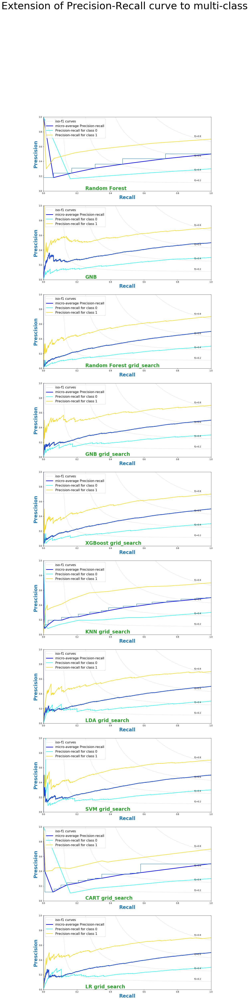

In [124]:
fig2 = plt.figure()
fig2.set_figheight(80)
fig2.set_figwidth(15)

gs2 = fig2.add_gridspec(ncols=1, nrows=10, hspace=0.2, wspace=0.2)
ax1 = fig2.add_subplot(gs2[0,0]) 
ax2 = fig2.add_subplot(gs2[1,0]) 
ax3 = fig2.add_subplot(gs2[2,0]) 
ax4 = fig2.add_subplot(gs2[3,0]) 
ax5 = fig2.add_subplot(gs2[4,0]) 
ax6 = fig2.add_subplot(gs2[5,0]) 
ax7 = fig2.add_subplot(gs2[6,0]) 
ax8 = fig2.add_subplot(gs2[7,0]) 
ax9 = fig2.add_subplot(gs2[8,0]) 
ax10 = fig2.add_subplot(gs2[9,0])
#for ax in axs.flat:
#    ax.label_outer()
#fig.text(0, 3, 'Falplot_PR_f1se Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_PR_f1(ax1,X_test,Y_test,RF,"Random Forest")
plot_PR_f1(ax2,X_test,Y_test,GNB,"GNB")
plot_PR_f1(ax3,X_test,Y_test,RF_grid_search,"Random Forest grid_search")
plot_PR_f1(ax4,X_test,Y_test,GNB_grid_search,"GNB grid_search")
plot_PR_f1(ax5,X_test,Y_test,XG_grid_search,"XGBoost grid_search")
plot_PR_f1(ax6,X_test,Y_test,KNN_grid_search,"KNN grid_search")
plot_PR_f1(ax7,X_test,Y_test,LDA_grid_search,"LDA grid_search")
plot_PR_f1(ax8,X_test,Y_test,SVM_grid_search,"SVM grid_search")
plot_PR_f1(ax9,X_test,Y_test,CART_grid_search,"CART grid_search")
plot_PR_f1(ax10,X_test,Y_test,LR_grid_search,"LR grid_search")
#fig2.tight_layout()
fig2.suptitle('Extension of Precision-Recall curve to multi-class',fontsize = 50)
plt.show()

In [125]:
def plot_feature_importance(model,message,feature_names):
    # get importance
    importance = model.feature_importances_
    # summarize feature importance
    for i,v in enumerate(importance):
        print('Feature %0d: %s, Score: %.5f' % (i,feature_names[i],v))
    # plot feature importance
    #plt.bar(feature_names, importance)
    #plt.title(message)
    #plt.show()
    fig = exp.bar(feature_names,x=importance,y=[x for x in feature_names],title=message)
    fig.show()

In [126]:
plot_feature_importance(RF,"Random Forest",X.columns)
#plot_feature_importance(GNB,"GNB",X.columns)
plot_feature_importance(RF_grid_search.best_estimator_,"Random Forest grid_search",X.columns)
#plot_feature_importance(GNB_grid_search.best_estimator_,"GNB grid_search",X.columns)
plot_feature_importance(XG_grid_search.best_estimator_,"XGBoost grid_search",X.columns)
#plot_feature_importance(KNN_grid_search.best_estimator_,"KNN grid_search",X.columns)
#plot_feature_importance(LDA_grid_search.best_estimator_,"LDA grid_search",X.columns)
#plot_feature_importance(SVM_grid_search.best_estimator_,"SVM grid_search",X.columns)
plot_feature_importance(CART_grid_search.best_estimator_,"CART grid_search",X.columns)
#plot_feature_importance(LR_grid_search.best_estimator_,"LR grid_search",X.columns)

Feature 0: checking_account, Score: 0.10040
Feature 1: credit_history, Score: 0.03919
Feature 2: purpose, Score: 0.06493
Feature 3: savings_account, Score: 0.03987
Feature 4: employment_duration, Score: 0.03921
Feature 5: installment_rate, Score: 0.03149
Feature 6: personal_status_sex, Score: 0.04144
Feature 7: other_debtors, Score: 0.01579
Feature 8: present_residence, Score: 0.02283
Feature 9: property, Score: 0.03039
Feature 10: other_installment_plans, Score: 0.02970
Feature 11: housing, Score: 0.01875
Feature 12: number_credits, Score: 0.03916
Feature 13: job, Score: 0.02589
Feature 14: people_liable, Score: 0.00399
Feature 15: telephone, Score: 0.01573
Feature 16: foreign_worker, Score: 0.00216
Feature 17: duration, Score: 0.11503
Feature 18: amount, Score: 0.18852
Feature 19: age, Score: 0.13552


Feature 0: checking_account, Score: 0.14119
Feature 1: credit_history, Score: 0.04507
Feature 2: purpose, Score: 0.07444
Feature 3: savings_account, Score: 0.04929
Feature 4: employment_duration, Score: 0.03701
Feature 5: installment_rate, Score: 0.02645
Feature 6: personal_status_sex, Score: 0.03300
Feature 7: other_debtors, Score: 0.02544
Feature 8: present_residence, Score: 0.01852
Feature 9: property, Score: 0.03216
Feature 10: other_installment_plans, Score: 0.01854
Feature 11: housing, Score: 0.01920
Feature 12: number_credits, Score: 0.02033
Feature 13: job, Score: 0.03664
Feature 14: people_liable, Score: 0.01006
Feature 15: telephone, Score: 0.01557
Feature 16: foreign_worker, Score: 0.00377
Feature 17: duration, Score: 0.12267
Feature 18: amount, Score: 0.16816
Feature 19: age, Score: 0.10248


Feature 0: checking_account, Score: 0.12068
Feature 1: credit_history, Score: 0.06841
Feature 2: purpose, Score: 0.06099
Feature 3: savings_account, Score: 0.07213
Feature 4: employment_duration, Score: 0.03858
Feature 5: installment_rate, Score: 0.03776
Feature 6: personal_status_sex, Score: 0.04221
Feature 7: other_debtors, Score: 0.04239
Feature 8: present_residence, Score: 0.03957
Feature 9: property, Score: 0.04528
Feature 10: other_installment_plans, Score: 0.03908
Feature 11: housing, Score: 0.04080
Feature 12: number_credits, Score: 0.03106
Feature 13: job, Score: 0.06996
Feature 14: people_liable, Score: 0.03336
Feature 15: telephone, Score: 0.04447
Feature 16: foreign_worker, Score: 0.00000
Feature 17: duration, Score: 0.07089
Feature 18: amount, Score: 0.05506
Feature 19: age, Score: 0.04733


Feature 0: checking_account, Score: 0.46296
Feature 1: credit_history, Score: 0.00000
Feature 2: purpose, Score: 0.10053
Feature 3: savings_account, Score: 0.00000
Feature 4: employment_duration, Score: 0.00000
Feature 5: installment_rate, Score: 0.00000
Feature 6: personal_status_sex, Score: 0.00000
Feature 7: other_debtors, Score: 0.00000
Feature 8: present_residence, Score: 0.00000
Feature 9: property, Score: 0.00000
Feature 10: other_installment_plans, Score: 0.00000
Feature 11: housing, Score: 0.00000
Feature 12: number_credits, Score: 0.00000
Feature 13: job, Score: 0.00000
Feature 14: people_liable, Score: 0.00000
Feature 15: telephone, Score: 0.00000
Feature 16: foreign_worker, Score: 0.00000
Feature 17: duration, Score: 0.20953
Feature 18: amount, Score: 0.22698
Feature 19: age, Score: 0.00000


Grid Search choosing best accuracy among multiple Algorithms

In [127]:
## prepare models
models = []
#models.append(('RF', RF, ))
#models.append(('GNB', GNB))
models.append(('LDA_grid', LDA_grid_search, param_grid_LDA))
models.append(('KNN_grid', KNN_grid_search, param_grid_KNN))
models.append(('CART_grid', CART_grid_search, param_grid_CART))
models.append(('GNB_grid', GNB_grid_search, param_grid_GNB))
models.append(('RF_grid', RF_grid_search, param_grid_RF))
models.append(('SVM_grid', SVM_grid_search, param_grid_SVM))
models.append(('XG_grid', XG_grid_search, param_grid_XG))
models.append(('LR_grid', LR_grid_search, param_grid_LR))

# evaluate each model in turn
results_test = []
results_train = []
names = []
estimators_fbeta = []
#ftwo_scorer = make_scorer(fbeta_score, beta=2) 
#
#for name, model, params in models:
#        cv_results = cross_validate(estimator=model, X=X, y=Y, return_train_score=True, return_estimator=True, cv=kfold, scoring=ftwo_scorer, n_jobs=-1, verbose=4)
#        results_train.append(cv_results['train_score'])
#        results_test.append(cv_results['test_score'])
#        names.append(name)
#        estimators_fbeta.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [128]:
## boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - train (Optimized for F-beta Score)')
#ax = fig.add_subplot(111)
#ax.boxplot(results_train)
#ax.set_xticklabels(names)
#plt.show()
#
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - test (Optimized for F-beta Score)')
#ax = fig.add_subplot(111)
#ax.boxplot(results_test)
#ax.set_xticklabels(names)
#plt.show()

In [129]:
estimators_accuracy = []
accuracy_scorer = make_scorer(accuracy_score)

#for name, model,params in models:
#        cv_results = cross_validate(estimator=model, X=X, y=Y, return_train_score=True, return_estimator=True, cv=kfold, scoring=accuracy_scorer, n_jobs=-1, verbose=4)
#        results_train.append(cv_results['train_score'])
#        results_test.append(cv_results['test_score'])
#        names.append(name)
#        estimators_accuracy.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [130]:
#results_test[0:8]

In [131]:
# boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - train (Optimized for Accuracy)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_train[0:8])
##plt.boxplot(results_train[8:16])
#ax.set_xticklabels(names[0:8])
##ax.set_xticklabels(names[8:16])
#plt.show()
#
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - test (Optimized for Accuracy)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_test[0:8])
#ax.set_xticklabels(names[0:8])
##plt.boxplot(results_test[8:16])
##ax.set_xticklabels(names[8:16])
#plt.show()

In [132]:
#data = {'Model_name': [],
#        'test_score': [],
#        'train_score': []}
#
##create dataframe
#model_df = pd.DataFrame(data)
#
#for index in range(0,8):
#    name = names[index]
#    test_score = results_test[index]
#    train_score = results_train[index]
#    for j in range(0,10):
#        new_row = {'Model_name':name, 'test_score':test_score[j], 'train_score':train_score[j]}
#        model_df = model_df.append(new_row, ignore_index=True)
#
#model_df['Model_name'] = model_df['Model_name'].astype('category')
#model_df.set_index('Model_name')
#        
#print(model_df.head())
#model_df.info()

In [133]:
#trace0 = go.Box(
#    y=model_df['train_score'],
#    x=model_df['Model_name'],
#    name='Performance on Training set',
#    marker=dict(
#        color='#3D9970'
#    )
#)
#
#trace1 = go.Box(
#    y=model_df['test_score'],
#    x=model_df['Model_name'],
#    name='Performance on Test set',
#    marker=dict(
#        color='#FF4136'
#    )
#)
#    
#data = [trace0, trace1]
#
#layout = go.Layout(
#    yaxis=dict(
#        title='Model performance - optimized for Accuracy'
#    ),
#    boxmode='group'
#)
#fig = go.Figure(data=data, layout=layout)
#fig.update_yaxes(autorange=True)
#
#py.iplot(fig, filename='box-models-performance')


In [134]:
#estimators_recall = []
#recall_scorer = make_scorer(recall_score)
#
#for name, model,params in models:
#        cv_results = cross_validate(estimator=model, X=X, y=Y, return_train_score=True, return_estimator=True, cv=kfold, scoring=recall_scorer, n_jobs=-1, verbose=4)
#        results_train.append(cv_results['train_score'])
#        results_test.append(cv_results['test_score'])
#        names.append(name)
#        estimators_recall.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [135]:
## boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - train (Optimized for Recall)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_train[16:24])
#ax.set_xticklabels(names[16:24])
#plt.show()
#
## boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - test (Optimized for Recall)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_test[16:24])
#ax.set_xticklabels(names[16:24])
#plt.show()

In [136]:
!pip3 install filebytes --upgrade

Requirement already up-to-date: filebytes in /usr/local/lib/python3.6/dist-packages (0.10.2)


In [137]:
import pickle
import math
import sklearn.tree
import xgboost as xgb
import joblib as jblib

#optimization_approach = ['fbeta_score','accuracy_score','recall_score']
#estimator_list = [estimators_fbeta,estimators_accuracy,estimators_recall]
#
#def optimization_index(i):
#    return math.floor(i / 8)
#
#def estimator_index(i):
#    return i % 8
#
def highest_value(a):
    return np.argmax(a)
#
##for index in range(0,24):
#for index in range(0,8):
#    print(names[index] + ' Optimized params for ' + optimization_approach[optimization_index(index)])
#    print(names[index] + ' Optimized params for ' + 'Accuracy score')
#    best_index = highest_value(results_test[index])
    #save the model to disk
#    filename = 'Saved_models/'+names[index] + '_' + optimization_approach[optimization_index(index)] + '_model.sav'
#    filename = 'Saved_models/'+names[index] + '_' + 'Accuracy_score' + '_model.sav'
#    print(filename)
#    pickle.dump(estimators_accuracy[index][best_index], open(filename, 'wb'))
    #print(estimator_list[optimization_index(index)][estimator_index(index)][best_index])

file_CART = open("/content/drive/MyDrive/Dissertation work/Saved_models/CART_grid_Accuracy_score_model.sav", 'rb')
file_GNB = open("/content/drive/MyDrive/Dissertation work/Saved_models/GNB_grid_Accuracy_score_model.sav", 'rb')
file_KNN = open("/content/drive/MyDrive/Dissertation work/Saved_models/KNN_grid_Accuracy_score_model.sav", 'rb')
file_LDA = open("/content/drive/MyDrive/Dissertation work/Saved_models/LDA_grid_Accuracy_score_model.sav", 'rb')
file_LR = open("/content/drive/MyDrive/Dissertation work/Saved_models/LR_grid_Accuracy_score_model.sav", 'rb')
file_RF = open("/content/drive/MyDrive/Dissertation work/Saved_models/RF_grid_Accuracy_score_model.sav", 'rb')
file_SVM = open("/content/drive/MyDrive/Dissertation work/Saved_models/SVM_grid_Accuracy_score_model.sav", 'rb')
file_XG = open("/content/drive/MyDrive/Dissertation work/Saved_models/XG_grid_Accuracy_score_model.sav", 'rb')

model_CART = pickle.load(file_CART)
model_GNB = pickle.load(file_GNB)
model_KNN = pickle.load(file_KNN)
model_LDA = pickle.load(file_LDA)
model_LR = pickle.load(file_LR)
model_RF = pickle.load(file_RF)
model_SVM = pickle.load(file_SVM)
#model_XG = pickle.load(file_XG)
model_XG = XG_grid_search.best_estimator_

#f = file_XG.read()
#xgb.Classifier(model_file="/content/drive/MyDrive/Dissertation work/Saved_models/XG_grid_Accuracy_score_model.sav")

In [138]:
model_XG

XGBClassifier(colsample_bytree=0.75, gamma=0.2, max_depth=5, min_child_weight=5,
              random_state=42, reg_alpha=0.1, subsample=0.85)

In [139]:
#! pip install scikit

In [140]:
#import pickle
#import math
#
##optimization_approach = ['fbeta_score','accuracy_score','recall_score']
##estimator_list = [estimators_fbeta,estimators_accuracy,estimators_recall]
#best_index = []
#best_estimators = []
#
#def optimization_index(i):
#    return math.floor(i / 8)
#
#def estimator_index(i):
#    return i % 8
#
#def highest_value(a):
#    return np.argmax(a)
#
#for index in range(0,8):
#    msg = names[index] + ' Optimized params for ' + 'Accuracy'
#    bst_idx = highest_value(results_test[index])
#    bst_estimator = estimators_accuracy[index][highest_value(results_test[index])]
#    
#    print(msg)
#    print('Best Index : {0}'.format(bst_idx))
#    print('Best Index : %s',bst_estimator)
#    
#    best_index.append(bst_idx)
#    best_estimators.append(bst_estimator)
#    
#    #save the model to disk
#    #filename = names[index] + '_' + optimization_approach[optimization_index(index)] + '_model.sav'
#    #print(filename)
#    #pickle.dump(estimator_list[optimization_index(index)][best_index], open(filename, 'wb'))
#    #print(estimator_list[optimization_index(index)][estimator_index(index)][best_index])

In [141]:
#best_index

======== Reliable, Trustworthy and Bias free ML with XAI ========
Building ML pipeline with MLI and XAI
For the purpose of Demo only xai-toolkit is used, however as part of diassertaion multiple XAI toolkits will be used - WHATIF (via GoogleColab), AIX360 (Jupyter notebook) etc. XAI is applied using 3 steps (on 3 different stages of the ML lifecycle): 1. Data Explainations - [Understand the data , explain and expose the data to SMEs for bias and imbalances] Dataset imbalances - explain the distribution of data to Subject matter experts(SMEs) Upsampling/Downsampling - the dataset based on the feedback/info from SMEs on imbalances Correlations in data - expose hidden co-relations in the data Test/Train data balancing - balance the distribution of data within protected category attributes 2. Model Explainations - [explains PREDICTIVE accuracy, Descriptive accuracy and Relevance of the Model] White box explainations (pre-Hoc) Local explainations - smile imbalances Global explainations - feature importance Black box explainations (post-Hoc) Contrastive Explanation Method Counterfactual Instances Counterfactuals Guided by Prototypes Trust Scores 3. Production Monitoring - [once the Model is deployed in production - explain the prediction/classication to user of the system] - Explainer pattern - Anchors
1. XAI for explaining Data

In [142]:
#!pip3 install shap

In [143]:
#!pip3 install eli5

In [144]:
#!pip3 install lime

In [145]:
#!pip3 install alibi

In [146]:
#!pip3 install pdpbox

In [147]:
import shap
#import eli5
#import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
from collections import defaultdict
from sklearn import preprocessing
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from alibi.explainers import AnchorTabular
from alibi.confidence import TrustScore
from xgboost.sklearn import XGBRegressor
import sklearn.metrics
#from eli5.sklearn import PermutationImportance
from pdpbox import pdp, get_dataset, info_plots

In [148]:
df_saved.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [149]:
df_saved.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 24 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null category
duration                   1000 non-null int

In [150]:
protected = ["personal_status_sex", "Age_cat", "foreign_worker"]

In [151]:
df = df_saved.copy(deep=True)

interval = (0, 2500, 5000, 10000,20000)

cats = ['<2.5k', '<5k', '<10k','>10k']
df["Credit_cat"] = pd.cut(df["amount"], interval, labels=cats)

#categorical_cols = ["Sex", "Job_lvl", "Housing", "Saving accounts", "Checking account", "Purpose", "credit_cat", "Age_cat", "Risk"]
#ordinal_cols = ["Duration","Credit amount","Age"]
csv_columns = df.columns

In [152]:
df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good,Student,2,0,<2.5k
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good,Adult,2,0,<5k
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good,Student,1,0,<2.5k
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,none,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good,Adult,1,0,<2.5k
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good,Adult,1,1,<2.5k


In [153]:
categorical_cols

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker']

In [154]:
import itertools

for L in range(1, len(protected+[label])+1):
    for subset in itertools.combinations(protected+[label], L):
        print(subset)

('personal_status_sex',)
('Age_cat',)
('foreign_worker',)
('credit_risk',)
('personal_status_sex', 'Age_cat')
('personal_status_sex', 'foreign_worker')
('personal_status_sex', 'credit_risk')
('Age_cat', 'foreign_worker')
('Age_cat', 'credit_risk')
('foreign_worker', 'credit_risk')
('personal_status_sex', 'Age_cat', 'foreign_worker')
('personal_status_sex', 'Age_cat', 'credit_risk')
('personal_status_sex', 'foreign_worker', 'credit_risk')
('Age_cat', 'foreign_worker', 'credit_risk')
('personal_status_sex', 'Age_cat', 'foreign_worker', 'credit_risk')


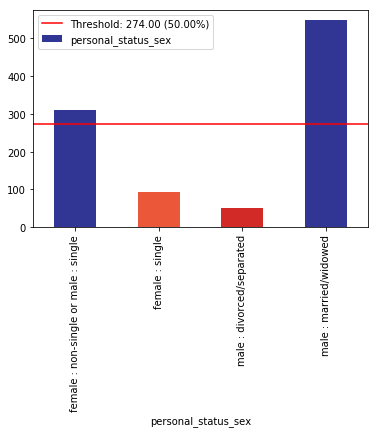

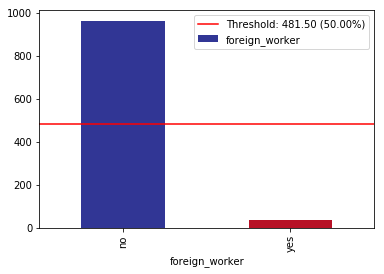

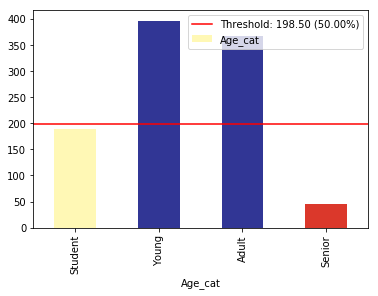

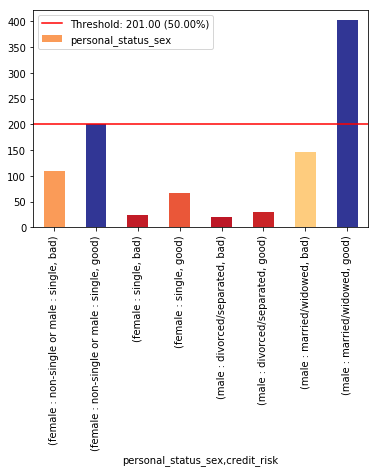

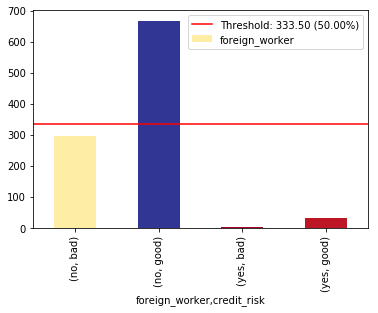

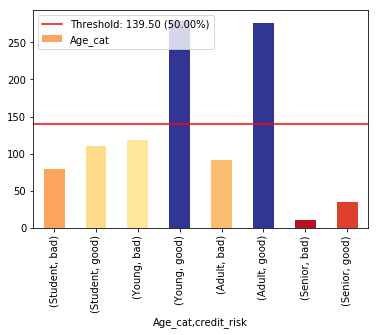

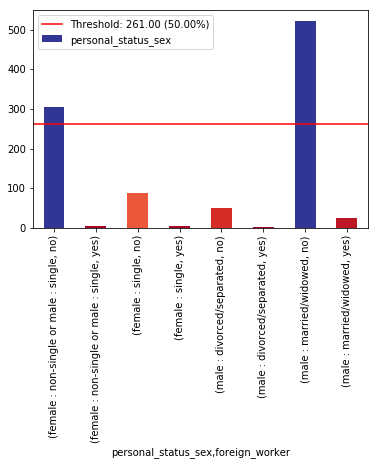

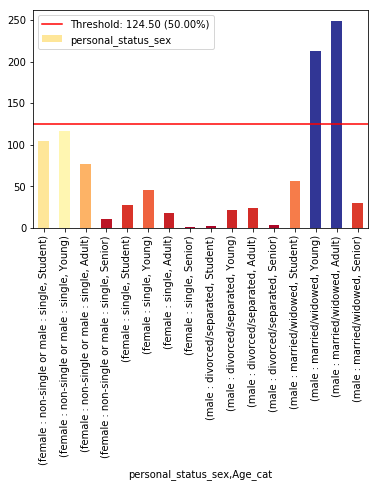

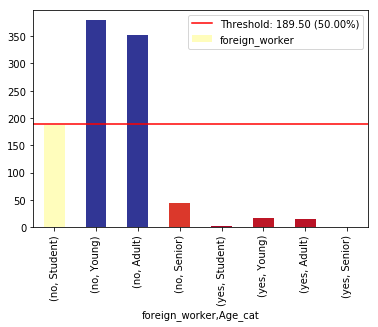

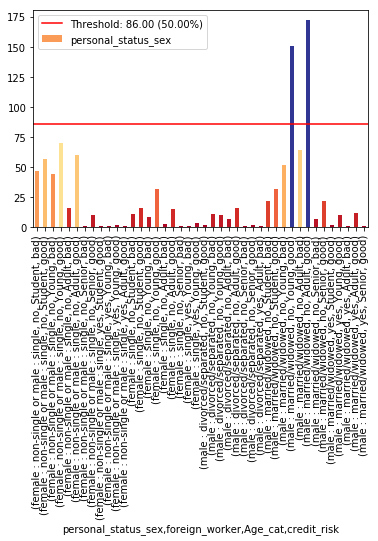

In [155]:
df_groups_0 = xai.imbalance_plot(df, "personal_status_sex", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_1 = xai.imbalance_plot(df, "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_2 = xai.imbalance_plot(df, "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_3 = xai.imbalance_plot(df, "personal_status_sex", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_4 = xai.imbalance_plot(df, "foreign_worker", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_5 = xai.imbalance_plot(df, "Age_cat", "credit_risk",categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_6 = xai.imbalance_plot(df, "personal_status_sex", "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_7 = xai.imbalance_plot(df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

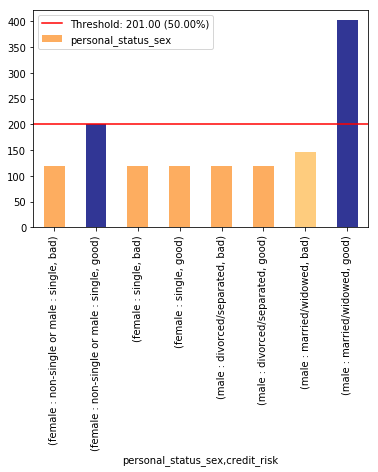

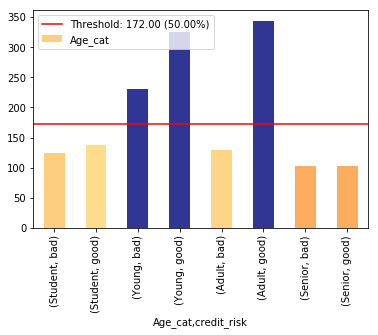

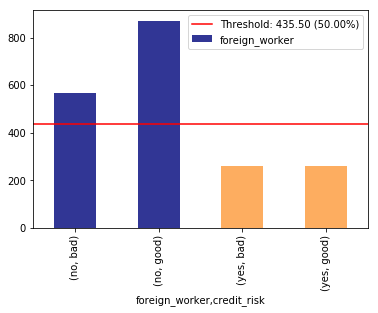

In [156]:
bal_df = df
for cols in protected:
    bal_df = xai.balance(bal_df, cols, 'credit_risk', upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

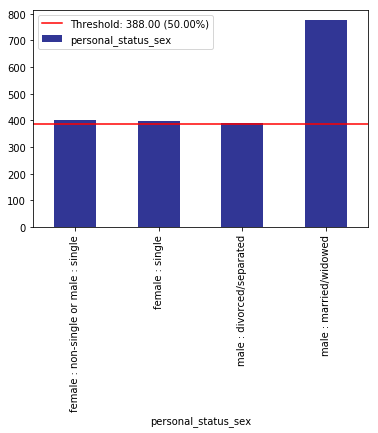

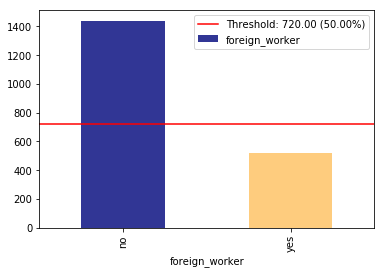

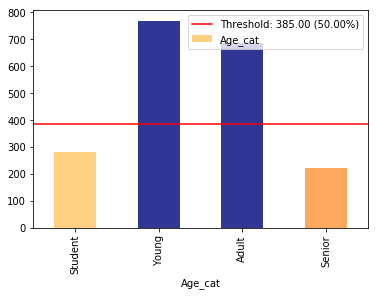

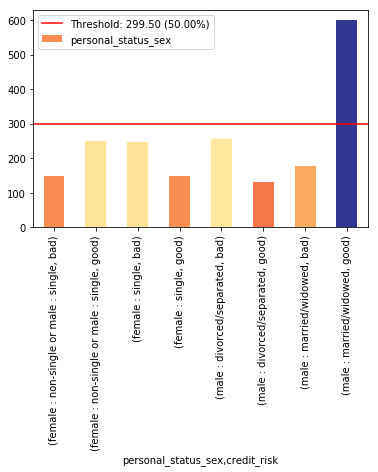

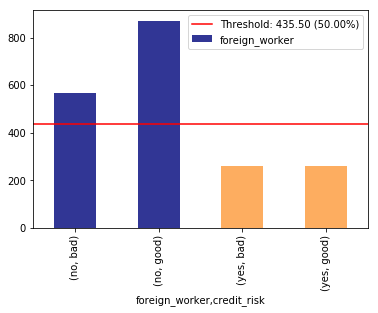

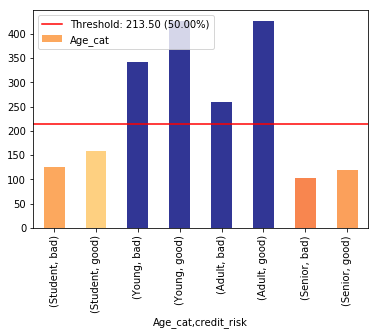

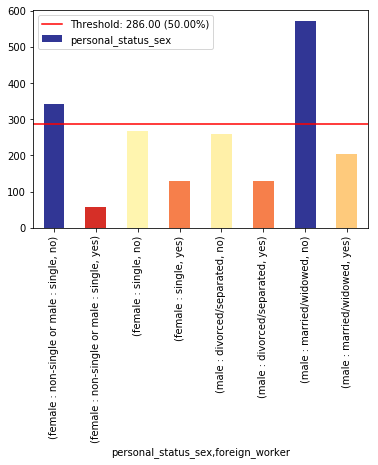

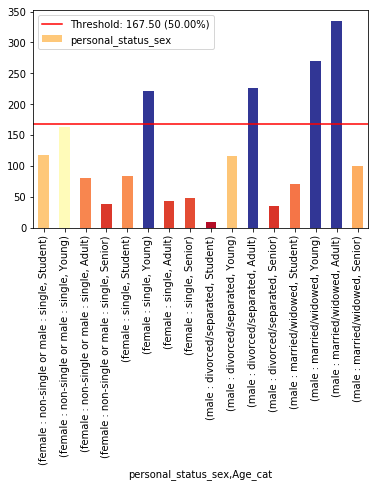

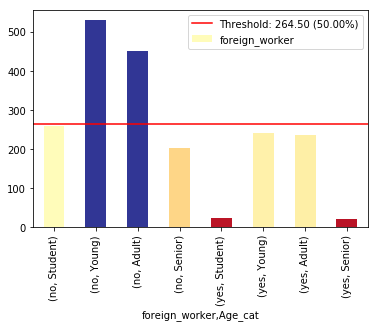

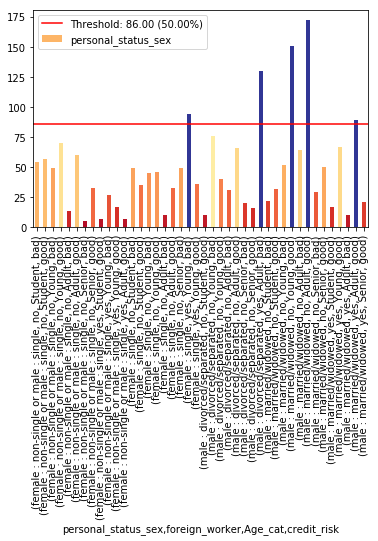

In [157]:
df_groups_0 = xai.imbalance_plot(bal_df, "personal_status_sex", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_1 = xai.imbalance_plot(bal_df, "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_2 = xai.imbalance_plot(bal_df, "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_3 = xai.imbalance_plot(bal_df, "personal_status_sex", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_4 = xai.imbalance_plot(bal_df, "foreign_worker", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_5 = xai.imbalance_plot(bal_df, "Age_cat", "credit_risk",categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_6 = xai.imbalance_plot(bal_df, "personal_status_sex", "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_7 = xai.imbalance_plot(bal_df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(bal_df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(bal_df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

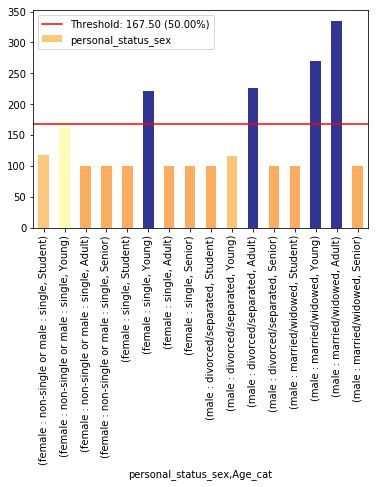

In [158]:
bal_df = xai.balance(bal_df, "personal_status_sex", "Age_cat", upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

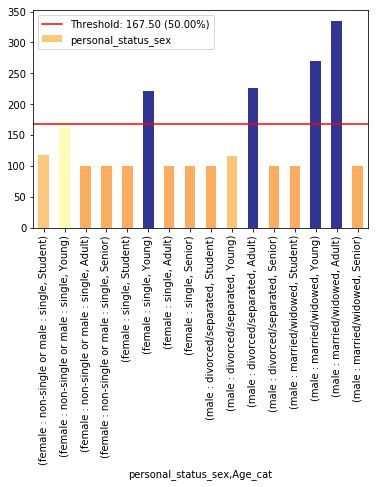

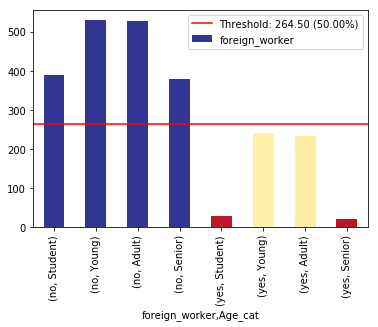

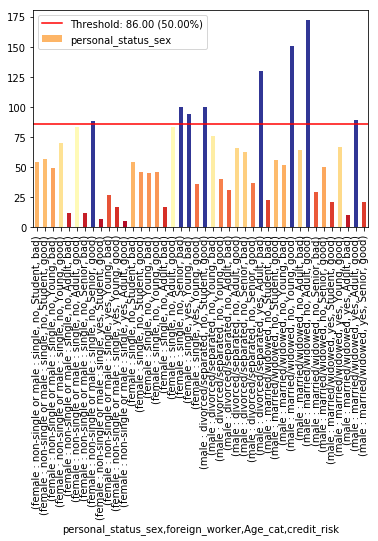

In [159]:
df_groups_7 = xai.imbalance_plot(bal_df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(bal_df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(bal_df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

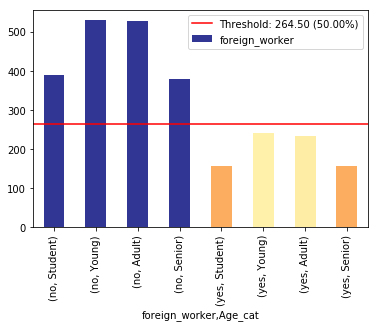

In [160]:
bal_df = xai.balance(bal_df, "foreign_worker", "Age_cat", upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

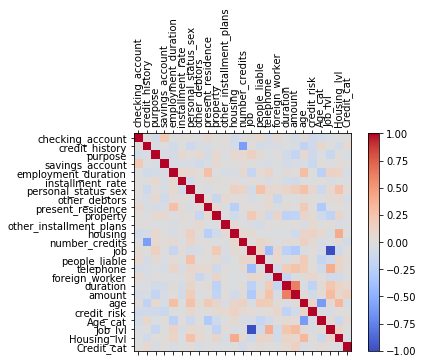

In [161]:
_ = xai.correlations(df, include_categorical=True, plot_type="matrix")

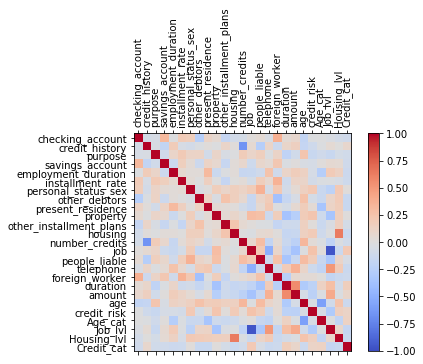

In [162]:
_ = xai.correlations(bal_df, include_categorical=True, plot_type="matrix")

In [163]:
bal_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2617 entries, 0 to 2616
Data columns (total 25 columns):
checking_account           2617 non-null category
credit_history             2617 non-null category
purpose                    2617 non-null category
savings_account            2617 non-null category
employment_duration        2617 non-null category
installment_rate           2617 non-null category
personal_status_sex        2617 non-null category
other_debtors              2617 non-null category
present_residence          2617 non-null category
property                   2617 non-null category
other_installment_plans    2617 non-null category
housing                    2617 non-null category
number_credits             2617 non-null category
job                        2617 non-null category
people_liable              2617 non-null category
telephone                  2617 non-null category
foreign_worker             2617 non-null category
duration                   2617 non-null in

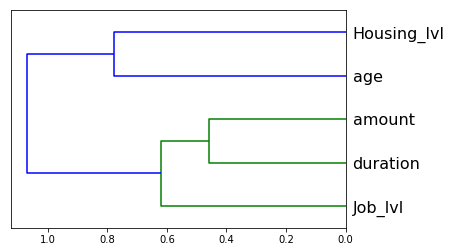

In [164]:
_ = xai.correlations(bal_df, include_categorical=False)

In [165]:
bal_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
1,... < 0 DM,no credits taken/all credits paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,2718,20,bad,Student,1,0,<5k
2,... < 0 DM,no credits taken/all credits paid back duly,car (used),... < 100 DM,1 <= ... < 4 yrs,25 <= ... < 35,female : non-single or male : single,co-applicant,>= 7 yrs,building soc. savings agr./life insurance,bank,for free,1,skilled employee/official,0 to 2,no,no,30,3441,21,bad,Student,2,0,<5k
3,no checking account,no credits taken/all credits paid back duly,others,unknown/no savings account,4 <= ... < 7 yrs,< 20,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,none,for free,2-3,skilled employee/official,0 to 2,no,no,24,1442,23,bad,Student,2,0,<2.5k
4,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,25 <= ... < 35,female : non-single or male : single,co-applicant,1 <= ... < 4 yrs,building soc. savings agr./life insurance,none,for free,2-3,skilled employee/official,0 to 2,no,no,9,1980,19,bad,Student,2,0,<2.5k


In [166]:
bal_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2617 entries, 0 to 2616
Data columns (total 25 columns):
checking_account           2617 non-null category
credit_history             2617 non-null category
purpose                    2617 non-null category
savings_account            2617 non-null category
employment_duration        2617 non-null category
installment_rate           2617 non-null category
personal_status_sex        2617 non-null category
other_debtors              2617 non-null category
present_residence          2617 non-null category
property                   2617 non-null category
other_installment_plans    2617 non-null category
housing                    2617 non-null category
number_credits             2617 non-null category
job                        2617 non-null category
people_liable              2617 non-null category
telephone                  2617 non-null category
foreign_worker             2617 non-null category
duration                   2617 non-null in

In [167]:
# Encode labels in column . 
proc_df = bal_df.copy(deep=True)
proc_df['personal_status_sex'] = label_encoder_personal_status_sex.fit_transform(proc_df['personal_status_sex']) 
proc_df['job'] = label_encoder_job.fit_transform(proc_df['job']) 
proc_df['housing'] = label_encoder_housing.fit_transform(proc_df['housing']) 
proc_df['savings_account'] = label_encoder_savings_account.fit_transform(proc_df['savings_account']) 
proc_df['checking_account'] =label_encoder_checking_account.fit_transform(proc_df['checking_account']) 
proc_df['purpose'] = label_encoder_purpose.fit_transform(proc_df['purpose']) 
#proc_df['credit_risk'] = label_encoder_credit_risk.fit_transform(proc_df['credit_risk'])
proc_df['credit_history'] = label_encoder_credit_history.fit_transform(proc_df['credit_history'])
proc_df['employment_duration'] = label_encoder_employment_duration.fit_transform(proc_df['employment_duration'])
proc_df['installment_rate'] = label_encoder_installment_rate.fit_transform(proc_df['installment_rate'])
proc_df['property'] = label_encoder_property.fit_transform(proc_df['property'])
proc_df['other_installment_plans'] = label_encoder_other_installment_plans.fit_transform(proc_df['other_installment_plans'])
proc_df['number_credits'] = label_encoder_number_credits.fit_transform(proc_df['number_credits'])
proc_df['people_liable'] = label_encoder_people_liable.fit_transform(proc_df['people_liable'])
proc_df['telephone'] = label_encoder_telephone.fit_transform(proc_df['telephone'])
proc_df['foreign_worker'] = label_encoder_foreign_worker.fit_transform(proc_df['foreign_worker'])
proc_df['other_debtors'] = label_encoder_other_debtors.fit_transform(proc_df['other_debtors'])
proc_df['present_residence'] = label_encoder_present_residence.fit_transform(proc_df['present_residence'])

# encoding risk as binary
r = {"good":0, "bad": 1}
proc_df[label]=proc_df[label].map(r)

In [168]:
len(proc_df)

2617

In [169]:
bal_df.head(2)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
1,... < 0 DM,no credits taken/all credits paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,2718,20,bad,Student,1,0,<5k


In [170]:
proc_df.head(2)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,3,4,2,4,2,2,0,2,3,3,1,0,0,3,0,1,0,24,3234,23,1,Student,1,0,<5k
1,0,4,5,4,0,0,0,2,3,1,1,0,0,3,0,1,0,24,2718,20,1,Student,1,0,<5k


In [171]:
n_samples = len(proc_df)
indices = np.arange(n_samples)
#proc_df = xai.normalize_numeric(bal_df)
#proc_df = xai.convert_categories(proc_df)
y = proc_df["credit_risk"]
del proc_df["credit_risk"]
del proc_df["Age_cat"]
del proc_df["Credit_cat"]
del proc_df["Job_lvl"]
del proc_df["Housing_lvl"]

scaler = StandardScaler()
scaler.fit(proc_df)
x = pd.DataFrame(scaler.transform(proc_df),columns = proc_df.columns)

#x_train, y_train, x_test, y_test, train_idx, test_idx = \
#    xai.balanced_train_test_split(
#            x, y, "personal_status_sex", 
#            min_per_group=300,
#            max_per_group=300,
#            categorical_cols=categorical_cols)
# Spliting X and y into train and test version
x_train, x_test, y_train, y_test, train_idx, test_idx = train_test_split(x, y, indices, test_size = 0.25, random_state=seed)

x_train_display = bal_df.iloc[train_idx]
x_test_display = bal_df.iloc[test_idx]

print("Total number of examples: ", x_test.shape[0])

df_test = x_test_display.copy()
df_test["credit_risk"] = y_test
proc_df["credit_risk"] = y

Total number of examples:  655


In [172]:
len(x_test)

655

In [173]:
bal_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
1,... < 0 DM,no credits taken/all credits paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,2718,20,bad,Student,1,0,<5k
2,... < 0 DM,no credits taken/all credits paid back duly,car (used),... < 100 DM,1 <= ... < 4 yrs,25 <= ... < 35,female : non-single or male : single,co-applicant,>= 7 yrs,building soc. savings agr./life insurance,bank,for free,1,skilled employee/official,0 to 2,no,no,30,3441,21,bad,Student,2,0,<5k
3,no checking account,no credits taken/all credits paid back duly,others,unknown/no savings account,4 <= ... < 7 yrs,< 20,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,none,for free,2-3,skilled employee/official,0 to 2,no,no,24,1442,23,bad,Student,2,0,<2.5k
4,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,25 <= ... < 35,female : non-single or male : single,co-applicant,1 <= ... < 4 yrs,building soc. savings agr./life insurance,none,for free,2-3,skilled employee/official,0 to 2,no,no,9,1980,19,bad,Student,2,0,<2.5k


In [174]:
proc_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,3,4,2,4,2,2,0,2,3,3,1,0,0,3,0,1,0,24,3234,23,1
1,0,4,5,4,0,0,0,2,3,1,1,0,0,3,0,1,0,24,2718,20,1
2,0,4,2,0,0,1,0,0,3,0,0,0,0,1,0,0,0,30,3441,21,1
3,3,4,5,4,1,2,0,2,3,0,1,0,1,1,0,0,0,24,1442,23,1
4,1,4,2,4,2,1,0,0,0,0,1,0,1,1,0,0,0,9,1980,19,1


In [175]:
x.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,1.152787,0.871561,-1.085531,0.676875,0.481251,0.309959,-1.561399,0.427788,1.142918,1.238282,0.193830,-1.892537,-0.780915,1.572411,-0.440944,1.484312,-0.65817,0.513292,0.002114,-1.098887
1,-1.298603,0.871561,0.440706,0.676875,-0.995225,-1.707856,-1.561399,0.427788,1.142918,-0.451723,0.193830,-1.892537,-0.780915,1.572411,-0.440944,1.484312,-0.65817,0.513292,-0.164736,-1.288399
2,-1.298603,0.871561,-1.085531,-2.058851,-0.995225,-0.698949,-1.561399,-2.964702,1.142918,-1.296725,-1.992604,-1.892537,-0.780915,-0.408335,-0.440944,-0.673713,-0.65817,1.075454,0.069048,-1.225228
3,1.152787,0.871561,0.440706,0.676875,-0.256987,0.309959,-1.561399,0.427788,1.142918,-1.296725,0.193830,-1.892537,0.754513,-0.408335,-0.440944,-0.673713,-0.65817,0.513292,-0.577335,-1.098887
4,-0.481473,0.871561,-1.085531,0.676875,0.481251,-0.698949,-1.561399,-2.964702,-1.288144,-1.296725,0.193830,-1.892537,0.754513,-0.408335,-0.440944,-0.673713,-0.65817,-0.892112,-0.403371,-1.351570


In [176]:
#proc_df.info()
#ordinal_cols = ['Age','Credit amount','Duration']
#categorical_cols = ['Sex', 'Job' ,'Housing' ,'Saving accounts','Checking account','Purpose']
protected_cols = ['age','personal_status_sex','foreign_worker']

In [177]:
x_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1962 entries, 940 to 860
Data columns (total 20 columns):
checking_account           1962 non-null float64
credit_history             1962 non-null float64
purpose                    1962 non-null float64
savings_account            1962 non-null float64
employment_duration        1962 non-null float64
installment_rate           1962 non-null float64
personal_status_sex        1962 non-null float64
other_debtors              1962 non-null float64
present_residence          1962 non-null float64
property                   1962 non-null float64
other_installment_plans    1962 non-null float64
housing                    1962 non-null float64
number_credits             1962 non-null float64
job                        1962 non-null float64
people_liable              1962 non-null float64
telephone                  1962 non-null float64
foreign_worker             1962 non-null float64
duration                   1962 non-null float64
amount    

In [178]:
x_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 655 entries, 2576 to 174
Data columns (total 20 columns):
checking_account           655 non-null float64
credit_history             655 non-null float64
purpose                    655 non-null float64
savings_account            655 non-null float64
employment_duration        655 non-null float64
installment_rate           655 non-null float64
personal_status_sex        655 non-null float64
other_debtors              655 non-null float64
present_residence          655 non-null float64
property                   655 non-null float64
other_installment_plans    655 non-null float64
housing                    655 non-null float64
number_credits             655 non-null float64
job                        655 non-null float64
people_liable              655 non-null float64
telephone                  655 non-null float64
foreign_worker             655 non-null float64
duration                   655 non-null float64
amount                     6

In [179]:
ts = TrustScore(alpha=.05,
                filter_type='distance_knn',
                k_filter=10,
                leaf_size=40,
                metric='euclidean',
                dist_filter_type='point')

In [180]:
ts.fit(x.values, y, classes=2)

In [181]:
limeExplainer = lime.lime_tabular.LimeTabularExplainer(x.values,
                              feature_names=x.columns.values.tolist(),
                              class_names=['credit_risk'],
                              categorical_features=categorical_cols,
                              verbose=True,
                              mode='regression')

In [182]:
RF_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 10, None],
                         'max_features': [4, 7, 9, 12, 15, 20],
                         'n_estimators': [3, 5, 10, 25, 50, 150]},
             scoring='accuracy', verbose=4)

In [183]:
print(RF_grid_search.best_params_)

{'max_depth': None, 'max_features': 7, 'n_estimators': 150}


In [184]:
RF = RF_grid_search.best_estimator_
#RF = model_RF.best_estimator_
RF

RandomForestClassifier(max_features=7, n_estimators=150, random_state=42)

Model 1 Predictive Accuracy

In [185]:
#Testing the model 
#Predicting using our  model
y_pred_RF = RF.predict(x_test)

# Verificaar os resultados obtidos
print(accuracy_score(y_test,y_pred_RF)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_RF))
print("\n")
print(fbeta_score(y_test, y_pred_RF, beta=2))
print("\n")
print(classification_report(y_test, y_pred_RF))

92.67175572519083
 percent


[[411   9]
 [ 39 196]]


0.8558951965065502


              precision    recall  f1-score   support

           0       0.91      0.98      0.94       420
           1       0.96      0.83      0.89       235

    accuracy                           0.93       655
   macro avg       0.93      0.91      0.92       655
weighted avg       0.93      0.93      0.93       655



In [186]:
print("Actual # : ",len(y_pred_RF)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


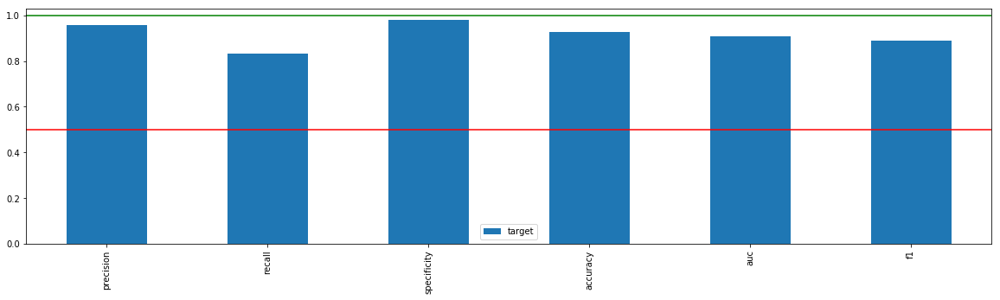

In [187]:
_= xai.metrics_plot(y_test,y_pred_RF)

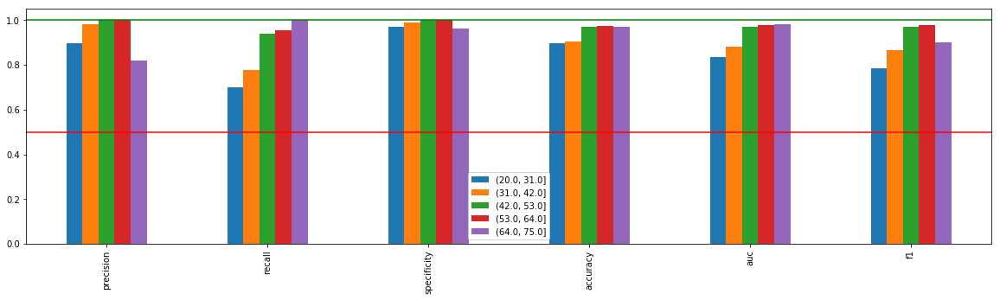

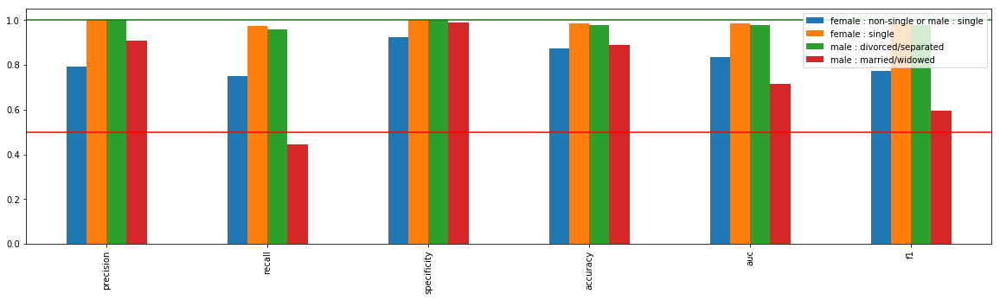

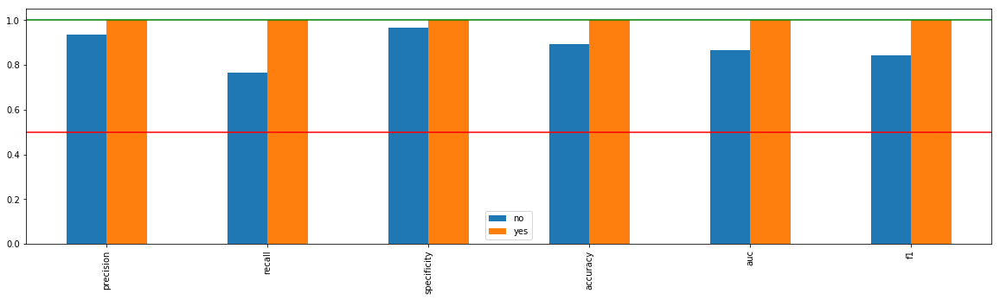

In [188]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_RF, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Model 1 Descriptive Accuracy and Relevance

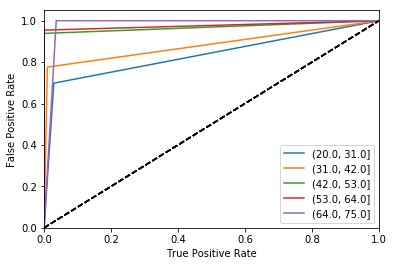

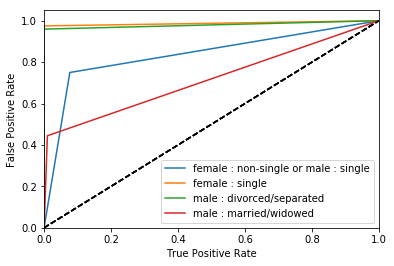

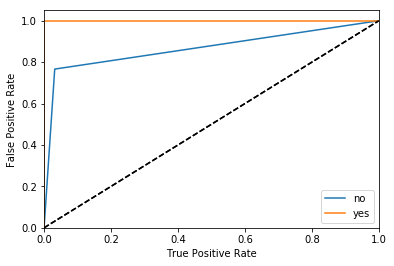

In [189]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_RF, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]


Model 1 RF Feature level explainations

In [190]:
#perm_RF = PermutationImportance(RF, random_state=seed).fit(x,y)
#eli5.show_weights(perm_RF, feature_names = x.columns.tolist())


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.022468,0.003898,0.01689,0.00428,-0.000535,0.000459,0.016775,0.000382,0.001376,0.009859,0.000497,0.003974,0.000076,0.001185,0.000497,0.000115,0.006763,0.01838,0.018838,0.016966


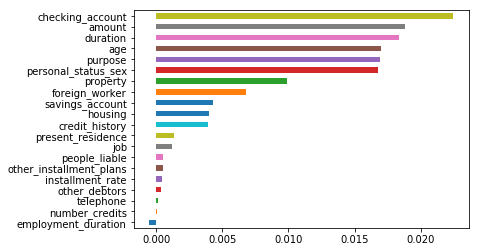

In [191]:
def get_avg(x, y):
    return accuracy_score(RF.predict(x), y)

imp1 = xai.feature_importance(x, y,get_avg)
imp1.head()

Model 1 RF Global Explainations

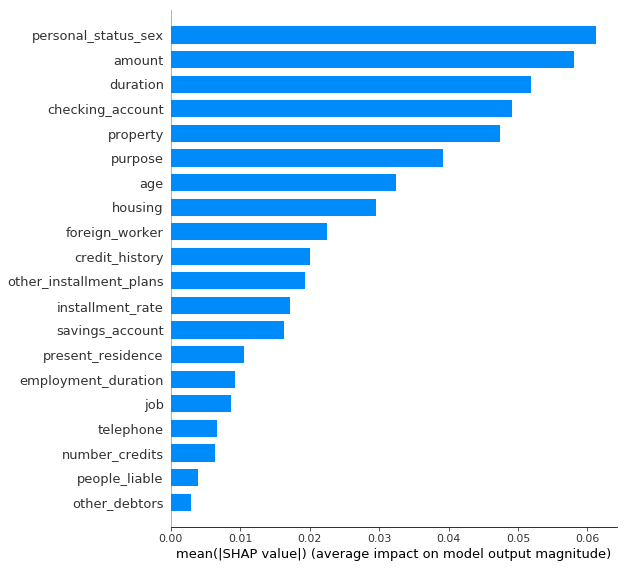

In [192]:
RF_explainer =  shap.TreeExplainer(RF)
RF_shap_values = RF_explainer.shap_values(x)
shap.summary_plot(RF_shap_values[1], x,plot_type="bar")

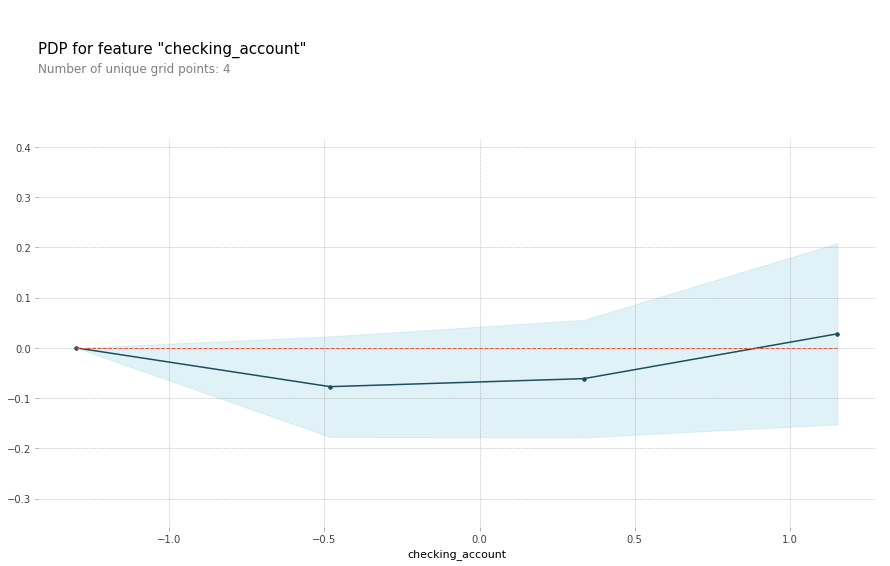

In [193]:
# Create the data that we will plot
pdp_CheckingAccount_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_RF, 'checking_account')
plt.show()

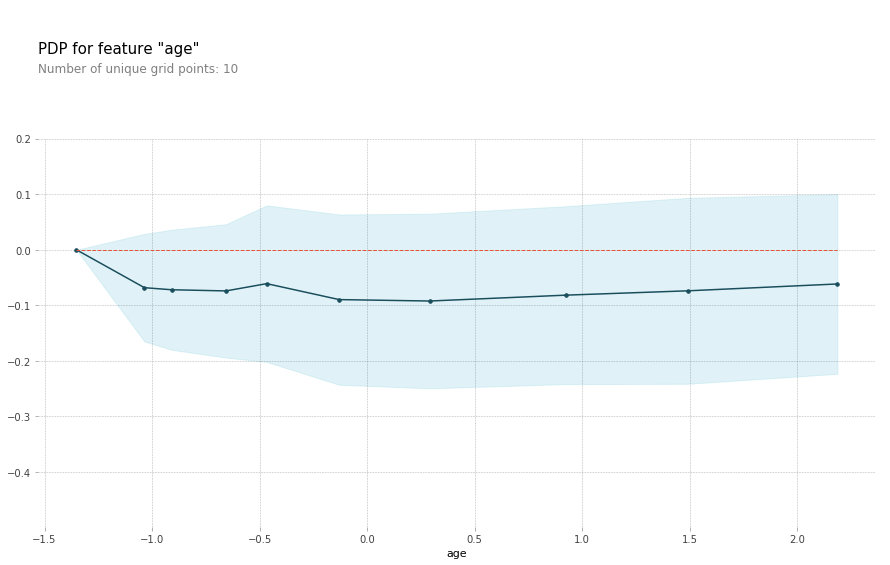

In [194]:
# Create the data that we will plot
pdp_Age_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_RF, 'age')
plt.show()

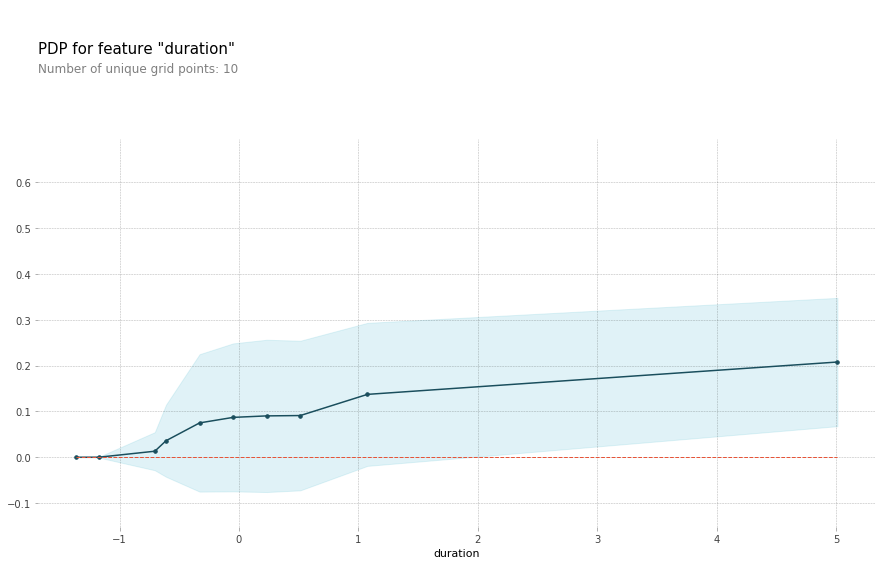

In [195]:
# Create the data that we will plot
pdp_Duration_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_RF, 'duration')
plt.show()

In [196]:
# Similar to previous PDP plot except we use pdp_interact instead of pdp_isolate and pdp_interact_plot instead of pdp_isolate_plot
interRF  =  pdp.pdp_interact(model=RF, dataset=x, model_features=x.columns, features=protected_cols)

#pdp.pdp_interact_plot(pdp_interact_out=interRF, feature_names=['Risk','Age'], plot_type='contour')
#plt.show()

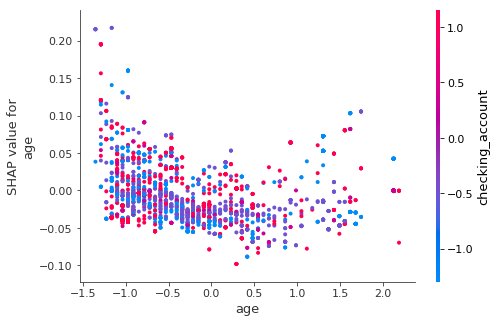

In [197]:
# make plot.
shap.dependence_plot('age', RF_shap_values[1], x)

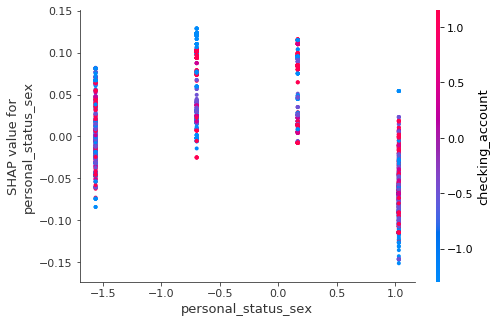

In [198]:
# make plot.
shap.dependence_plot('personal_status_sex', RF_shap_values[1], x, interaction_index='checking_account')

In [199]:
RF_explainer.expected_value

array([0.64075773, 0.35924227])

In [200]:
len(RF_shap_values[0])

2617

In [201]:
RF_shap_values[1]

array([[ 0.09397463,  0.01949717, -0.0259545 , ...,  0.0466598 ,
        -0.01710981,  0.03416696],
       [ 0.02007675,  0.0133183 ,  0.06149959, ...,  0.06157218,
         0.00851201,  0.11813564],
       [ 0.04927782,  0.01591174,  0.01524156, ...,  0.07868928,
        -0.02747424,  0.09206189],
       ...,
       [-0.0224736 , -0.0314816 ,  0.01146904, ..., -0.08447757,
        -0.03453381, -0.00032139],
       [-0.0224736 , -0.0314816 ,  0.01146904, ..., -0.08447757,
        -0.03453381, -0.00032139],
       [-0.0224736 , -0.0314816 ,  0.01146904, ..., -0.08447757,
        -0.03453381, -0.00032139]])

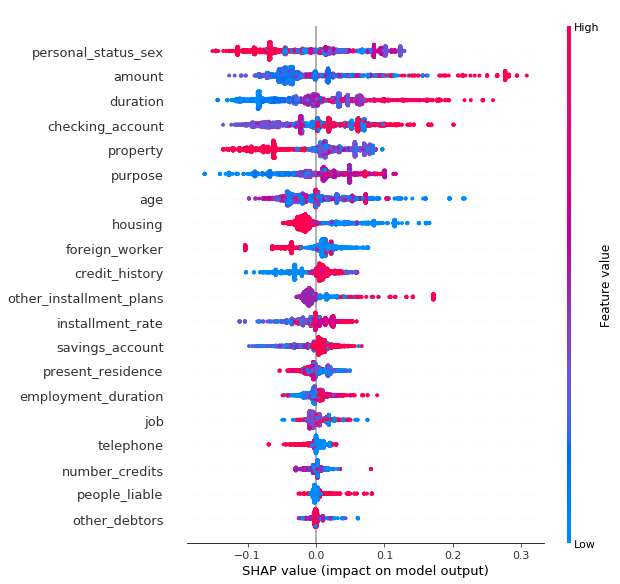

In [202]:
shap.summary_plot(RF_shap_values[1], x)

In [203]:
idx = 7
shap.initjs()
shap.force_plot(RF_explainer.expected_value[0], RF_shap_values[0][idx], features=x.columns)

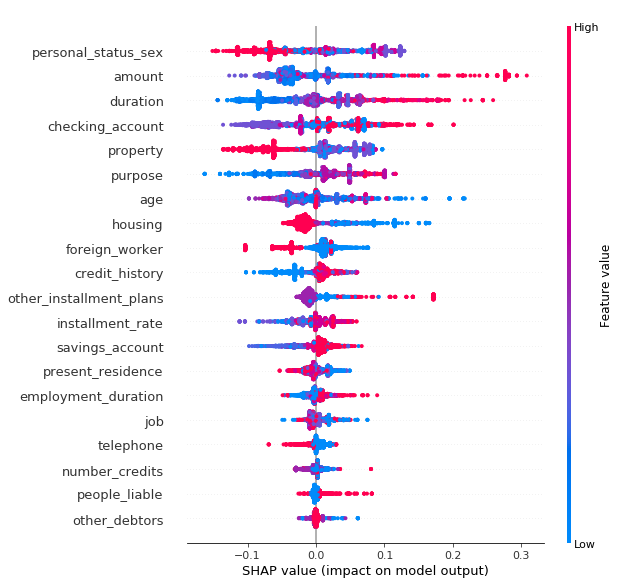

In [204]:
shap.summary_plot(RF_shap_values[1], x)

In [205]:
shap.force_plot(RF_explainer.expected_value[1], RF_shap_values[1][idx], features=x.columns)

In [206]:
test_idx = 5
predict_fn_RF = lambda a: RF.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [207]:
y_pred_RF = predict_fn_RF(x_test)
#y_pred_RF

In [208]:
expRF = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_RF,num_features=20)

Intercept 0.06694396931576524
Prediction_local [0.30234049]
Right: 1


In [209]:
expRF.show_in_notebook(show_table=True)

In [210]:
scoreRF, closest_classRF = ts.score(x_test,
                                y_pred_RF,
                                k=2,
                                dist_type='point')

In [211]:
#scoreRF, closest_classRF

Model 2: GNB

In [212]:
GNB_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=GaussianNB(), n_jobs=-1,
             param_grid={'priors': [None],
                         'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             scoring='accuracy', verbose=4)

In [213]:
GNB_grid_search.best_params_

{'priors': None, 'var_smoothing': 0.533669923120631}

In [214]:
GNB_grid_search.best_score_

0.752822956593805

In [215]:
GNB = GNB_grid_search.best_estimator_
#GNB = model_GNB.best_estimator_
GNB

GaussianNB(var_smoothing=0.533669923120631)

In [216]:
# Printing the Training Score
print("Training score data: ")
print(GNB.score(x_train, y_train))

Training score data: 
0.7533129459734964


In [217]:
y_pred_gnb = GNB.predict(x_test)
#y_pred_gnb = np.array([1 if a >= 0.5 else 0 for a in y_pred_gnb])
print(accuracy_score(y_test,y_pred_gnb)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_gnb))
print("\n")
print(classification_report(y_test, y_pred_gnb))

77.09923664122137
 percent


[[342  78]
 [ 72 163]]


              precision    recall  f1-score   support

           0       0.83      0.81      0.82       420
           1       0.68      0.69      0.68       235

    accuracy                           0.77       655
   macro avg       0.75      0.75      0.75       655
weighted avg       0.77      0.77      0.77       655



In [218]:
print("Actual # : ",len(y_pred_gnb)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


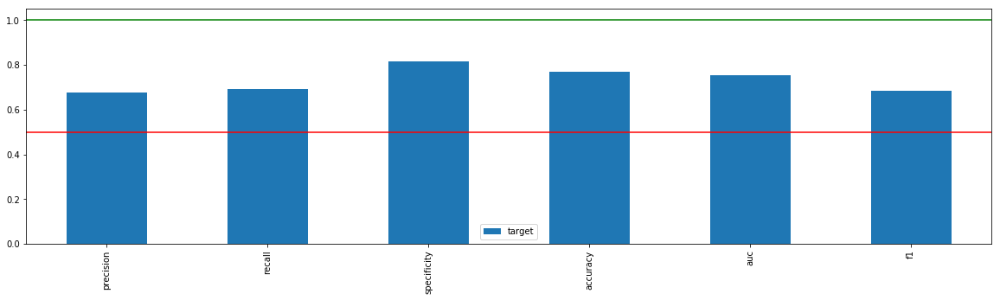

In [219]:
_= xai.metrics_plot(y_test,y_pred_gnb)

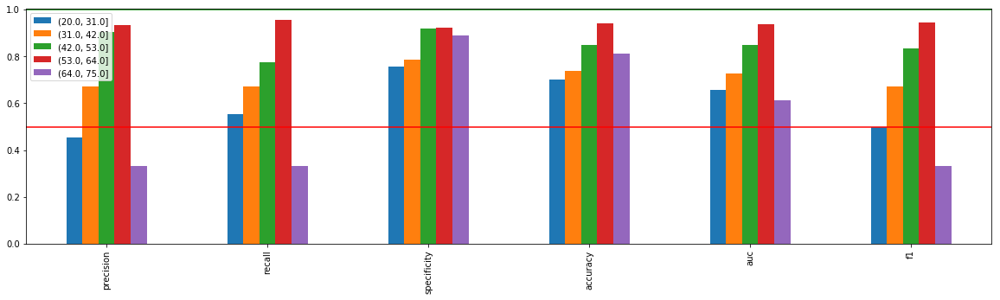

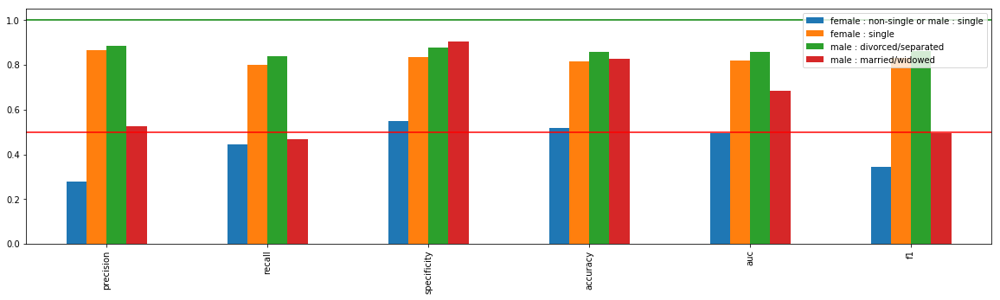

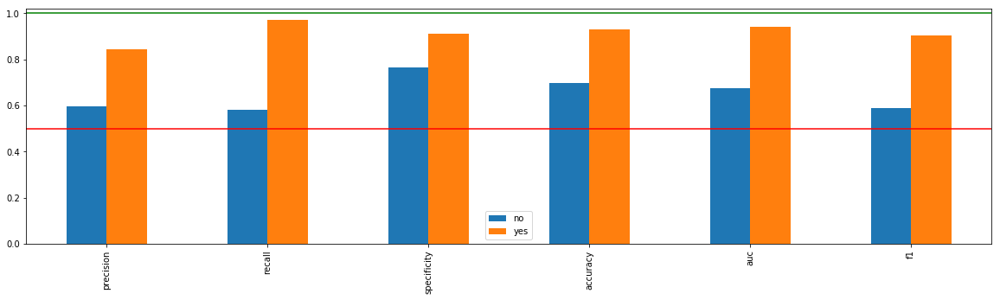

In [220]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_gnb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

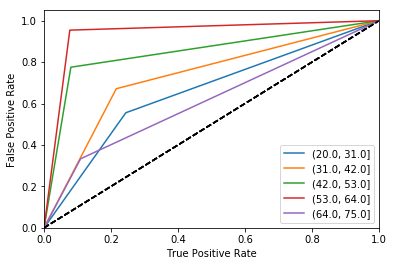

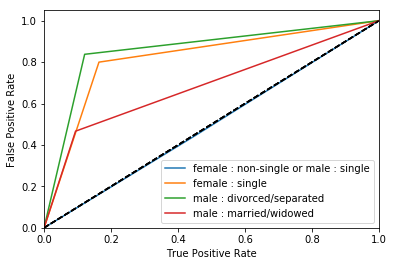

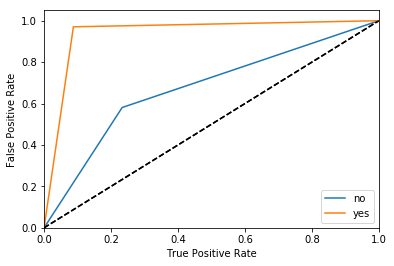

In [221]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_gnb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [222]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [223]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

Model 2 GNB Feature level explainations

In [224]:
#perm_GNB = PermutationImportance(GNB, random_state=seed).fit(x,y)
#eli5.show_weights(perm_GNB, feature_names = x.columns.tolist())

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.001261,0.019908,0.005655,0.002216,-0.003019,0.002102,0.034314,0.007069,0.000153,0.033894,0.06538,0.045434,0.007451,0.011043,0.006572,-0.011846,-0.000764,0.00321,0.007489,0.00107


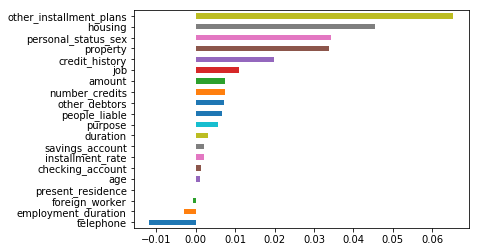

In [225]:
def get_avg_gnb(x, y):
    return accuracy_score(GNB.predict(x), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_gnb)
imp2.head()

In [226]:
GNB_explainer =  shap.PermutationExplainer(GNB.predict,x)
GNB_shap_values = GNB_explainer.shap_values(x.values,npermutations=5)
#shap.summary_plot(GNB_shap_values.data, x.values, plot_type="bar", features = x.columns)

Permutation explainer: 2618it [00:30, 85.80it/s]                          


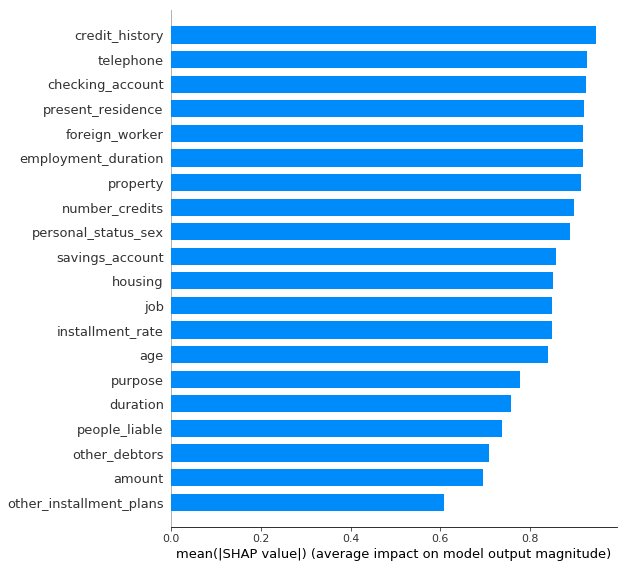

In [227]:
shap.summary_plot(GNB_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

In [228]:
GNB_shap_values

.values =
array([[ 0.01 ,  0.035, -0.035, ..., -0.015, -0.04 , -0.02 ],
       [ 0.01 ,  0.19 , -0.005, ...,  0.25 , -0.05 , -0.085],
       [ 0.025,  0.035, -0.05 , ...,  0.12 , -0.035, -0.005],
       ...,
       [ 0.   , -0.08 ,  0.   , ..., -0.065, -0.01 ,  0.   ],
       [ 0.   , -0.085,  0.   , ..., -0.01 , -0.025,  0.   ],
       [ 0.   , -0.025,  0.   , ...,  0.   , -0.03 ,  0.   ]])

.base_values =
array([0.35, 0.35, 0.35, ..., 0.35, 0.35, 0.35])

.data =
array([[ 1.15278719e+00,  8.71560860e-01, -1.08553142e+00, ...,
         5.13291991e-01,  2.11409087e-03, -1.09888680e+00],
       [-1.29860291e+00,  8.71560860e-01,  4.40705539e-01, ...,
         5.13291991e-01, -1.64736237e-01, -1.28839915e+00],
       [-1.29860291e+00,  8.71560860e-01, -1.08553142e+00, ...,
         1.07545359e+00,  6.90482341e-02, -1.22522837e+00],
       ...,
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00],
       [ 3.35657160e-01

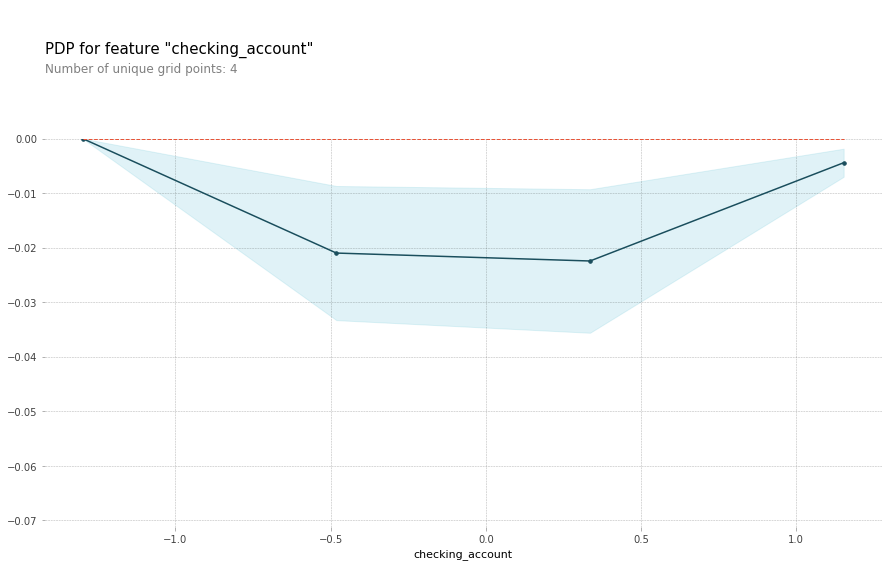

In [229]:
# Create the data that we will plot
pdp_CheckingAccount_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_GNB, 'checking_account')
plt.show()

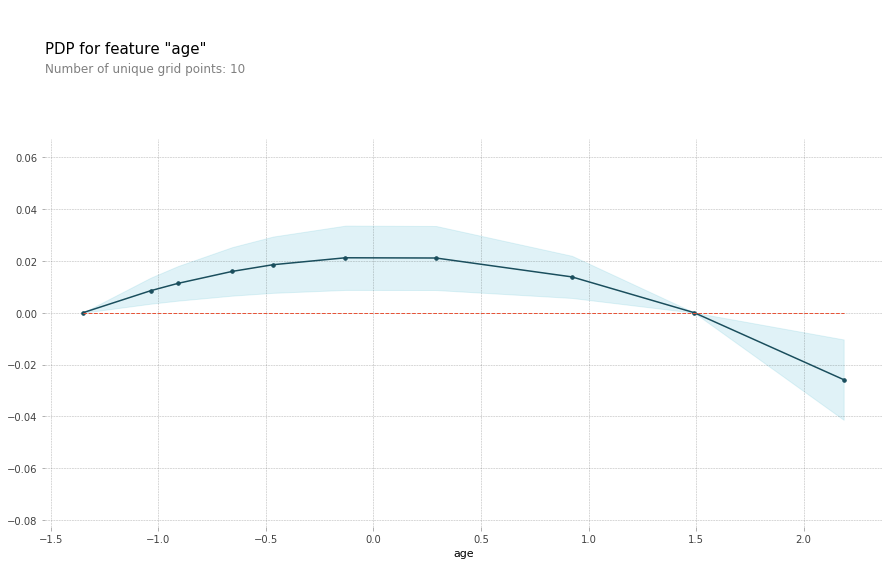

In [230]:
# Create the data that we will plot
pdp_Age_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_GNB, 'age')
plt.show()

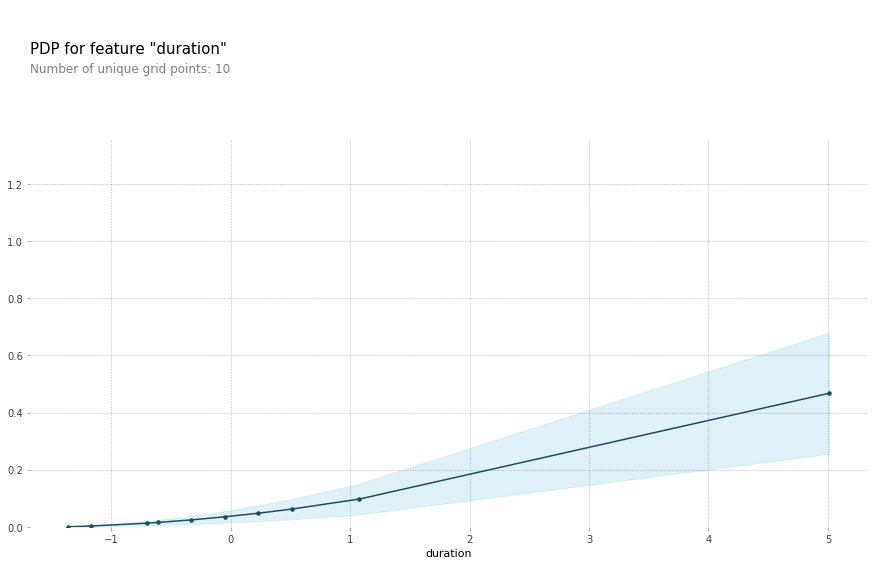

In [231]:
# Create the data that we will plot
pdp_Duration_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_GNB, 'duration')
plt.show()

In [232]:
#GNB_explainer.expected_value

In [233]:
idx = 7
shap.initjs()
shap.force_plot(GNB_shap_values.base_values[0], GNB_shap_values.data[idx], features=x_train.columns)

In [234]:
test_idx = 5
predict_fn_GNB = lambda a: GNB.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [235]:
y_pred_GNB = GNB.predict(x_test)
y_pred_GNB

array([0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1,
       1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1,
       1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1,

In [236]:
expGNB = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_GNB,num_features=20)

Intercept -0.09140951238965395
Prediction_local [1.11902284]
Right: 1


In [237]:
expGNB.show_in_notebook(show_table=True)

In [238]:
scoreGNB, closest_classGNB = ts.score(x_test,
                                y_pred_GNB,
                                k=2,
                                dist_type='point')

In [239]:
#scoreGNB, closest_classGNB

Model 3: XG Boost

In [240]:
XG_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 1620 candidates, totalling 16200 fits


KeyboardInterrupt: ignored

In [ ]:
XG_grid_search.best_score_

In [ ]:
XG_grid_search.best_params_

In [ ]:
#xGB = XG_grid_search.best_estimator_
xGB = model_XG
xGB

In [ ]:
# Printing the Training Score
print("Training score data: ")
print(xGB.score(x_train, y_train))

In [ ]:
y_pred_xgb = xGB.predict(x_test)
y_pred_xgb = np.array([1 if a >= 0.5 else 0 for a in y_pred_xgb])

print(accuracy_score(y_test,y_pred_xgb)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_xgb))
print("\n")
print(classification_report(y_test, y_pred_xgb))

In [ ]:
print("Actual # : ",len(y_pred_xgb)," Successfully Predicted # :",len(y_test))

In [ ]:
_= xai.metrics_plot(y_test,y_pred_xgb)

In [ ]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_xgb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [ ]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_xgb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [ ]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [ ]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [ ]:
#perm_xGB = PermutationImportance(xGB, random_state=seed).fit(x,y)
#eli5.show_weights(perm_xGB, feature_names = x.columns.tolist())

In [ ]:
def get_avg_xgb(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in xGB.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_xgb)
imp2.head()

In [ ]:
xGB_explainer =  shap.TreeExplainer(xGB)
xGB_shap_values = xGB_explainer.shap_values(x)
shap.summary_plot(xGB_shap_values, x, plot_type="bar")

In [ ]:
# Create the data that we will plot
pdp_CheckingAccount_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_xGB, 'checking_account')
plt.show()

In [ ]:

# Create the data that we will plot
pdp_Age_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_xGB, 'age')
plt.show()

In [ ]:
# Create the data that we will plot
pdp_Duration_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_xGB, 'duration')
plt.show()

In [ ]:
shap.summary_plot(xGB_shap_values, x)

In [ ]:
xGB_shap_values

In [ ]:
xGB_explainer.expected_value

In [ ]:
idx = 7
shap.initjs()
shap.force_plot(xGB_explainer.expected_value, xGB_shap_values[idx], features=x_train.columns)

In [ ]:
predict_lambda_xGB = lambda x: xGB.predict(pd.DataFrame(x).rename(columns={0 : 'checking_account',1 : 'credit_history',2 : 'purpose',3 : 'savings_account',4 : 'employment_duration',5 : 'installment_rate',6 : 'personal_status_sex',7 : 'other_debtors',8 : 'present_residence',9 : 'property',10 : 'other_installment_plans',11 : 'housing',12 : 'number_credits',13 : 'job',14 : 'people_liable',15 : 'telephone',16 : 'foreign_worker',17 : 'duration',18 : 'amount',19 : 'age'}))
predict_fn_xGB = lambda x: np.array([1 if a > 0.5 else 0 for a in predict_lambda_xGB(x)]).astype('int8')
                                                                                   
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
x_test.iloc[test_idx]

In [ ]:
y_pred_xGB = predict_fn_xGB(x_test)
y_pred_xGB

In [ ]:
expxGB = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_xGB, num_features=20)

In [ ]:
expxGB.show_in_notebook(show_table=True)

In [ ]:
score_xGB, closest_class_xGB = ts.score(x_test,
                                y_pred_xGB,
                                k=2,
                                dist_type='point')

In [ ]:
#score_xGB, closest_class_xGB

Model 4 : KNN

In [242]:
KNN_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 8 candidates, totalling 80 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['manhattan'], 'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)

In [243]:
KNN_grid_search.best_score_

0.9230731378845954

In [244]:
KNN_grid_search.best_params_

{'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'distance'}

In [245]:
#KNN = KNN_grid_search.best_estimator_
KNN = model_KNN.best_estimator_
#KNN

In [246]:
# Printing the Training Score
print("Training score data: ")
print(KNN.score(x_train, y_train))

Training score data: 
0.6722731906218145


In [247]:
y_pred_knn = KNN.predict(x_test)

print(accuracy_score(y_test,y_pred_knn)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_knn))
print("\n")
print(classification_report(y_test, y_pred_knn))

68.85496183206106
 percent


[[377  43]
 [161  74]]


              precision    recall  f1-score   support

           0       0.70      0.90      0.79       420
           1       0.63      0.31      0.42       235

    accuracy                           0.69       655
   macro avg       0.67      0.61      0.60       655
weighted avg       0.68      0.69      0.66       655



In [248]:
print("Actual # : ",len(y_pred_knn)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


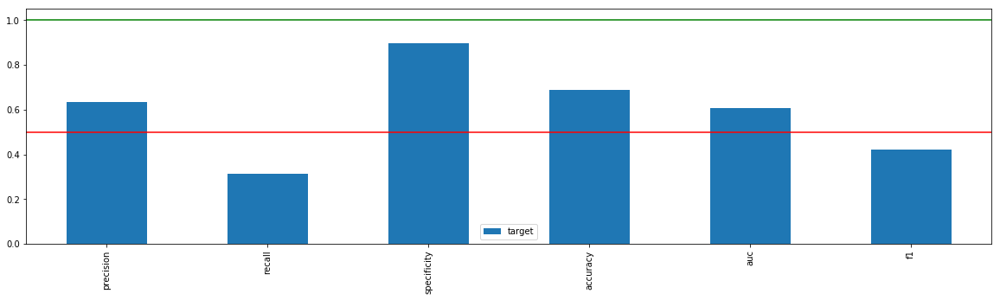

In [249]:
_= xai.metrics_plot(y_test,y_pred_knn)

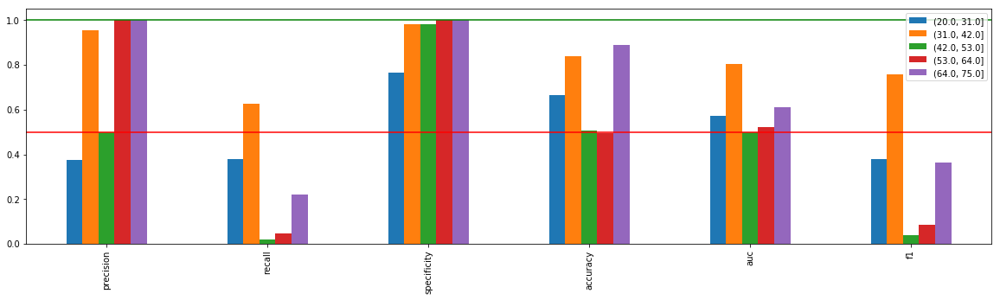

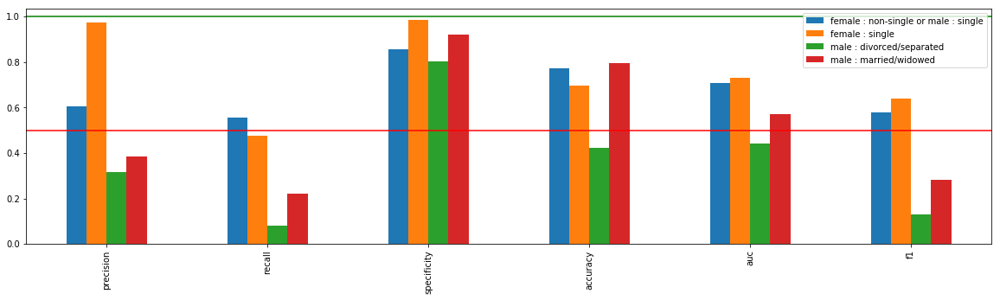

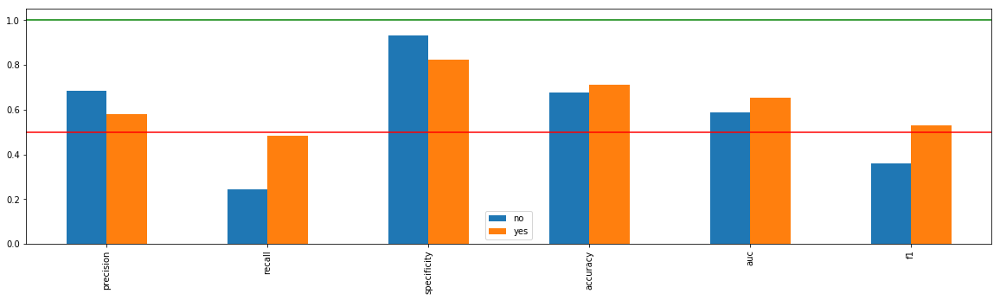

In [250]:

_ = [xai.metrics_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female] Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

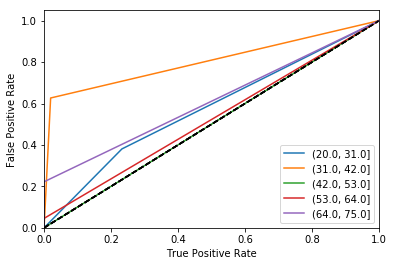

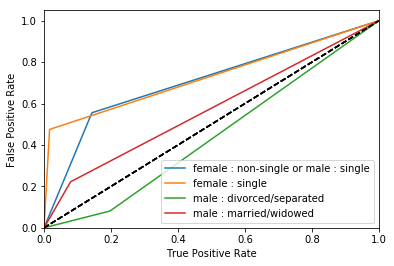

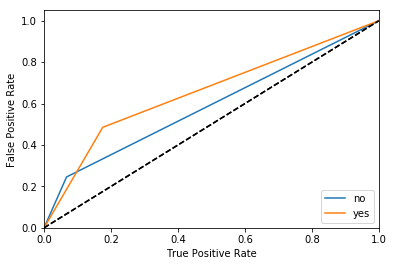

In [251]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [252]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [253]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [254]:
#perm_KNN = PermutationImportance(KNN, random_state=seed).fit(x,y)
#eli5.show_weights(perm_KNN, feature_names = x.columns.tolist())

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.007337,-0.008254,0.002637,-0.003859,0.000802,-0.014329,-0.008712,-0.026825,-0.01089,-0.000841,0.016431,0.019182,-0.012839,-0.013336,-0.005426,-0.00898,0.0,-0.009018,0.014635,-0.010852


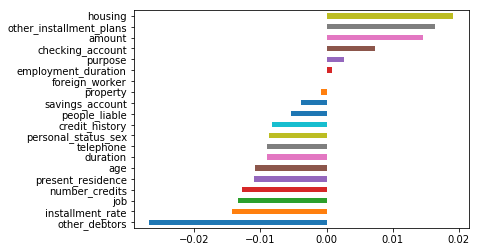

In [255]:
def get_avg_knn(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in KNN.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_knn)
imp2.head()

In [256]:
KNN_explainer =  shap.PermutationExplainer(KNN.predict,x)
KNN_shap_values = KNN_explainer.shap_values(x.values,npermutations=5)
#shap.summary_plot(KNN_shap_values.data, x.values, plot_type="bar", feature = x.columns)

Permutation explainer: 2618it [11:56,  3.65it/s]


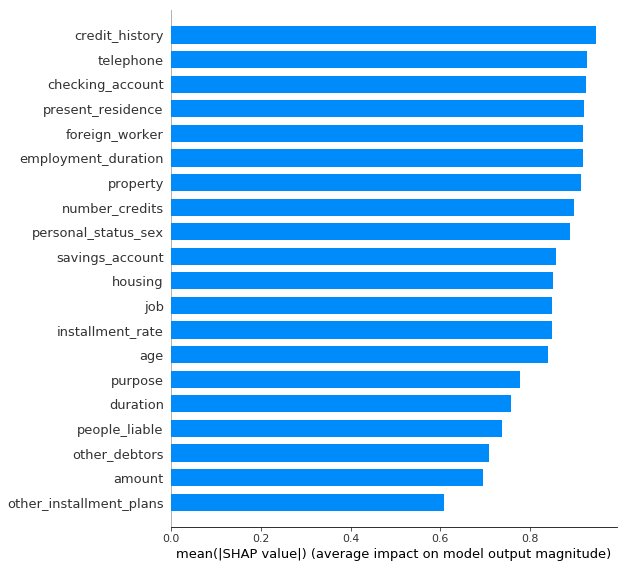

In [257]:
shap.summary_plot(KNN_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

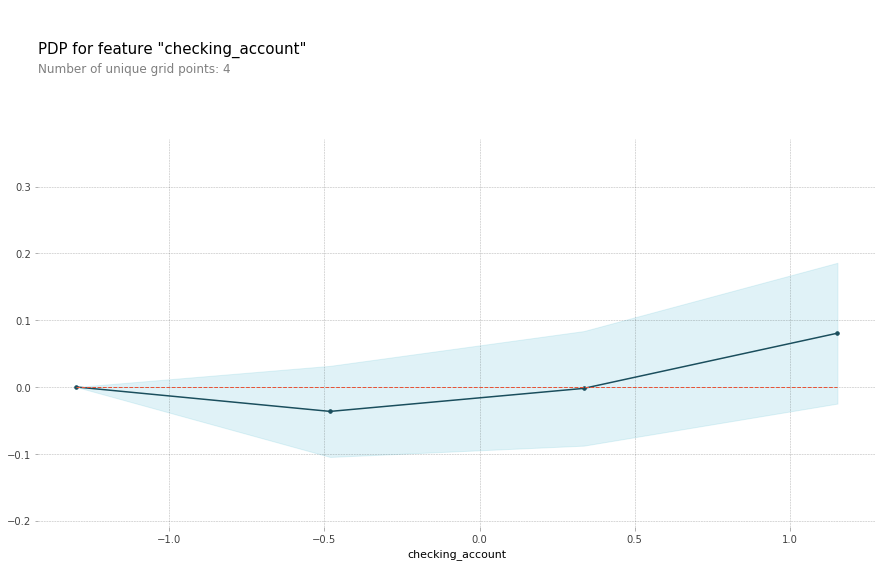

In [258]:
# Create the data that we will plot
pdp_CheckingAccount_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_KNN, 'checking_account')
plt.show()

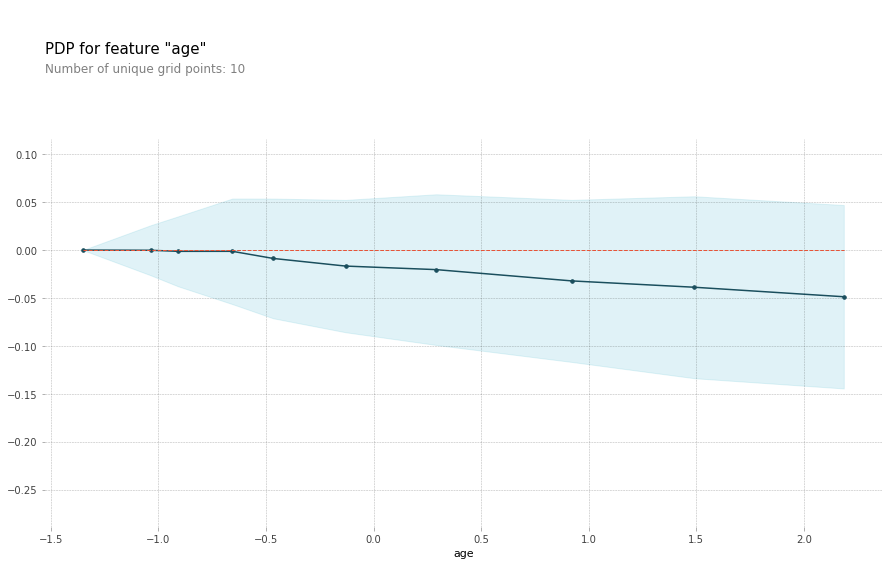

In [259]:
# Create the data that we will plot
pdp_Age_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_KNN, 'age')
plt.show()

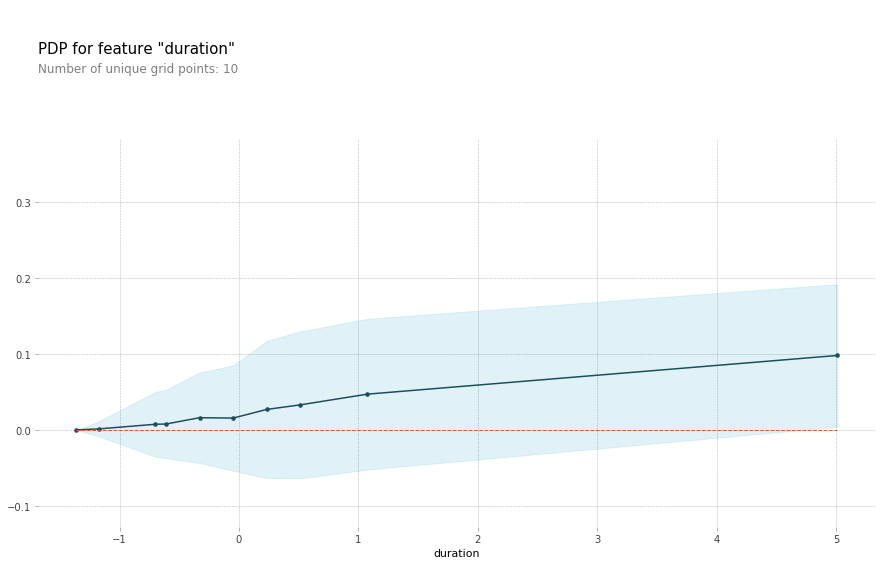

In [260]:
# Create the data that we will plot
pdp_Duration_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_KNN, 'duration')
plt.show()

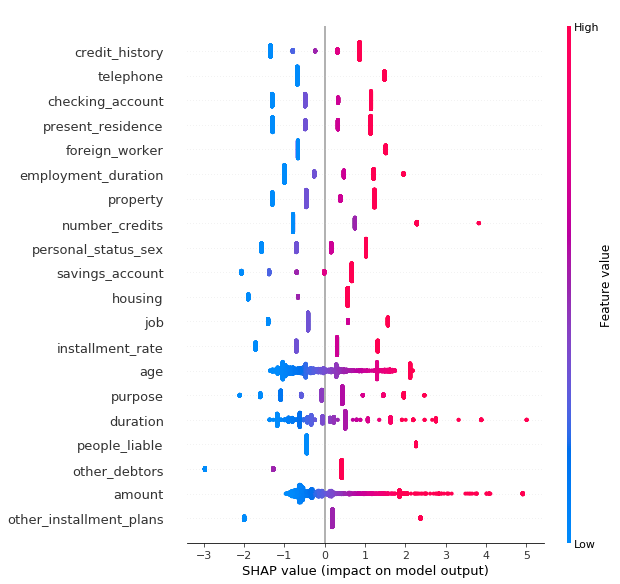

In [261]:
shap.summary_plot(KNN_shap_values.data, x)

In [262]:
KNN_shap_values.data

array([[ 1.15278719e+00,  8.71560860e-01, -1.08553142e+00, ...,
         5.13291991e-01,  2.11409087e-03, -1.09888680e+00],
       [-1.29860291e+00,  8.71560860e-01,  4.40705539e-01, ...,
         5.13291991e-01, -1.64736237e-01, -1.28839915e+00],
       [-1.29860291e+00,  8.71560860e-01, -1.08553142e+00, ...,
         1.07545359e+00,  6.90482341e-02, -1.22522837e+00],
       ...,
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00],
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00],
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00]])

In [263]:
KNN_shap_values.base_values

array([0.23, 0.23, 0.23, ..., 0.23, 0.23, 0.23])

In [264]:
idx = 7
shap.initjs()
shap.force_plot(KNN_shap_values.base_values[0], KNN_shap_values.data[idx], features=x_train.columns)

In [265]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_KNN = lambda a: KNN.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [266]:
y_pred_KNN = predict_fn_KNN(x_test)
y_pred_KNN

array([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1,

In [267]:
expKNN = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_KNN, num_features=20)

Intercept 0.11152647143921021
Prediction_local [0.17705645]
Right: 0


In [268]:
expKNN.show_in_notebook(show_table=True)

In [269]:
score_KNN, closest_class_KNN = ts.score(x_test,
                                y_pred_KNN,
                                k=2,
                                dist_type='point')

In [270]:
#score_KNN, closest_class_KNN

Model 5 LDA

In [271]:
LDA_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)

In [272]:
LDA_grid_search.best_score_


0.7446830001035947

In [273]:
LDA_grid_search.best_params_

{'solver': 'svd'}

In [274]:
#LDA = LDA_grid_search.best_estimator_
LDA = model_LDA.best_estimator_
#LDA

In [275]:
# Printing the Training Score
print("Training score data: ")
print(LDA.score(x_train, y_train))

Training score data: 
0.6819571865443425


In [276]:
y_pred_lda = LDA.predict(x_test)

print(accuracy_score(y_test,y_pred_lda)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_lda))
print("\n")
print(classification_report(y_test, y_pred_lda))

69.31297709923663
 percent


[[374  46]
 [155  80]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79       420
           1       0.63      0.34      0.44       235

    accuracy                           0.69       655
   macro avg       0.67      0.62      0.62       655
weighted avg       0.68      0.69      0.66       655



In [277]:
print("Actual # : ",len(y_pred_lda)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


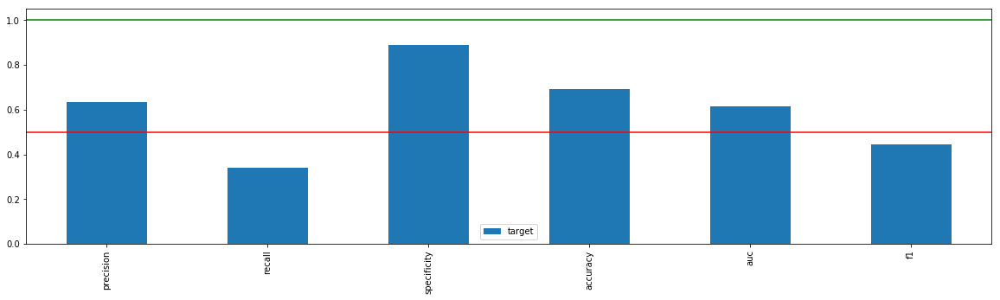

In [278]:
_= xai.metrics_plot(y_test,y_pred_lda)

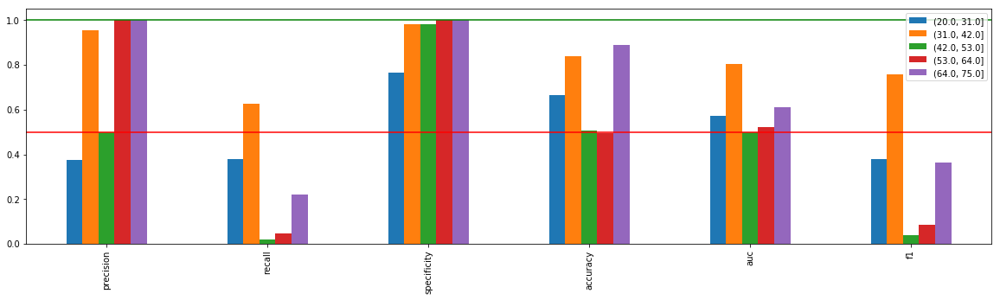

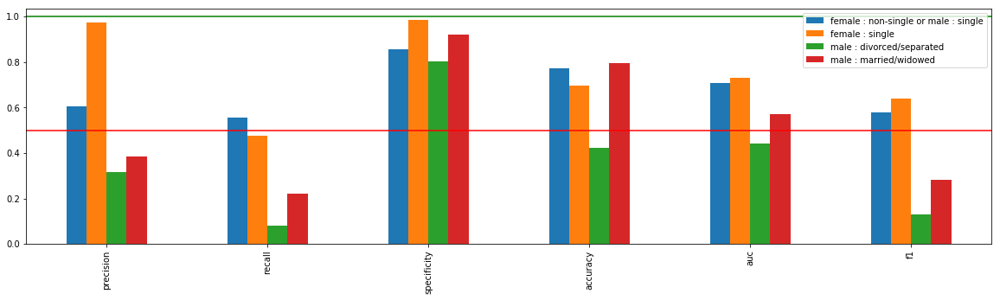

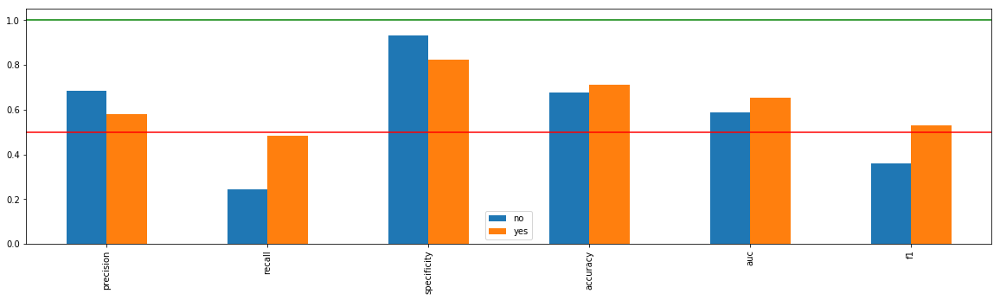

In [279]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

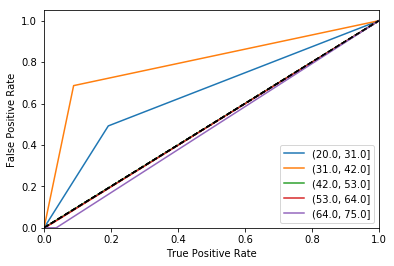

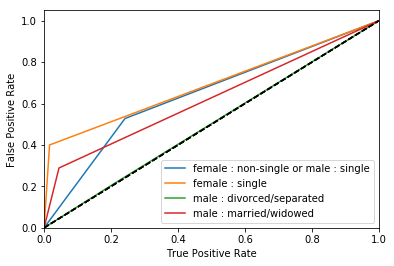

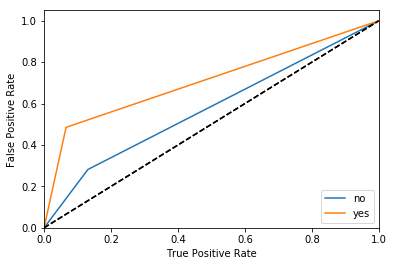

In [280]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_lda, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [281]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [282]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [283]:
#perm_LDA = PermutationImportance(LDA, random_state=seed).fit(x,y)
#eli5.show_weights(perm_LDA, feature_names = x.columns.tolist())

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.000497,0.005694,0.016316,-0.005808,0.003439,0.000038,0.000115,-0.000115,0.000382,-0.001681,0.00214,0.006725,-0.001223,0.000994,-0.00042,-0.03867,0.000841,0.01089,0.011158,-0.00214


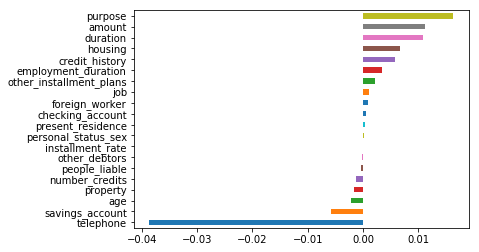

In [284]:
def get_avg_lda(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in LDA.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_lda)
imp2.head()

Model 5 LDA Global Explainations

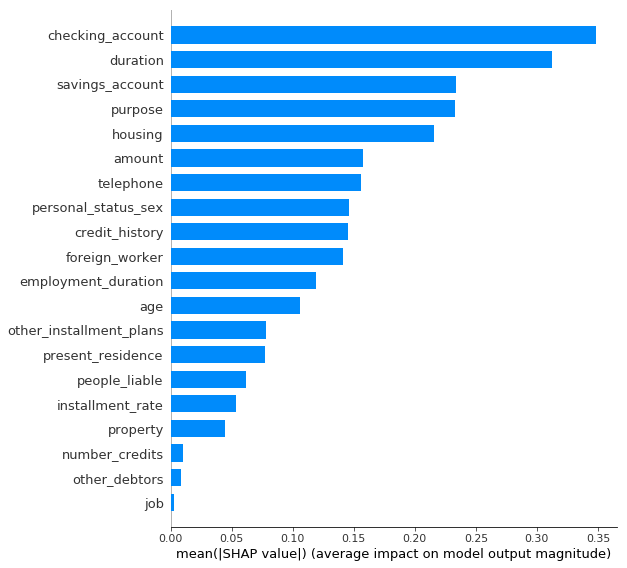

In [285]:
LDA_explainer =  shap.LinearExplainer(LDA,x)
LDA_shap_values = LDA_explainer.shap_values(x)
shap.summary_plot(LDA_shap_values, x.values, plot_type="bar", feature_names = x.columns)

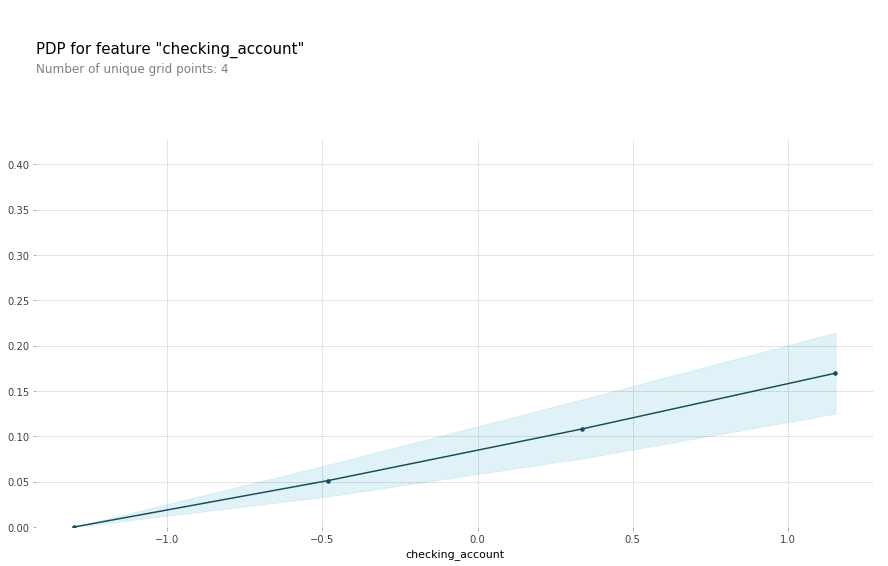

In [286]:
# Create the data that we will plot
pdp_CheckingAccount_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_LDA, 'checking_account')
plt.show()

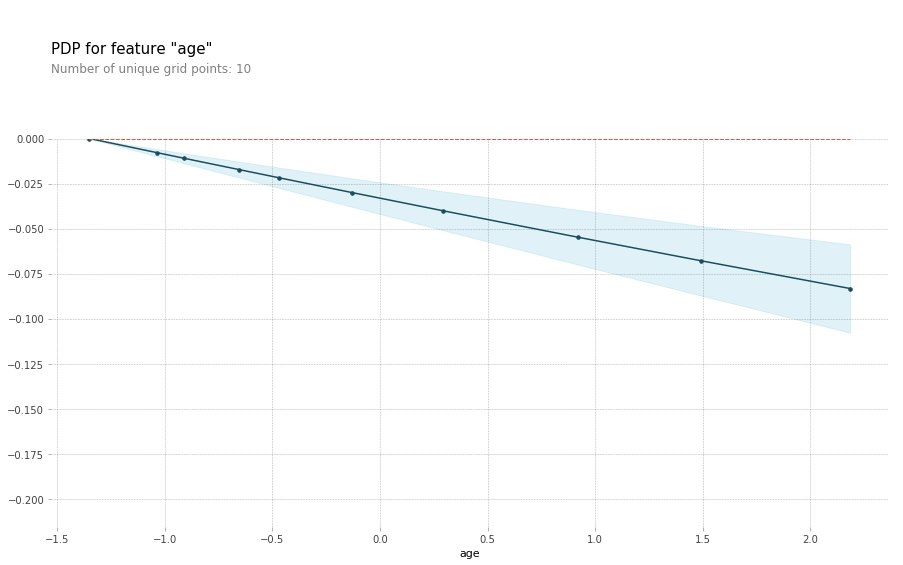

In [287]:
# Create the data that we will plot
pdp_Age_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_LDA, 'age')
plt.show()

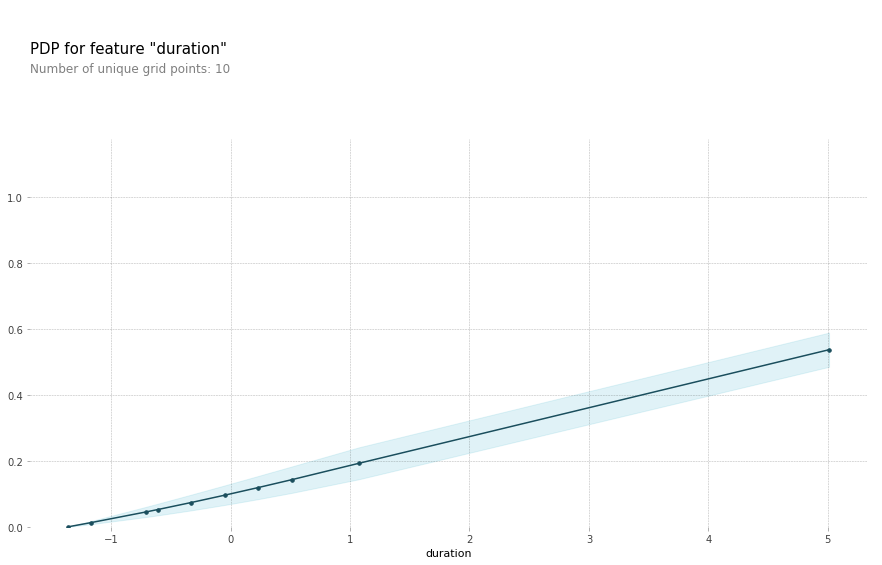

In [288]:
# Create the data that we will plot
pdp_Duration_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_LDA, 'duration')
plt.show()

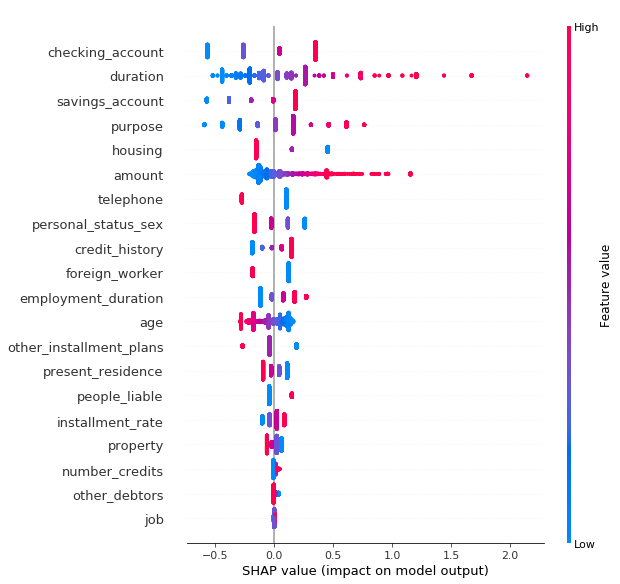

In [289]:
shap.summary_plot(LDA_shap_values, x)

In [290]:
LDA_explainer.expected_value

-0.8462406224978009

In [291]:
LDA_shap_values

array([[ 0.34799549,  0.14558581, -0.29241382, ...,  0.26256053,
         0.01074869,  0.12896075],
       [-0.56778211,  0.14558581,  0.1597725 , ...,  0.26256053,
        -0.02812652,  0.15321669],
       [-0.56778211,  0.14558581, -0.29241382, ...,  0.49804083,
         0.02634398,  0.14513138],
       ...,
       [ 0.04273629, -0.18718176,  0.1597725 , ..., -0.44388036,
        -0.13503334, -0.28339024],
       [ 0.04273629, -0.18718176,  0.1597725 , ..., -0.44388036,
        -0.13503334, -0.28339024],
       [ 0.04273629, -0.18718176,  0.1597725 , ..., -0.44388036,
        -0.13503334, -0.28339024]])

Model 5 LDA Local Explainations

In [292]:
idx = 7
shap.initjs()
shap.force_plot(LDA_explainer.expected_value, LDA_shap_values[idx], features=x_train.columns)

In [293]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_LDA = lambda a: LDA.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [294]:
y_pred_LDA = predict_fn_LDA(x_test)
y_pred_LDA

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,

In [295]:
expLDA = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_LDA, num_features=20)

Intercept -0.1035441098266946
Prediction_local [0.6402783]
Right: 1


In [296]:
expLDA.show_in_notebook(show_table=True)

In [297]:
score_LDA, closest_class_LDA = ts.score(x_test,
                                y_pred_LDA,
                                k=2,
                                dist_type='point')

In [298]:
#score_LDA, closest_class_LDA

Model 6 SVM

In [299]:
SVM_grid_search.fit(x_train, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


GridSearchCV(cv=5, estimator=SVC(probability=True), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             scoring='accuracy', verbose=4)

In [300]:
SVM_grid_search.best_score_

0.9301734434231708

In [301]:
SVM_grid_search.best_params_

{'C': 1, 'gamma': 1, 'kernel': 'rbf'}

In [302]:
#SVM = SVM_grid_search.best_estimator_
SVM = model_SVM.best_estimator_
SVM

SVC(C=1, gamma=0.1, probability=True)

In [303]:
# Printing the Training Score
print("Training score data: ")
print(SVM.score(x_train, y_train))

Training score data: 
0.8929663608562691


In [304]:
y_pred_svm = SVM.predict(x_test)

print(accuracy_score(y_test,y_pred_svm)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_svm))
print("\n")
print(classification_report(y_test, y_pred_svm))

89.46564885496183
 percent


[[412   8]
 [ 61 174]]


              precision    recall  f1-score   support

           0       0.87      0.98      0.92       420
           1       0.96      0.74      0.83       235

    accuracy                           0.89       655
   macro avg       0.91      0.86      0.88       655
weighted avg       0.90      0.89      0.89       655



In [305]:
print("Actual # : ",len(y_pred_svm)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


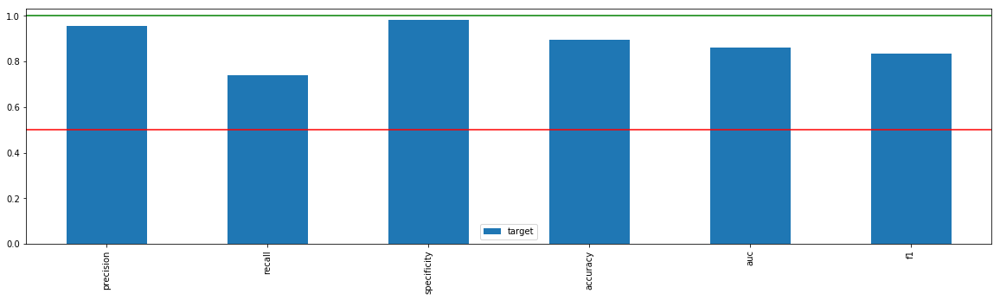

In [306]:
_= xai.metrics_plot(y_test,y_pred_svm)

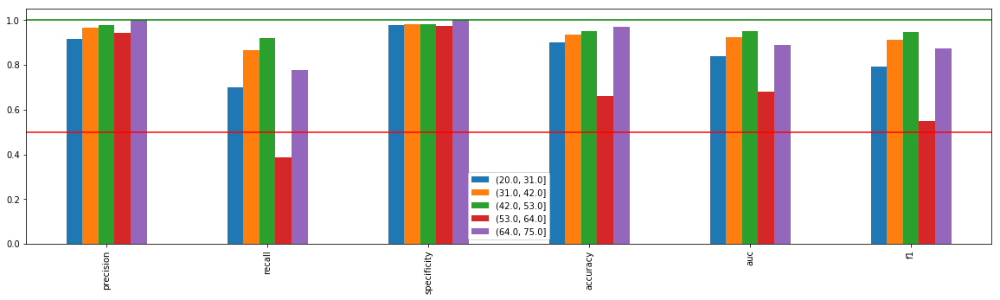

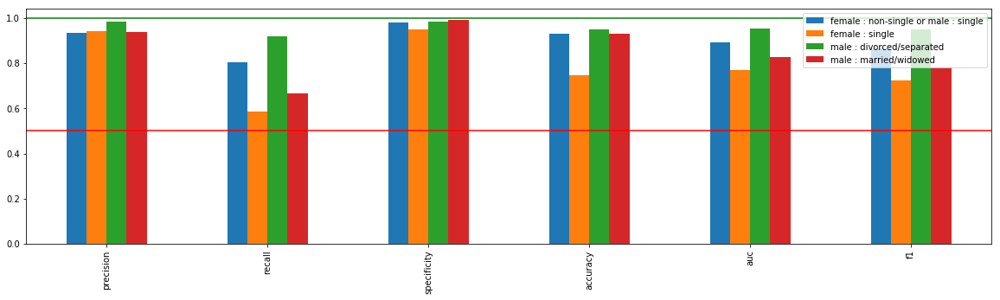

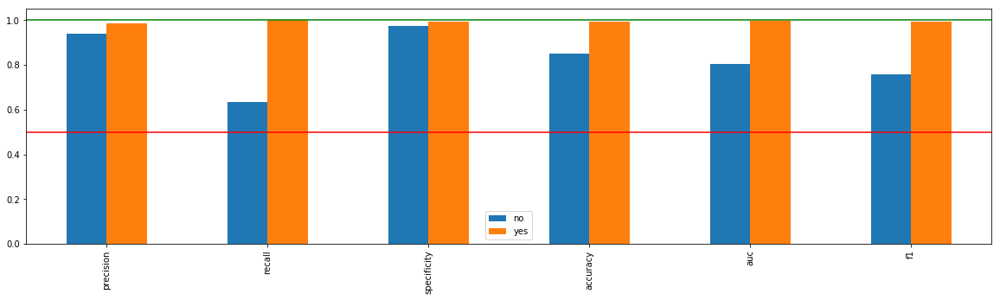

In [307]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_svm, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

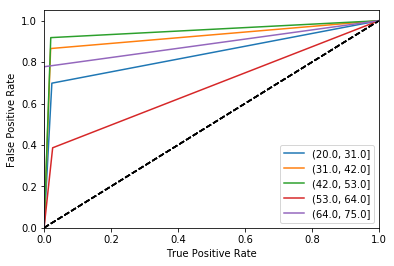

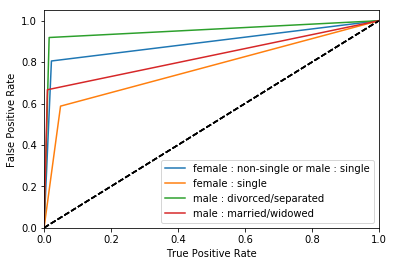

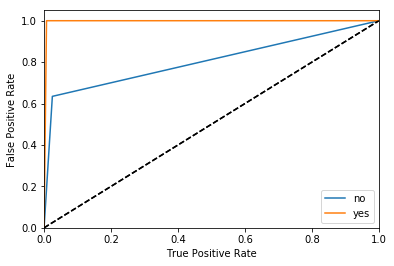

In [308]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_svm, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [309]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [310]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [311]:
#perm_SVM = PermutationImportance(SVM, random_state=seed).fit(x,y)
#eli5.show_weights(perm_SVM, feature_names = x.columns.tolist())

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.052885,0.028735,0.07264,0.035384,0.040504,0.027054,0.025602,0.045778,0.028926,0.032365,0.057165,0.072602,0.028391,0.035881,0.025182,0.026786,0.006037,0.040199,0.075315,0.035613


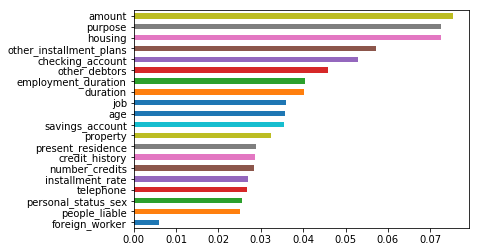

In [312]:
def get_avg_svm(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in SVM.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_svm)
imp2.head()

Model 6 SVM Global Explainations

Permutation explainer: 2618it [20:26,  2.14it/s]


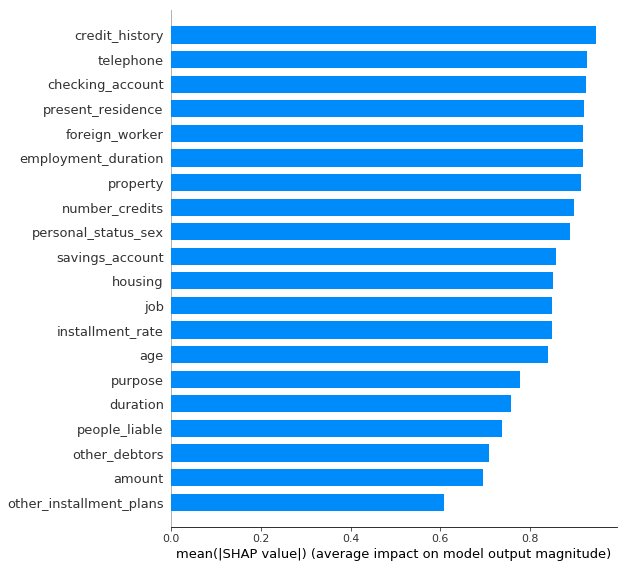

In [313]:
SVM_explainer =  shap.PermutationExplainer(SVM.predict,x)
SVM_shap_values = SVM_explainer.shap_values(x.values,npermutations=5)
shap.summary_plot(SVM_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

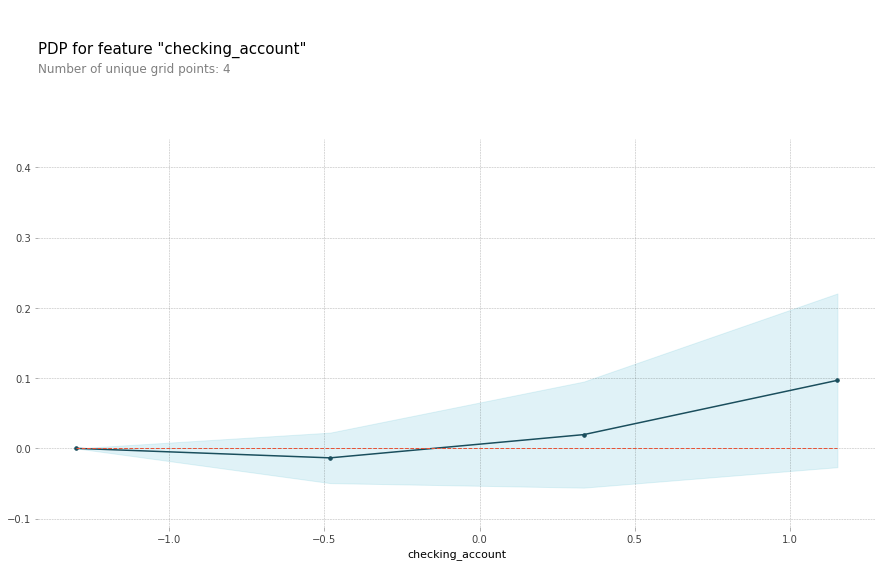

In [314]:
# Create the data that we will plot
pdp_CheckingAccount_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_SVM, 'checking_account')
plt.show()

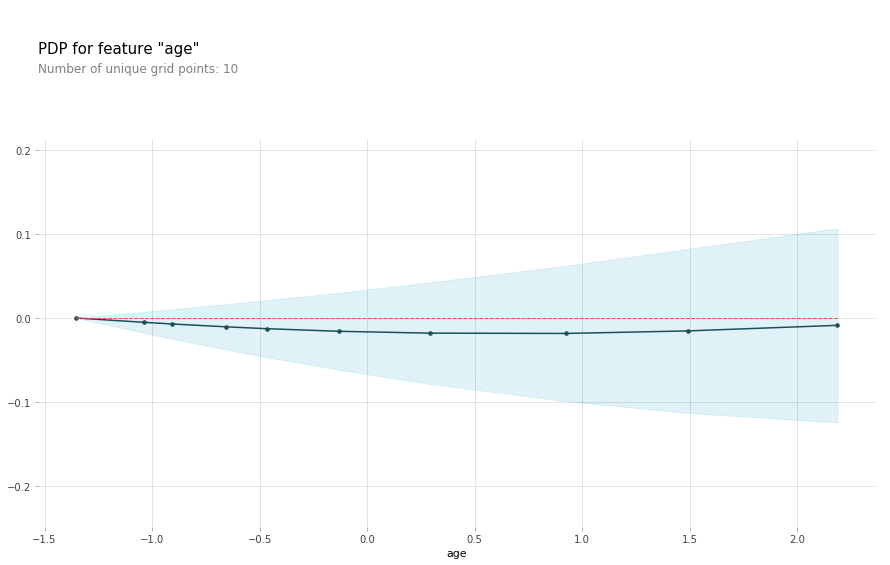

In [315]:
# Create the data that we will plot
pdp_Age_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_SVM, 'age')
plt.show()

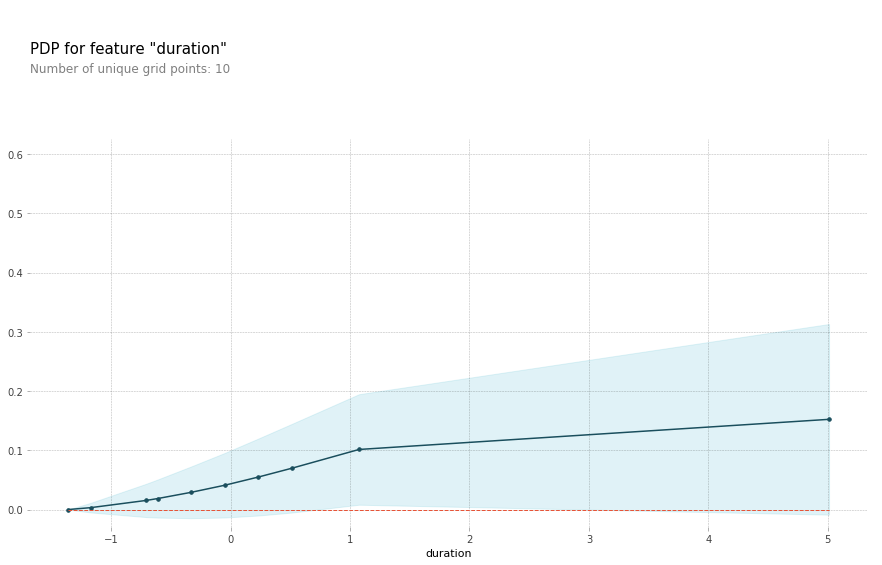

In [316]:
# Create the data that we will plot
pdp_Duration_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_SVM, 'duration')
plt.show()

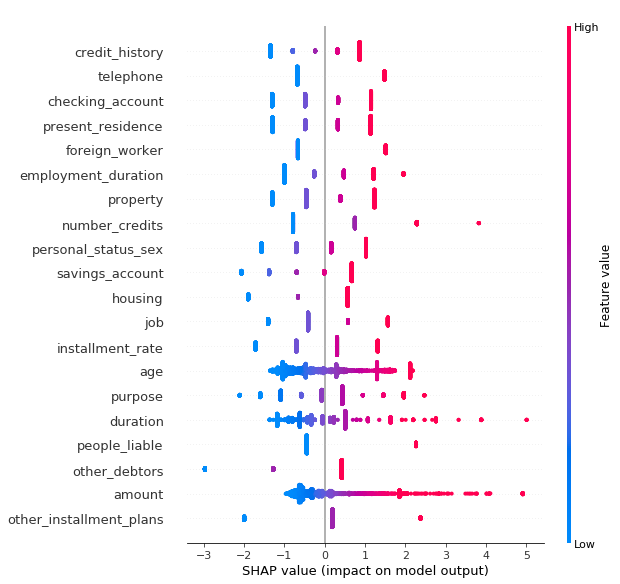

In [317]:
shap.summary_plot(SVM_shap_values.data, x)

In [318]:
SVM_shap_values.base_values

array([0.26, 0.26, 0.26, ..., 0.26, 0.26, 0.26])

In [319]:
SVM_shap_values.data

array([[ 1.15278719e+00,  8.71560860e-01, -1.08553142e+00, ...,
         5.13291991e-01,  2.11409087e-03, -1.09888680e+00],
       [-1.29860291e+00,  8.71560860e-01,  4.40705539e-01, ...,
         5.13291991e-01, -1.64736237e-01, -1.28839915e+00],
       [-1.29860291e+00,  8.71560860e-01, -1.08553142e+00, ...,
         1.07545359e+00,  6.90482341e-02, -1.22522837e+00],
       ...,
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00],
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00],
       [ 3.35657160e-01, -1.33751882e+00,  4.40705539e-01, ...,
        -1.17319280e+00, -6.23574639e-01,  2.12282317e+00]])

Model 6 SVM Local Explainations

In [320]:
idx = 7
shap.initjs()
shap.force_plot(SVM_shap_values.base_values[idx], SVM_shap_values.data[idx], features=x_train.columns)

In [321]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_SVM = lambda a: SVM.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [322]:
y_pred_SVM = predict_fn_SVM(x_test)
y_pred_SVM

array([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1,
       0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1,

In [323]:
expSVM = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_SVM, num_features=20)

Intercept -0.056327234070071536
Prediction_local [0.37233416]
Right: 1


In [324]:
expSVM.show_in_notebook(show_table=True)

In [325]:
score_SVM, closest_class_SVM = ts.score(x_test,
                                y_pred_SVM,
                                k=2,
                                dist_type='point')

In [326]:
#score_SVM, closest_class_SVM

Model 7 : CART Descision Trees

In [327]:
CART_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 588 candidates, totalling 5880 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4, 5, 6, 7]},
             scoring='accuracy', verbose=4)

In [ ]:
print(CART_grid_search.best_params_)

In [ ]:
CART_grid_search.best_score_

In [ ]:
#CART = CART_grid_search.best_estimator_
CART = model_CART.best_estimator_
CART

Model 7 Predictive Accuracy

In [ ]:
#Testing the model 
#Predicting using our  model
y_pred_CART = CART.predict(x_test)

# Verificaar os resultados obtidos
print(accuracy_score(y_test,y_pred_CART)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_CART))
print("\n")
print(fbeta_score(y_test, y_pred_CART, beta=2))
print("\n")
print(classification_report(y_test, y_pred_CART))

In [ ]:
print("Actual # : ",len(y_pred_CART)," Successfully Predicted # :",len(y_test))

In [ ]:
_= xai.metrics_plot(y_test,y_pred_CART)

In [ ]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_CART, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Model 7 Descriptive Accuracy and Relevance

In [ ]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_CART, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Model 7 CART Feature level explainations

In [ ]:
#perm_CART = PermutationImportance(CART, random_state=seed).fit(x,y)
#eli5.show_weights(perm_CART, feature_names = x.columns.tolist())

In [ ]:
def get_avg_cart(x, y):
    return accuracy_score(CART.predict(x), y)

imp1 = xai.feature_importance(x, y,get_avg_cart)
imp1.head()

Model 7 CART Global Explainations

In [ ]:
CART_explainer =  shap.TreeExplainer(CART)
CART_shap_values = CART_explainer.shap_values(x)
shap.summary_plot(CART_shap_values[1], x,plot_type="bar")

In [ ]:
CART_explainer =  shap.TreeExplainer(CART)
CART_shap_values = CART_explainer.shap_values(x)
shap.summary_plot(CART_shap_values[0], x,plot_type="bar")

In [ ]:

# Create the data that we will plot
pdp_CheckingAccount_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_CART, 'checking_account')
plt.show()

In [ ]:
# Create the data that we will plot
pdp_Age_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_CART, 'age')
plt.show()

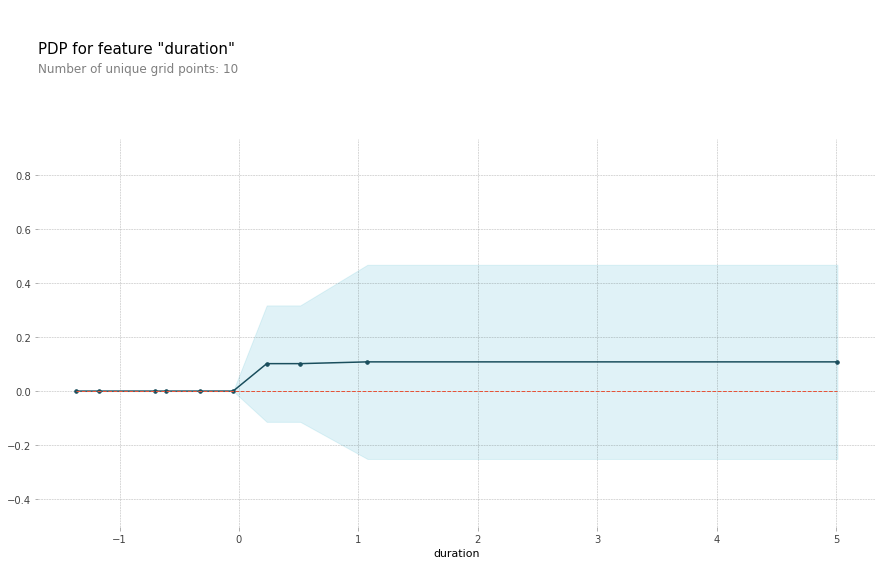

In [342]:
# Create the data that we will plot
pdp_Duration_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_CART, 'duration')
plt.show()

In [343]:
# Similar to previous PDP plot except we use pdp_interact instead of pdp_isolate and pdp_interact_plot instead of pdp_isolate_plot
interCART  =  pdp.pdp_interact(model=CART, dataset=x, model_features=x.columns, features=protected_cols)

#pdp.pdp_interact_plot(pdp_interact_out=interRF, feature_names=['Risk','Age'], plot_type='contour')
#plt.show()

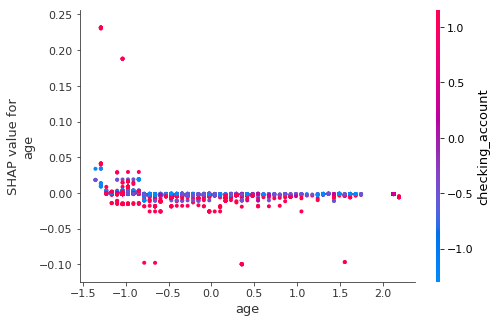

In [344]:
# make plot.
shap.dependence_plot('age', CART_shap_values[1], x)

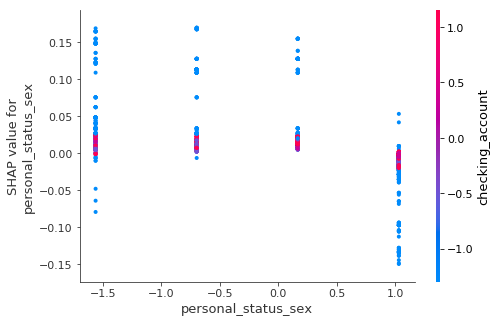

In [345]:
# make plot.
shap.dependence_plot('personal_status_sex', CART_shap_values[1], x, interaction_index='checking_account')

Model 7 CART Local Explainations

In [346]:
CART_explainer.expected_value

array([0.67, 0.33])

In [347]:
CART_shap_values[0]

array([[-0.11214405, -0.04696909,  0.14858989, ..., -0.05378119,
         0.03186454,  0.01549884],
       [-0.17734035, -0.0454632 , -0.00758786, ..., -0.05001663,
         0.0160489 , -0.0136032 ],
       [-0.28469641, -0.0248726 ,  0.0462966 , ..., -0.05128395,
         0.01451667, -0.00302908],
       ...,
       [ 0.09898857,  0.04713224,  0.00435029, ...,  0.0173169 ,
         0.00362953,  0.00146216],
       [ 0.09898857,  0.04713224,  0.00435029, ...,  0.0173169 ,
         0.00362953,  0.00146216],
       [ 0.09898857,  0.04713224,  0.00435029, ...,  0.0173169 ,
         0.00362953,  0.00146216]])

In [348]:
CART_shap_values[1]

array([[ 0.11214405,  0.04696909, -0.14858989, ...,  0.05378119,
        -0.03186454, -0.01549884],
       [ 0.17734035,  0.0454632 ,  0.00758786, ...,  0.05001663,
        -0.0160489 ,  0.0136032 ],
       [ 0.28469641,  0.0248726 , -0.0462966 , ...,  0.05128395,
        -0.01451667,  0.00302908],
       ...,
       [-0.09898857, -0.04713224, -0.00435029, ..., -0.0173169 ,
        -0.00362953, -0.00146216],
       [-0.09898857, -0.04713224, -0.00435029, ..., -0.0173169 ,
        -0.00362953, -0.00146216],
       [-0.09898857, -0.04713224, -0.00435029, ..., -0.0173169 ,
        -0.00362953, -0.00146216]])

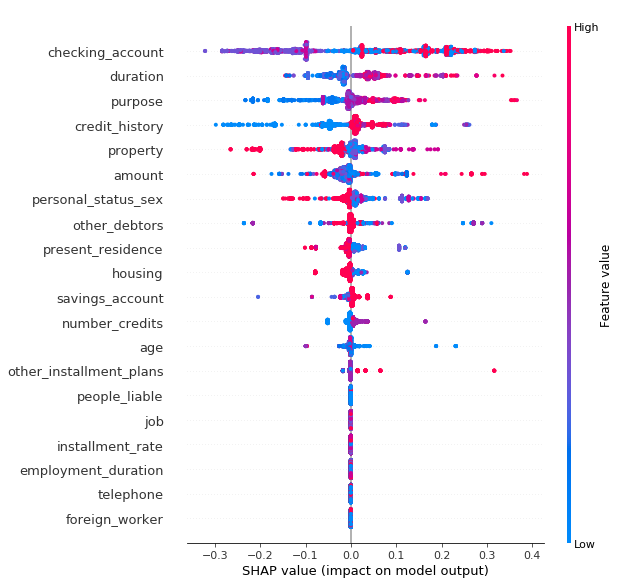

In [349]:
shap.summary_plot(CART_shap_values[1], x)

In [350]:
idx = 7
shap.initjs()
shap.force_plot(CART_explainer.expected_value[0], CART_shap_values[0][idx], features=x.columns)

In [351]:
shap.force_plot(CART_explainer.expected_value[1], CART_shap_values[1][idx], features=x.columns)

In [352]:
test_idx = 5
predict_fn_CART = lambda a: CART.predict(a)
x_test.iloc[test_idx]

checking_account          -0.481473
credit_history            -1.337519
purpose                   -1.085531
savings_account            0.676875
employment_duration        0.481251
installment_rate          -0.698949
personal_status_sex       -1.561399
other_debtors              0.427788
present_residence          1.142918
property                  -0.451723
other_installment_plans    0.193830
housing                   -1.892537
number_credits             0.754513
job                       -0.408335
people_liable             -0.440944
telephone                  1.484312
foreign_worker            -0.658170
duration                   1.637615
amount                     1.260929
age                       -1.098887
Name: 32, dtype: float64

In [353]:
y_pred_CART = predict_fn_CART(x_test)
#y_pred_RF

In [354]:
expCART = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_CART,num_features=20)

Intercept 0.18600522763752386
Prediction_local [-0.00097763]
Right: 0


In [355]:
expCART.show_in_notebook(show_table=True)

In [356]:
scoreCART, closest_classCART = ts.score(x_test,
                                y_pred_CART,
                                k=2,
                                dist_type='point')

In [357]:
#scoreCART, closest_classCART

Model 8 Logistic Regression

In [358]:
LR_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 2000 candidates, totalling 20000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                       ('pca', PCA()),
                                       ('logistic_Reg', LogisticRegression())]),
             n_jobs=-1,
             param_grid={'logistic_Reg__C': array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
       4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
       2.02358965...
       7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
       3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
       1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
       6.86648845e+03, 1.00000000e+04]),
                         'logistic_Reg__penalty': ['l1', 'l2'],
                         'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                     

In [359]:
LR_grid_search.best_score_

0.755899720294209

In [360]:
LR_grid_search.best_params_

{'logistic_Reg__C': 0.5689866029018293,
 'logistic_Reg__penalty': 'l2',
 'pca__n_components': 18,
 'std_slc': StandardScaler()}

In [361]:
#LR = LR_grid_search.best_estimator_
LR = model_LR.best_estimator_
LR

Pipeline(steps=[('std_slc', StandardScaler()), ('pca', PCA(n_components=12)),
                ('logistic_Reg', LogisticRegression(C=0.0013894954943731374))])

In [362]:
# Printing the Training Score
print("Training score data: ")
print(LR.score(x_train, y_train))

Training score data: 
0.6396534148827727


In [363]:
y_pred_LR = LR.predict(x_test)

print(accuracy_score(y_test,y_pred_LR)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_LR))
print("\n")
print(classification_report(y_test, y_pred_LR))

64.27480916030535
 percent


[[420   0]
 [234   1]]


              precision    recall  f1-score   support

           0       0.64      1.00      0.78       420
           1       1.00      0.00      0.01       235

    accuracy                           0.64       655
   macro avg       0.82      0.50      0.40       655
weighted avg       0.77      0.64      0.50       655



In [364]:
print("Actual # : ",len(y_pred_LR)," Successfully Predicted # :",len(y_test))

Actual # :  655  Successfully Predicted # : 655


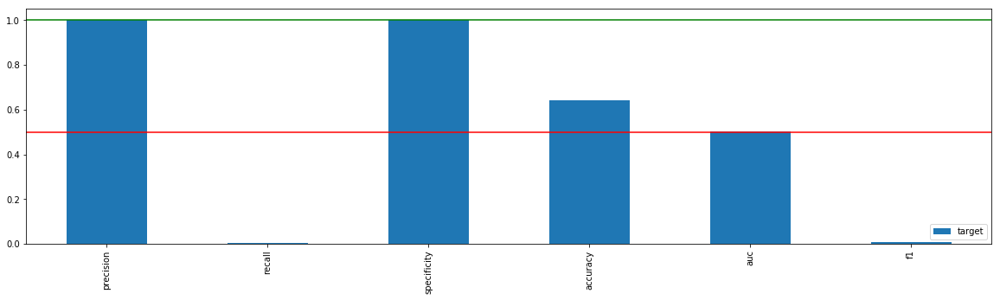

In [365]:
_= xai.metrics_plot(y_test,y_pred_LR)

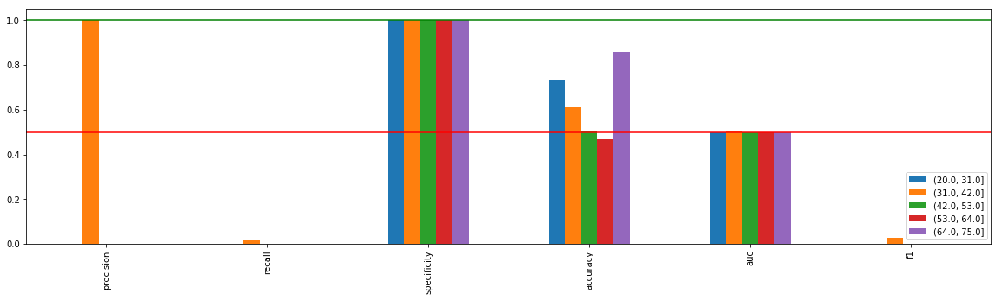

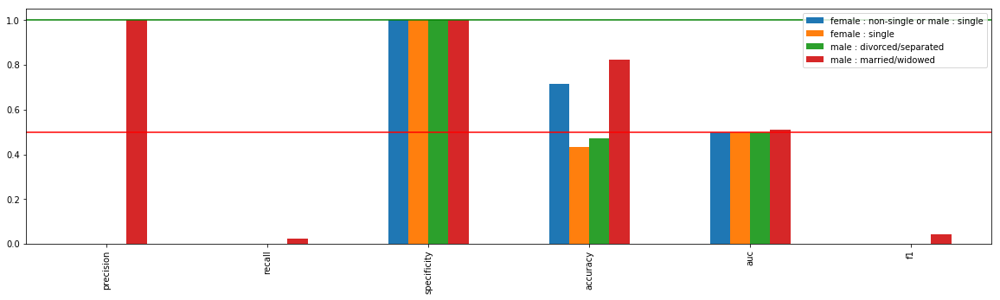

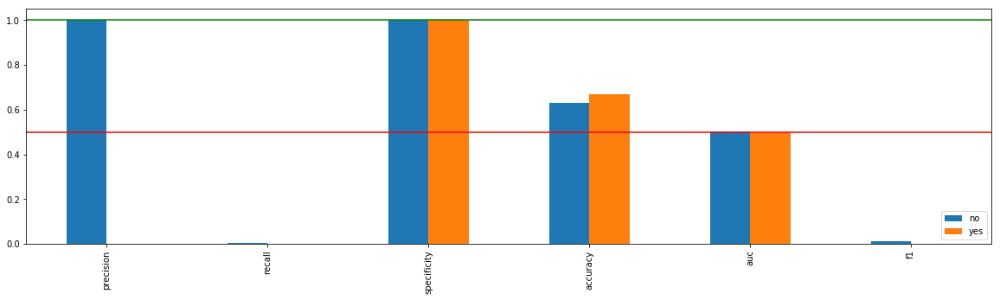

In [366]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_LR, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

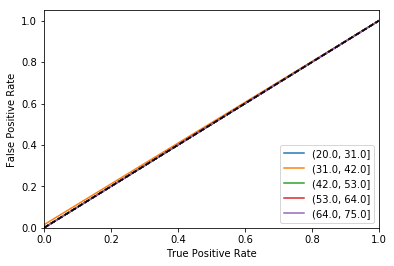

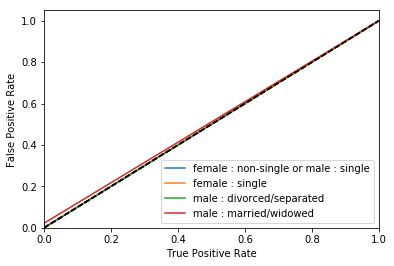

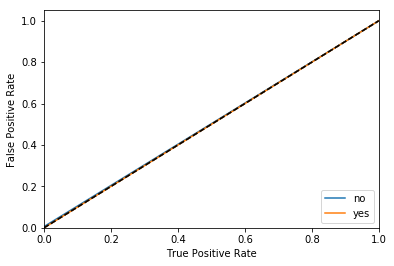

In [367]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_LR, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [368]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [369]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [370]:
#perm_LR = PermutationImportance(LR, random_state=seed).fit(x,y)
#eli5.show_weights(perm_LR, feature_names = x.columns.tolist())

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.000497,0.000153,0.000306,0.000115,0.0,0.000115,0.0,0.0,0.000306,0.000153,0.0,0.00042,0.000115,0.0,0.0,0.000038,0.000076,0.000344,0.000191,0.000153


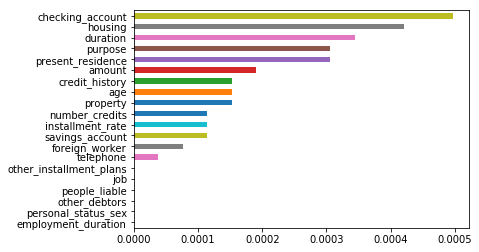

In [371]:
def get_avg_lr(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in LR.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_lr)
imp2.head()

Model 8 LR Global Explainations

Permutation explainer: 2618it [00:41, 62.54it/s]                          


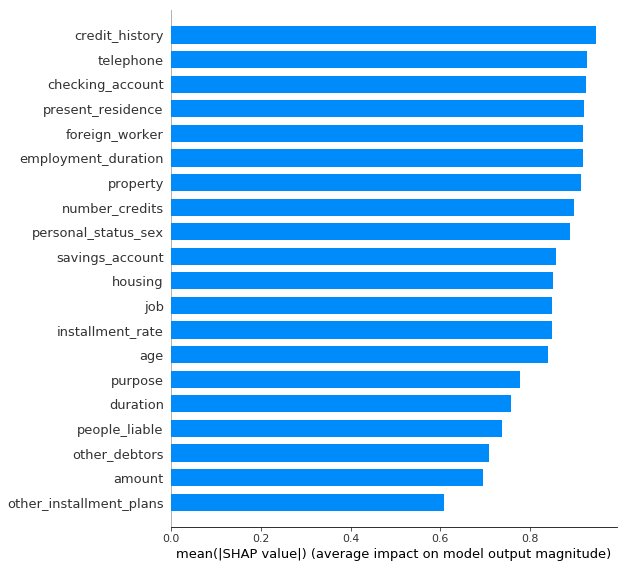

In [372]:
LR_explainer =  shap.PermutationExplainer(LR.predict,x)
LR_shap_values = LR_explainer.shap_values(x.values,npermutations=5)
shap.summary_plot(LR_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

In [ ]:
# Create the data that we will plot
pdp_CheckingAccount_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_LR, 'checking_account')
plt.show()

In [ ]:
# Create the data that we will plot
pdp_Age_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_LR, 'age')
plt.show()

In [ ]:
# Create the data that we will plot
pdp_Duration_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_LR, 'duration')
plt.show()

In [ ]:
shap.summary_plot(LR_shap_values.data, x)

In [ ]:
LR_shap_values.base_values

In [ ]:
LR_shap_values.data

Model 8 LR Local Explainations

In [ ]:
idx = 7
shap.initjs()
shap.force_plot(LR_shap_values.base_values[idx], LR_shap_values.data[idx], features=x_train.columns)


In [ ]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_LR = lambda a: LR.predict(a)
x_test.iloc[test_idx]

In [ ]:
y_pred_LR = predict_fn_LR(x_test)
y_pred_LR

In [ ]:
expLR = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_LR, num_features=20)

In [ ]:
expLR.show_in_notebook(show_table=True)

In [384]:
score_LR, closest_class_LR = ts.score(x_test,
                                y_pred_LR,
                                k=2,
                                dist_type='point')

In [ ]:
#score_LR, closest_class_LR

Trust Scores for models

In [ ]:
def run_RF(X_train, y_train, X_test):
    y_pred = RF.predict(X_test)
    y_pred_proba = RF.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas
def run_GNB(X_train, y_train, X_test):
    y_pred = GNB.predict(X_test)
    y_pred_proba = GNB.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_xGB(X_train, y_train, X_test):
    y_pred_proba =  np.array([a[1] for a in xGB.predict_proba(X_test)])
    y_pred = np.array([1 if a > 0.5 else 0 for a in y_pred_proba]).astype('int8')
    return y_pred,y_pred_proba
def run_KNN(X_train, y_train, X_test):
    y_pred = KNN.predict(X_test)
    y_pred_proba = KNN.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_LDA(X_train, y_train, X_test):
    y_pred = LDA.predict(X_test)
    y_pred_proba = LDA.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_SVM(X_train, y_train, X_test):
    y_pred = SVM.predict(X_test)
    y_pred_proba = SVM.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_CART(X_train, y_train, X_test):
    y_pred = CART.predict(X_test)
    y_pred_proba = CART.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas
def run_LR(X_train, y_train, X_test):
    y_pred = LR.predict(X_test)
    y_pred_proba = LR.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas

In [387]:
run_RF(x_train,y_train,x_test)

(array([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1,
        0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1,
        0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0,
        0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 

In [388]:
run_xGB(x_train,y_train,x_test)

NameError: ignored

In [ ]:
run_GNB(x_train,y_train,x_test)

In [ ]:
run_KNN(x_train,y_train,x_test)

In [ ]:
run_LDA(x_train,y_train,x_test)

In [ ]:
run_SVM(x_train,y_train,x_test)

In [ ]:
run_CART(x_train,y_train,x_test)

In [ ]:
run_LR(x_train,y_train,x_test)

In [ ]:
def plot_precision_curve(plot_title,
                         percentiles,
                         labels,
                         final_tp,
                         final_stderr,
                         final_misclassification,
                         colors = ['blue', 'darkorange', 'brown', 'red', 'purple']):

    plt.title(plot_title, fontsize=18)
    colors = colors + list(cm.rainbow(np.linspace(0, 1, len(final_tp))))
    plt.xlabel("Percentile", fontsize=14)
    plt.ylabel("Precision", fontsize=14)

    for i, label in enumerate(labels):
        ls = "--" if ("Model" in label) else "-"
        plt.plot(percentiles, final_tp[i], ls, c=colors[i], label=label)
        plt.fill_between(percentiles,
                         final_tp[i] - final_stderr[i],
                         final_tp[i] + final_stderr[i],
                         color=colors[i],
                         alpha=.1)

    if 0. in percentiles:
        plt.legend(loc="lower right", fontsize=14)
    else:
        plt.legend(loc="upper left", fontsize=14)
    model_acc = 100 * (1 - final_misclassification)
    plt.axvline(x=model_acc, linestyle="dotted", color="black")
    plt.show()

In [ ]:
def run_precision_plt(X, y, nfolds, percentiles, run_model, test_size=.5,
                      plt_title="", plt_names=[], predict_correct=True, classes=2):

    def stderr(L):
        return np.std(L) / np.sqrt(len(L))

    all_tp = [[[] for p in percentiles] for _ in plt_names]
    misclassifications = []
    mult = 1 if predict_correct else -1

    folds = StratifiedShuffleSplit(n_splits=nfolds, test_size=test_size, random_state=0)
    for tn_idx, tst_idx in folds.split(X, y):
        #create train and test folds, train model and make predictions
        X_train, y_train = X[tn_idx, :], y[tn_idx]
        X_test, y_test = X[tst_idx, :], y[tst_idx]
        
        y_pred, probas = run_model(X_train, y_train, X_test)
        # target points are the correctly classified points
        target_points = np.where(y_pred == y_test)[0] if predict_correct else np.where(y_pred != y_test)[0]
        final_curves = [probas]
        #calculate trust scores
        ts = TrustScore()
        ts.fit(X_train, y_train, classes=classes)
        scores, _ = ts.score(X_test, y_pred, k=2, dist_type='point')
        final_curves.append(scores)  # contains prediction probabilities and trust scores
        # check where prediction probabilities and trust scores are above a certain percentage level
        for p, perc in enumerate(percentiles):
            high_proba = [np.where(mult * curve >= np.percentile(mult * curve, perc))[0] for curve in final_curves]
            if 0 in map(len, high_proba):
                continue
            # calculate fraction of values above percentage level that are correctly (or incorrectly) classified
            tp = [len(np.intersect1d(hp, target_points)) / (1. * len(hp)) for hp in high_proba]
            for i in range(len(plt_names)):
                all_tp[i][p].append(tp[i])  # for each percentile, store fraction of values above cutoff value
        misclassifications.append(len(target_points) / (1. * len(X_test)))

    # average over folds for each percentile
    final_tp = [[] for _ in plt_names]
    final_stderr = [[] for _ in plt_names]
    for p, perc in enumerate(percentiles):
        for i in range(len(plt_names)):
            final_tp[i].append(np.mean(all_tp[i][p]))
            final_stderr[i].append(stderr(all_tp[i][p]))

    for i in range(len(all_tp)):
        final_tp[i] = np.array(final_tp[i])
        final_stderr[i] = np.array(final_stderr[i])

    final_misclassification = np.mean(misclassifications)
    #print(final_misclassification)
    # create plot
    plot_precision_curve(plt_title, percentiles, plt_names, final_tp, final_stderr, final_misclassification)

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit
import matplotlib.cm as cm

In [ ]:
percentiles = [0 + 0.5 * i for i in range(0,200)]
plt_names = ['Model Confidence', 'Trust Score']
nfolds = 10

In [ ]:
plt_title = 'GermanBank Data -- Random Forest -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_RF, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- XGBoost -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_xGB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- Gaussian Naive Bayes -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_GNB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- KNN -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_KNN, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- LDA -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_LDA, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- SVM -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_SVM, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- CART -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_CART, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- LR -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_LR, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

In [ ]:
plt_title = 'GermanBank Data -- Random Forest -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_RF, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- Guassian Naive Baes -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_GNB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:

plt_title = 'GermanBank Data -- xG Boost -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_xGB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- KNN -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_KNN, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- LDA -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_LDA, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- SVM -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_SVM, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- CART Descision Trees -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_CART, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
plt_title = 'GermanBank Data -- Logistic Regression with PCA -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_LR, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [ ]:
#proc_df['Risk'] = y
proc_df.info()

In [ ]:
proc_df.head(10)

In [390]:
!pip3 install witwidget

     |████████████████████████████████| 2.3MB 5.5MB/s 
     |████████████████████████████████| 14.8MB 266kB/s 
ERROR: xarray 0.15.1 has requirement pandas>=0.25, but you'll have pandas 0.23.4 which is incompatible.
ERROR: xai 0.0.5 has requirement numpy==1.15.4, but you'll have numpy 1.19.5 which is incompatible.
ERROR: xai 0.0.5 has requirement scikit-learn==0.20.1, but you'll have scikit-learn 0.24.0 which is incompatible.
ERROR: umap-learn 0.4.6 has requirement scipy>=1.3.1, but you'll have scipy 1.1.0 which is incompatible.
ERROR: tensorflow 2.4.0 has requirement six~=1.15.0, but you'll have six 1.12.0 which is incompatible.
ERROR: plotnine 0.6.0 has requirement matplotlib>=3.1.1, but you'll have matplotlib 3.0.2 which is incompatible.
ERROR: plotnine 0.6.0 has requirement pandas>=0.25.0, but you'll have pandas 0.23.4 which is incompatible.
ERROR: plotnine 0.6.0 has requirement scipy>=1.2.0, but you'll have scipy 1.1.0 which is incompatible.
ERROR: mizani 0.6.0 has requirement matp

In [391]:
from witwidget.notebook.visualization import WitConfigBuilder
from witwidget.notebook.visualization import WitWidget

In [392]:
# Set the column in the dataset you wish for the model to predict
#label_column = 'Risk'

# Make the label column numeric (0 and 1), for use in our model.
# In this case, examples with a target value of '>50K' are considered to be in
# the '1' (positive) class and all other examples are considered to be in the
# '0' (negative) class.
#make_label_column_numeric(proc_df, label, lambda val: val == 1)

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose']
input_features = categorical_cols + ordinal_cols

# Create a list containing all input features and the label column
features_and_labels = input_features + [label]

In [393]:
num_datapoints = 1000
tool_height_in_px = 1000

examples_proc_df = df_to_examples(proc_df)
feature_spec_proc_df = create_feature_spec(proc_df, features_and_labels)
X_dnn_proc_train = functools.partial(tfexamples_input_fn, examples_proc_df, feature_spec_proc_df, label)

In [394]:
PROJECT_ID = 'S2-19_DSECLZG628T'
VERSION_NAME = '0.01v'
TARGET_FEATURE = label
LABEL_VOCAB = ['Good', 'Bad']

In [395]:
DNN_Classifier_proc = tf.estimator.DNNClassifier(
    feature_columns=create_feature_columns(input_features, feature_spec_proc_df,proc_df),
    hidden_units=[14,5])
DNN_Classifier_proc.train(X_dnn_proc_train, steps=num_steps)

MODEL_NAME = 'Deep_Neural_Netrwork'

# Setup the tool with the test examples and the trained classifier
config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(DNN_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, MODEL_NAME, VERSION_NAME).set_target_feature(TARGET_FEATURE).set_label_vocab(LABEL_VOCAB)
a = WitWidget(config_builder, height=tool_height_in_px)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpgp31z3ts', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:ten

In [397]:
LR_Classifier_proc = tf.estimator.LinearClassifier(
    feature_columns=create_feature_columns(input_features, feature_spec_proc_df,proc_df),
     n_classes=2, weight_column=None,
    label_vocabulary=None, optimizer='Ftrl', config=None,
    warm_start_from=None,
    loss_reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE,
    sparse_combiner='sum'
    )
LR_Classifier_proc.train(X_dnn_proc_train, steps=num_steps)

MODEL_NAME = 'Linear_Classifier'

# Setup the tool with the test examples and the trained classifier
config_builder = config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(LR_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, MODEL_NAME, VERSION_NAME).set_target_feature(TARGET_FEATURE).set_label_vocab(LABEL_VOCAB)
a = WitWidget(config_builder, height=tool_height_in_px)

In [396]:
def adjust_prediction(pred):
  return [1 - pred, pred]

In [398]:
LinearDNN_Classifier_proc = tf.estimator.DNNLinearCombinedClassifier (
    dnn_feature_columns=create_feature_columns(input_features, feature_spec_proc_df,proc_df),
    linear_optimizer='Ftrl', dnn_optimizer='Adagrad',
    dnn_hidden_units=[14,5],
    dnn_activation_fn=tf.nn.sigmoid, n_classes=2,
    loss_reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE
    #linear_sparse_combiner='sum'
    )
LinearDNN_Classifier_proc.train(X_dnn_proc_train, steps=num_steps)

MODEL_NAME = 'Linear_Deep_Neural_Network_Classifier'

# Setup the tool with the test examples and the trained classifier
config_builder = config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(LinearDNN_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, MODEL_NAME, VERSION_NAME,adjust_prediction=adjust_prediction).set_target_feature(TARGET_FEATURE).set_label_vocab(LABEL_VOCAB)
a = WitWidget(config_builder, height=tool_height_in_px)

In [399]:
XGBoost_Classifier_proc = tf.estimator.BoostedTreesClassifier(    feature_columns=create_feature_columns(input_features, feature_spec_proc_df,proc_df), n_batches_per_layer=5,n_classes=2,
    n_trees=100, max_depth=6,
    learning_rate=0.1, l1_regularization=0.0, l2_regularization=0.0,
    tree_complexity=0.0, min_node_weight=0.0,
    pruning_mode='none', quantile_sketch_epsilon=0.01,
    train_in_memory=False)
XGBoost_Classifier_proc.train(X_dnn_proc_train, steps=num_steps)

MODEL_NAME = 'XG_Boost_Classifier'

# Setup the tool with the test examples and the trained classifier
config_builder = config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(XGBoost_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, MODEL_NAME, VERSION_NAME).set_target_feature(TARGET_FEATURE).set_label_vocab(LABEL_VOCAB)
a = WitWidget(config_builder, height=tool_height_in_px)

Type is unsupported, or the types of the items don't match field type in CollectionDef. Note this is a warning and probably safe to ignore.
'_Resource' object has no attribute 'name'
Type is unsupported, or the types of the items don't match field type in CollectionDef. Note this is a warning and probably safe to ignore.
'_Resource' object has no attribute 'name'
Type is unsupported, or the types of the items don't match field type in CollectionDef. Note this is a warning and probably safe to ignore.
'_Resource' object has no attribute 'name'
Type is unsupported, or the types of the items don't match field type in CollectionDef. Note this is a warning and probably safe to ignore.
'_Resource' object has no attribute 'name'


In [400]:
config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(
    DNN_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, 'DNN_Classifier_proc', VERSION_NAME).set_compare_estimator_and_feature_spec(
    LR_Classifier_proc, feature_spec_proc_df).set_compare_model_name('LR_Classifier_proc').set_label_vocab([ "Good", "Bad"])
a = WitWidget(config_builder, height=tool_height_in_px)

In [402]:
config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(
    DNN_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, 'DNN_Classifier_proc', VERSION_NAME).set_compare_estimator_and_feature_spec(
    LinearDNN_Classifier_proc, feature_spec_proc_df).set_compare_model_name('LinearDNN_Classifier_proc').set_label_vocab([ "Good", "Bad"])
a = WitWidget(config_builder, height=tool_height_in_px)

In [403]:
config_builder = WitConfigBuilder(examples_proc_df).set_estimator_and_feature_spec(
    DNN_Classifier_proc, feature_spec_proc_df).set_ai_platform_model(PROJECT_ID, 'DNN_Classifier_proc', VERSION_NAME).set_compare_estimator_and_feature_spec(
    XGBoost_Classifier_proc, feature_spec_proc_df).set_compare_model_name('XGBoost_Classifier_proc').set_label_vocab([ "Good", "Bad"])
a = WitWidget(config_builder, height=tool_height_in_px)

In [404]:
# Set the column in the dataset you wish for the model to predict
#label_column = 'Risk'

# Make the label column numeric (0 and 1), for use in our model.
# In this case, examples with a target value of '>50K' are considered to be in
# the '1' (positive) class and all other examples are considered to be in the
# '0' (negative) class.
# label_column = 'Risk'

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving_accounts','Checking_account','Credit_amount','Duration','Purpose','Age_cat','Job_lvl']

#make_label_column_numeric(dnn_x, label_column, lambda val: val == 0)

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving_accounts','Checking_account','Credit_amount','Duration','Purpose']

# Create a list containing all input features and the label column
#features_and_labels = input_features + [label_column]
df_dnn_lrp = x.copy(deep=True)
df_dnn_lrp[label] = y
df_dnn_lrp.head(2)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,1.152787,0.871561,-1.085531,0.676875,0.481251,0.309959,-1.561399,0.427788,1.142918,1.238282,0.19383,-1.892537,-0.780915,1.572411,-0.440944,1.484312,-0.65817,0.513292,0.002114,-1.098887,1
1,-1.298603,0.871561,0.440706,0.676875,-0.995225,-1.707856,-1.561399,0.427788,1.142918,-0.451723,0.19383,-1.892537,-0.780915,1.572411,-0.440944,1.484312,-0.65817,0.513292,-0.164736,-1.288399,1


In [401]:
bal_df.head(2)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
1,... < 0 DM,no credits taken/all credits paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,car or other,none,for free,1,unskilled - resident,0 to 2,yes (under customer name),no,24,2718,20,bad,Student,1,0,<5k


In [405]:
proc_df.head(2)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,3,4,2,4,2,2,0,2,3,3,1,0,0,3,0,1,0,24,3234,23,1
1,0,4,5,4,0,0,0,2,3,1,1,0,0,3,0,1,0,24,2718,20,1


In [406]:
import tensorflow_datasets as tfds

def generate_inp_matrix(dnn_x,input_features,label):
  #Convert dataset to tf.Example protos
  examples_x = df_to_examples(dnn_x)
  # Create a feature spec for the classifier
  feature_spec_x = create_feature_spec(dnn_x, input_features+[label])
  x_dnn_train = functools.partial(tfexamples_input_fn, examples_x, feature_spec_x, label)
  
  #generate input matrix
  X_ip_lrp = tfexamples_input_fn(examples_x, feature_spec_x, label,batch_size=len(dnn_x))
  a = iter(tfds.as_numpy(X_ip_lrp))
  arr = next(a)
  newArr = tuple()
  newArr = arr[0]
  t = arr[1]
  matrix = np.array([newArr[i] for i in input_features]).reshape(len(input_features),len(dnn_x))
  matrix = matrix.transpose()

  return x_dnn_train,feature_spec_x,matrix,t

In [407]:
x_dnn_lrp, feature_spec_lrp, X_dnn ,T_dnn = generate_inp_matrix(df_dnn_lrp,input_features,label)

In [408]:
#Create and train the DNN classifier
num_steps = 1000

DNN_Classifier = tf.estimator.DNNClassifier(
    feature_columns=create_feature_columns(input_features, feature_spec_lrp, df_dnn_lrp),
    hidden_units=[14,5],
    n_classes=2)
DNN_Classifier.train(x_dnn_lrp, steps=num_steps)

In [ ]:
bias_vars = []
kernel_vars = []
for var in DNN_Classifier.get_variable_names():
  #print(var)
  #DNN_Classifier.get_variable_value(
  if 'training' in var:
    print(var)
    if 'bias' in var:
      bias_vars.append(var)
    else :
      if 'kernel' in var:
         kernel_vars.append(var)
#    if 'logits' not in var:
bias_vars,kernel_vars

In [ ]:

#W[N] = np.c_[ W[N], W[N] ]  
#B[N] = np.c_[ B[N], B[N] ]  

In [ ]:
W = []
B = []
for var in bias_vars:
  #print(' Variable : ',var)
  B.append(DNN_Classifier.get_variable_value(var))
for var in kernel_vars:
  #print(' Variable : ',var)
  W.append(DNN_Classifier.get_variable_value(var))

N = len(W) - 1
M = len(W[N])

print(W[N])
print(B[N])

L = len(W)

In [ ]:
X_dnn,T_dnn,L,W,B

In [412]:
def rho(w,l):  return w + [None,0.1,0.0,0.0][l] * np.maximum(0,w)
def incr(z,l): return z + [None,0.0,0.1,0.0][l] * (z**2).mean()**.5+1e-9

In [413]:
def compute_layerwise_relavence_scores(X,T):
  A = [X]+[None]*L

  for l in range(L):
    A[l+1] = np.maximum(0,A[l].dot(W[l])+B[l])

  for i in range(30):
    p = A[L][i]
    print("  ".join(['[%1d] %.1f'%(d,p[d]) for d in range(1)]))

  R = [None]*L + [A[L]*(T[:,None]==np.arange(1))]

  for l in range(1,L)[::-1]:

    w = rho(W[l],l)
    b = rho(B[l],l)
    
    z = incr(A[l].dot(w)+b,l)    # step 1
    s = R[l+1] / z               # step 2
    c = s.dot(w.T)               # step 3
    R[l] = A[l]*c                # step 4
  
  w  = W[0]
  wp = np.maximum(0,w)
  wm = np.minimum(0,w)
  lb = A[0]*0-1
  hb = A[0]*0+1

  z = A[0].dot(w)-lb.dot(wp)-hb.dot(wm)+1e-9        # step 1
  s = R[1]/z                                        # step 2
  c,cp,cm  = s.dot(w.T),s.dot(wp.T),s.dot(wm.T)     # step 3
  R[0] = A[0]*c-lb*cp-hb*cm
  return R

In [414]:
R = compute_layerwise_relavence_scores(X_dnn,T_dnn)

[0] 2240.0
[0] 189.6
[0] 189.6
[0] 2225.7
[0] 189.6
[0] 189.6
[0] 189.6
[0] 189.6
[0] 298.2
[0] 2225.7
[0] 3248.1
[0] 343.8
[0] 864.9
[0] 189.6
[0] 189.6
[0] 189.6
[0] 209.8
[0] 4978.1
[0] 3248.1
[0] 3248.1
[0] 209.8
[0] 315.0
[0] 189.6
[0] 1711.2
[0] 343.8
[0] 1005.7
[0] 189.6
[0] 189.6
[0] 4978.1
[0] 1944.4


In [415]:
def plot_dnn_feature_importance(importance,message,feature_names):
    # get importance
    #importance = model.feature_importances_
    # summarize feature importance
    for i,v in enumerate(importance):
        print('Feature %0d: %s, Score: %.5f' % (i,feature_names[i],v))
    # plot feature importance
    #plt.bar(feature_names, importance)
    #plt.title(message)
    #plt.show()
    fig = exp.bar(feature_names,x=importance,y=[x for x in feature_names],title=message)
    fig.show()

In [416]:
R[0]

array([[  0.     ,   0.     ,   0.     , ...,   0.     ,   0.     ,
          0.     ],
       [  0.     ,   0.     ,   0.     , ...,   0.     ,   0.     ,
          0.     ],
       [  0.     ,   0.     ,   0.     , ...,   0.     ,   0.     ,
          0.     ],
       ...,
       [856.41956, -79.62718, 881.34485, ..., -54.90811, 121.07803,
        979.1999 ],
       [856.41956, -79.62718, 881.34485, ..., -54.90811, 121.07803,
        979.1999 ],
       [856.41956, -79.62718, 881.34485, ..., -54.90811, 121.07803,
        979.1999 ]], dtype=float32)

In [417]:
R[0][idx]
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
#sns.heatmap(R[0][16:17],linewidths=1, cmap="YlGnBu", linecolor='white', xticklabels=input_features)

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.], dtype=float32)

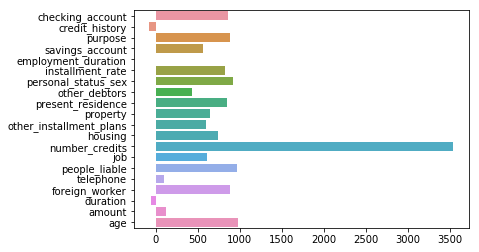

In [418]:
idx = len(R[0]) - 1
ax = sns.barplot(y=input_features,x=list(R[0][idx]))

In [419]:
bal_df.iloc[idx]

checking_account                                  0<= ... < 200 DM
credit_history             all credits at this bank paid back duly
purpose                                                     others
savings_account                         unknown/no savings account
employment_duration                               1 <= ... < 4 yrs
installment_rate                                             >= 35
personal_status_sex                         male : married/widowed
other_debtors                                                 none
present_residence                                           < 1 yr
property                                     unknown / no property
other_installment_plans                                       none
housing                                                       rent
number_credits                                                 4-5
job                            unemployed/unskilled - non-resident
people_liable                                            3 or 

In [420]:
proc_df.iloc[idx]

checking_account              2
credit_history                0
purpose                       5
savings_account               4
employment_duration           0
installment_rate              3
personal_status_sex           3
other_debtors                 2
present_residence             2
property                      3
other_installment_plans       1
housing                       2
number_credits                2
job                           2
people_liable                 1
telephone                     0
foreign_worker                1
duration                      6
amount                     1299
age                          74
credit_risk                   0
Name: 2616, dtype: int64

In [421]:
plot_dnn_feature_importance(R[0][idx],' Features Affecting credit risk Classification ',input_features)

Feature 0: checking_account, Score: 856.41956
Feature 1: credit_history, Score: -79.62718
Feature 2: purpose, Score: 881.34485
Feature 3: savings_account, Score: 564.01477
Feature 4: employment_duration, Score: 1.44119
Feature 5: installment_rate, Score: 818.84509
Feature 6: personal_status_sex, Score: 920.66174
Feature 7: other_debtors, Score: 433.65222
Feature 8: present_residence, Score: 850.45093
Feature 9: property, Score: 647.14252
Feature 10: other_installment_plans, Score: 599.29895
Feature 11: housing, Score: 742.18811
Feature 12: number_credits, Score: 3536.60107
Feature 13: job, Score: 606.74677
Feature 14: people_liable, Score: 965.87158
Feature 15: telephone, Score: 103.66777
Feature 16: foreign_worker, Score: 884.11121
Feature 17: duration, Score: -54.90811
Feature 18: amount, Score: 121.07803
Feature 19: age, Score: 979.19989


In [422]:
T_dnn[:,None]==np.arange(2)

array([[False,  True],
       [False,  True],
       [False,  True],
       ...,
       [ True, False],
       [ True, False],
       [ True, False]])

3. Production monitoring/explainations using XAI¶

In [ ]:
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from alibi.explainers import AnchorTabular
from alibi.explainers import CEM

Explainer pattern - using Anchors

In [ ]:
ordinal_transformer = Pipeline(steps=[('scaler', scaler)])

In [ ]:
categorical_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='constant')),
                                          ('onehot', OneHotEncoder(handle_unknown='ignore'))])

In [ ]:
#proc_df.info()
#ordinal_cols = ['Age','Credit amount','Duration']
#categorical_cols  = ['Sex', 'Job' ,'Housing' ,'Saving accounts','Checking account','Purpose']

In [ ]:
preprocessor = ColumnTransformer(transformers=[('num', ordinal_transformer, ordinal_cols),
                                               ('cat', categorical_transformer, categorical_cols)])
preprocessor.fit(proc_df)

In [ ]:
#RF.fit(x_train,y_train)

In [ ]:
#GNB.fit(x_train,y_train)

In [ ]:
#RF_predict_fn = lambda x: RF.predict(x)
#GNB_predict_fn = lambda x: GNB.predict(x)

In [ ]:
RF_explainer = AnchorTabular(predict_fn_LR, x.columns,seed=seed)
GNB_explainer = AnchorTabular(predict_fn_GNB, x.columns,seed=seed)
xGB_explainer = AnchorTabular(predict_fn_xGB, x.columns,seed=seed)
KNN_explainer = AnchorTabular(predict_fn_KNN, x.columns,seed=seed)
LDA_explainer = AnchorTabular(predict_fn_LDA, x.columns,seed=seed)
SVM_explainer = AnchorTabular(predict_fn_SVM, x.columns,seed=seed)
CART_explainer = AnchorTabular(predict_fn_CART, x.columns,seed=seed)
LR_explainer = AnchorTabular(predict_fn_LR, x.columns,seed=seed)

In [ ]:
RF_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
GNB_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
xGB_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
KNN_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
LDA_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
SVM_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
CART_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

In [ ]:
LR_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

Explainations

In [ ]:
cols_list_ordered = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker','duration','amount','age']

In [ ]:
def get_encoded_input_list(value,col):
    myList = []
    for i in range(0,len(cols_list_ordered)):
        if cols_list_ordered[i] == col :
            myList.append(float(value))
        else:
            myList.append(0)
    return myList

In [ ]:
#get_encoded_input_list(8,'checking_account')

In [ ]:
import re
def reconstruct_values(a):
    numeric_regex = ''
    attribute = ''
    value = ''
    comparator = ''
            
    #extract value
    value = re.findall(r"[-+]?\d*\.*\d+", a)
        
    #match comparator
    if '=' in a:
        comparator = ' = '
    if '<' in a:
        comparator = ' < '
    if '>' in a:
        comparator = ' > '
    if '<=' in a:
        comparator = ' <= '
    if '>=' in a:
        comparator = ' >= '
    
    #match attribute
    if 'job' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'job')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_job.inverse_transform(value['job'])
        value = value[0]
        attribute = 'job'
        comparator = ' = '
    if 'housing' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'housing')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_housing.inverse_transform(value['housing'])
        value = value[0]
        attribute = 'housing'
        comparator = ' = '
    if 'age' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'age')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['age'][0]
        attribute = 'age'
    if 'personal_status_sex' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'personal_status_sex')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_personal_status_sex.inverse_transform(value['personal_status_sex'])
        value = value[0]
        attribute = 'personal_status_sex'
        comparator = ' = '
    if 'savings_account' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'savings_account')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_savings_account.inverse_transform(value['savings_account'])  
        value = value[0]
        attribute = 'saving_account'
        comparator = ' = '
    if 'checking_account' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'checking_account')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_checking_account.inverse_transform(value['checking_account']) 
        value = value[0]
        attribute = 'checking_account'
        comparator = ' = '
    if 'amount' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'amount')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['amount'][0]
        attribute = 'amount'
    if 'duration' in a:
        value = value[0]                             
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'duration')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['duration'][0]
        attribute = 'duration'
    if 'purpose' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'purpose')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_purpose.inverse_transform(value['purpose'])
        value = value[0]
        attribute = 'purpose'
        comparator = ' = '
    if 'people_liable' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'people_liable')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_people_liable.inverse_transform(value['people_liable'])
        value = value[0]
        attribute = 'people_liable'
        comparator = ' = '
    if 'employment_duration' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'employment_duration')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_employment_duration.inverse_transform(value['employment_duration'])
        value = value[0]
        attribute = 'employment_duration'
        comparator = ' = '
    if 'property' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'property')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_property.inverse_transform(value['property'])
        value = value[0]
        attribute = 'property'
        comparator = ' = '
    if 'present_residence' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'present_residence')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_present_residence.inverse_transform(value['present_residence'])
        value = value[0]
        attribute = 'present_residence'
        comparator = ' = '
    if 'other_debtors' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'other_debtors')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_other_debtors.inverse_transform(value['other_debtors'])
        value = value[0]
        attribute = 'other_debtors'
        comparator = ' = '
    if 'other_installment_plans' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'other_installment_plans')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_other_installment_plans.inverse_transform(value['other_installment_plans'])
        value = value[0]
        attribute = 'other_installment_plans'
        comparator = ' = '
    if 'number_credits' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'number_credits')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_number_credits.inverse_transform(value['number_credits'])
        value = value[0]
        attribute = 'number_credits'
        comparator = ' = '
    if 'foreign_worker' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'foreign_worker')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_foreign_worker.inverse_transform(value['foreign_worker'])
        value = value[0]
        attribute = 'foreign_worker'
        comparator = ' = '
    if 'telephone' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'telephone')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_telephone.inverse_transform(value['telephone'])
        value = value[0]
        attribute = 'telephone'
        comparator = ' = '
    if 'installment_rate' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'installment_rate')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_installment_rate.inverse_transform(value['installment_rate'])
        value = value[0]
        attribute = 'installment_rate'
        comparator = ' = '        
    if 'credit_history' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'credit_history')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_credit_history.inverse_transform(value['credit_history'])
        value = value[0]
        attribute = 'credit_history'
        comparator = ' = '           
    #print(attribute + comparator + value)
    return attribute + comparator + str(value)
#people_liable	telephone	foreign_worker number_credits other_installment_plans	other_debtors	present_residence	property employment_duration	installment_rate credit_history 

User Input

In [ ]:
#selecting random test index for Explainations - (simulating production environment)
idx = 100 
x_test[idx:idx+1]
x_df = pd.DataFrame(scaler.inverse_transform(x_test[idx:idx+1].values),columns = cols_list_ordered)
x_df = x_df.astype(int)

x_df['personal_status_sex'] = label_encoder_personal_status_sex.inverse_transform(x_df['personal_status_sex']) 
x_df['job'] = label_encoder_job.inverse_transform(x_df['job']) 
x_df['housing'] = label_encoder_housing.inverse_transform(x_df['housing']) 
x_df['savings_account'] = label_encoder_savings_account.inverse_transform(x_df['savings_account']) 
x_df['checking_account'] = label_encoder_checking_account.inverse_transform(x_df['checking_account']) 
x_df['purpose'] = label_encoder_purpose.inverse_transform(x_df['purpose']) 
x_df['credit_history'] = label_encoder_credit_history.inverse_transform(x_df['credit_history'])
x_df['employment_duration'] = label_encoder_employment_duration.inverse_transform(x_df['employment_duration'])
x_df['installment_rate'] = label_encoder_installment_rate.inverse_transform(x_df['installment_rate'])
x_df['property'] = label_encoder_property.inverse_transform(x_df['property'])
x_df['other_installment_plans'] = label_encoder_other_installment_plans.inverse_transform(x_df['other_installment_plans'])
x_df['number_credits'] = label_encoder_number_credits.inverse_transform(x_df['number_credits'])
x_df['people_liable'] = label_encoder_people_liable.inverse_transform(x_df['people_liable'])
x_df['telephone'] = label_encoder_telephone.inverse_transform(x_df['telephone'])
x_df['foreign_worker'] = label_encoder_foreign_worker.inverse_transform(x_df['foreign_worker'])
x_df['other_debtors'] = label_encoder_other_debtors.inverse_transform(x_df['other_debtors'])
x_df['present_residence'] = label_encoder_present_residence.inverse_transform(x_df['present_residence'])

x_df.head()
# we shall try to explain the predictions by two different models for the below input from user

In [ ]:
x_test[idx:idx+1]

In [ ]:
len(x_train)

In [ ]:
y_test[idx]

Model 1: RF exlaination for the user input

In [ ]:
explanation = RF_explainer.explain(x_test.values[idx], threshold=0.95,use_proba=True, batch_size=30)
print('Risk : {0}'.format('Good' if predict_fn_RF(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

In [ ]:
predict_fn_RF(x_test.values[[idx]])

Model 2: GNB exlaination for the user input  

In [ ]:
explanation = GNB_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_GNB(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 3: xGB exlaination for the user input

In [ ]:
explanation = xGB_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_xGB(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 4: KNN exlaination for the user input

In [ ]:
explanation = KNN_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_KNN(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 5: LDA exlaination for the user input

In [ ]:
explanation = LDA_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_LDA(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 6: SVM exlaination for the user input

In [ ]:
explanation = SVM_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_SVM(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 7: CART exlaination for the user input

In [ ]:
explanation = CART_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_CART(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Model 8: LR with PCA exlaination for the user input

In [ ]:
explanation = LR_explainer.explain(x_test.values[idx], threshold=0.95)
print('Risk : {0}'.format('Good' if predict_fn_LR(x_test.values[[idx]]) == 0 else 'Bad'))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

---END---
Utilities

In [ ]:
#explanation['anchor']

In [ ]:
#[reconstruct_values(expltn) for expltn in explanation['anchor']]

In [ ]:
bal_df.head()

In [ ]:
#from sklearn import preprocessing
## label_encoder object knows how to understand word labels. 
#label_encoder_sex = preprocessing.LabelEncoder()
#label_encoder_job = preprocessing.LabelEncoder()
#label_encoder_housing = preprocessing.LabelEncoder()
#label_encoder_saving = preprocessing.LabelEncoder()
#label_encoder_checking = preprocessing.LabelEncoder()
#label_encoder_purpose = preprocessing.LabelEncoder()
#label_encoder_risk = preprocessing.LabelEncoder()
## Encode labels in column . 
#proc1_df = bal_df.copy(deep=True)
#proc1_df['Sex'] = label_encoder_sex.fit_transform(proc1_df['Sex']) 
#proc1_df['Job'] = label_encoder_job.fit_transform(proc1_df['Job']) 
#proc1_df['Housing'] = label_encoder_housing.fit_transform(proc1_df['Housing']) 
#proc1_df['Saving accounts'] = label_encoder_saving.fit_transform(proc1_df['Saving accounts']) 
#proc1_df['Checking account'] =label_encoder_checking.fit_transform(proc1_df['Checking account']) 
#proc1_df['Purpose'] = label_encoder_purpose.fit_transform(proc1_df['Purpose']) 
#proc1_df['Risk'] = label_encoder_risk.fit_transform(proc1_df['Risk']) 
#proc1_df.head()

In [ ]:
#from sklearn.preprocessing import StandardScaler
#
#del proc1_df['Job_lvl']
#del proc1_df['Age_cat']
#del proc1_df['credit_cat']
#
#scaler = StandardScaler()
#scaler.fit(proc1_df)
#proc1_df = pd.DataFrame(scaler.transform(proc1_df),columns = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Risk'])
#proc1_df.head()

In [ ]:
#proc1_df = pd.DataFrame(scaler.inverse_transform(proc1_df.values),columns = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Risk'])
#proc1_df = proc1_df.astype(int)
#proc1_df.head()

In [ ]:
##proc1_df = label_encoder.inverse_transform(proc1_df)
#proc1_df['Sex'] = label_encoder_sex.inverse_transform(proc1_df['Sex']) 
#proc1_df['Job'] = label_encoder_job.inverse_transform(proc1_df['Job']) 
#proc1_df['Housing'] = label_encoder_housing.inverse_transform(proc1_df['Housing']) 
#proc1_df['Saving accounts'] = label_encoder_saving.inverse_transform(proc1_df['Saving accounts']) 
#proc1_df['Checking account'] = label_encoder_checking.inverse_transform(proc1_df['Checking account']) 
#proc1_df['Purpose'] = label_encoder_purpose.inverse_transform(proc1_df['Purpose']) 
#proc1_df['Risk'] = label_encoder_risk.inverse_transform(proc1_df['Risk']) 
#proc1_df.head()

In [ ]:
bal_df.head()